### In dit notebook wordt er gefinetuned op het ZeroDCE++ model. De meeste logica is afkomstig van de repo waar dit model vandaan komt https://github.com/Thehunk1206/Zero-DCE

#### Setup nieuw model

In [ ]:
from ZeroDCE.zero_dce_lite import ZeroDCE_lite 
model = ZeroDCE_lite(iteration=8)  # zorg dat dit matcht met het oorspronkelijke model

model.load_weights("Trained_model/zero_dce_lite_iter8/zero_dce_lite_200x300_iter8_60")

for layer in model.layers:
    layer.trainable = True

#### Setup specifieke epoch na finetunen

In [ ]:
from ZeroDCE.zero_dce_lite import ZeroDCE_lite
model = ZeroDCE_lite(iteration=8)
model.load_weights("finetuned_models/zero_dce_finetune1007/best")

#### Weights opslaan

In [6]:
model.save_weights("zero_dce_finetune.h5")

#### Model architectuur weergeven, om te achterhalen wat de input size is. Voor onduideljke redenen is het een rechthoekige vorm ipv vierkant bij deze specifieke repo.

In [109]:
print(model.summary())

Model: "DCE-net_lite"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 384, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 separable_conv2d_14 (Separable  (None, 384, 512, 32  155        ['input_3[0][0]']                
 Conv2D)                        )                                                                 
                                                                                                  
 separable_conv2d_15 (Separable  (None, 384, 512, 32  1344       ['separable_conv2d_14[0][0]']    
 Conv2D)                        )                                                      

#### Voorspellen op gefinetunede modelen, om een dataset te creëren.

In [102]:
import tensorflow as tf
import os

def preprocess_image(img_path, img_h=512, img_w=384):
    image = tf.io.read_file(img_path)
    image = tf.image.decode_image(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)  # [0,1]
    image = tf.image.resize(image, [img_h, img_w])
    image = tf.expand_dims(image, axis=0)  # batch dim toevoegen
    return image


import os
import tensorflow as tf

input_root = '../data-filtered-rooms'
output_root = '../data-zero-dce-finetuned-50-diffbatch'

# Zorg dat output_root bestaat
os.makedirs(output_root, exist_ok=True)

for room_name in os.listdir(input_root):
    input_folder = os.path.join(input_root, room_name)
    output_folder = os.path.join(output_root, room_name)

    # Alleen directories verwerken
    if not os.path.isdir(input_folder):
        continue

    os.makedirs(output_folder, exist_ok=True)

    for filename in os.listdir(input_folder):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            img_path = os.path.join(input_folder, filename)
            input_tensor = preprocess_image(img_path)

            # Voorspelling
            output_tensor = model(input_tensor, training=False)

            if isinstance(output_tensor, (list, tuple)):
                enhanced_image = output_tensor[0]
            else:
                enhanced_image = output_tensor

            # Post-processing
            output_image = tf.squeeze(enhanced_image, axis=0)
            output_image = tf.clip_by_value(output_image, 0.0, 1.0)
            output_image = tf.image.convert_image_dtype(output_image, tf.uint8)

            output_path = os.path.join(output_folder, filename)
            encoded_image = tf.image.encode_png(output_image)
            tf.io.write_file(output_path, encoded_image)

            abs_path = os.path.abspath(output_path)
            print(f"Verwerkt: {room_name}/{filename} -> opgeslagen als {abs_path}")

            if os.path.exists(abs_path):
                print("Bestand succesvol opgeslagen!")
            else:
                print("Bestand NIET gevonden na opslaan!")


Verwerkt: room1/15_not_laying.jpg -> opgeslagen als c:\Users\milan\Documents\MAAI\Afstuderen\Alderli\data-zero-dce-finetuned-50-diffbatch\room1\15_not_laying.jpg
Bestand succesvol opgeslagen!
Verwerkt: room1/16_not_laying.jpg -> opgeslagen als c:\Users\milan\Documents\MAAI\Afstuderen\Alderli\data-zero-dce-finetuned-50-diffbatch\room1\16_not_laying.jpg
Bestand succesvol opgeslagen!
Verwerkt: room1/18_not_laying.jpg -> opgeslagen als c:\Users\milan\Documents\MAAI\Afstuderen\Alderli\data-zero-dce-finetuned-50-diffbatch\room1\18_not_laying.jpg
Bestand succesvol opgeslagen!
Verwerkt: room1/28_not_laying.jpg -> opgeslagen als c:\Users\milan\Documents\MAAI\Afstuderen\Alderli\data-zero-dce-finetuned-50-diffbatch\room1\28_not_laying.jpg
Bestand succesvol opgeslagen!
Verwerkt: room1/30_not_laying.jpg -> opgeslagen als c:\Users\milan\Documents\MAAI\Afstuderen\Alderli\data-zero-dce-finetuned-50-diffbatch\room1\30_not_laying.jpg
Bestand succesvol opgeslagen!
Verwerkt: room1/39_not_laying.jpg -> opg

#### Custom losses aanmaken en model compileren

In [106]:
import tensorflow as tf
from ZeroDCE.losses import SpatialConsistencyLoss, \
                            ExposureControlLoss,   \
                            ColorConstancyLosss,   \
                            IlluminationSmoothnessLoss

spatial_consistency_loss = SpatialConsistencyLoss()
exposure_control_loss = ExposureControlLoss(e=0.6, patch_size=16)
color_constancy_loss = ColorConstancyLosss()
illumination_smoothness_loss = IlluminationSmoothnessLoss()
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=1e-5)

model.compile(
        optimizer=optimizer,
        spatial_consistency_loss=spatial_consistency_loss,
        exposure_control_loss=exposure_control_loss,
        color_constancy_loss=color_constancy_loss,
        illumination_smoothness_loss=illumination_smoothness_loss
    )

#### Data batches genereren

In [90]:
import os
import glob
import tensorflow as tf

# Parameters
IMG_H = 384
IMG_W = 512
IMG_C = 3
BATCH_SIZE = 8

def collect_all_images_recursively(folder_path: str) -> list:
    '''
    Recursively collects all image file paths from the given folder.
    '''
    image_extensions = ["*.png", "*.jpg", "*.jpeg"]
    image_paths = []
    for ext in image_extensions:
        image_paths.extend(glob.glob(os.path.join(folder_path, '**', ext), recursive=True))
    return sorted(image_paths)

def read_image(image_path: tf.Tensor) -> tf.Tensor:
    '''
    Read and process a single image file.
    '''
    img_raw = tf.io.read_file(image_path)
    image = tf.image.decode_image(img_raw, channels=IMG_C, expand_animations=False)
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, size=[IMG_H, IMG_W], method=tf.image.ResizeMethod.BICUBIC)
    image = (image - tf.reduce_min(image)) / (tf.reduce_max(image) - tf.reduce_min(image) + 1e-8)
    return image

def create_dataset(folder_path: str) -> tf.data.Dataset:
    '''
    Creates a tf.data.Dataset from a folder (recursively).
    '''
    image_paths = collect_all_images_recursively(folder_path)
    image_paths_ds = tf.data.Dataset.from_tensor_slices(image_paths)
    dataset = image_paths_ds.map(read_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    dataset = dataset.cache()
    dataset = dataset.shuffle(buffer_size=200).batch(BATCH_SIZE)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
    return dataset

train_data = create_dataset("../datasets/train")
test_data = create_dataset("../datasets/test")
val_data = create_dataset("../datasets/val")

for batch in train_data.take(1):
    print("Batch shape:", batch.shape)

Batch shape: (8, 384, 512, 3)


#### Trainen, en logica voor het bijhouden van de losses, om deze later te visualiseren

Training the model...



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.07s/steps]



Epoch: 1
ETA: 3.96 min
Train Loss: 1.3661731481552124
  Spatial Consistency Loss: 0.2504236102104187
  Exposure Control Loss: 0.7034543752670288
  Color Constancy Loss: 0.225455179810524
  Illumination Smoothness Loss: 0.1868399828672409
Validation Loss: 1.7167866230010986
  Spatial Consistency Loss: 0.24236328899860382
  Exposure Control Loss: 1.2303509712219238
  Color Constancy Loss: 0.14793580770492554
  Illumination Smoothness Loss: 0.09613654017448425



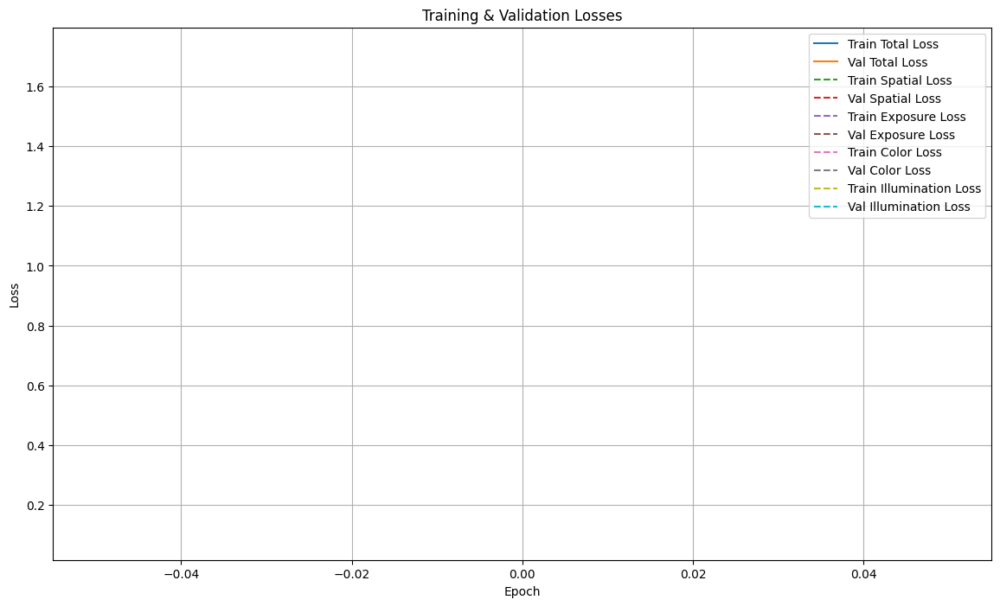

Saving model at epoch 1 to finetuned_models/zero_dce_finetune1007/epoch0...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch0\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch0\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.03steps/s]



Epoch: 2
ETA: 3.72 min
Train Loss: 1.8534772396087646
  Spatial Consistency Loss: 0.17445062100887299
  Exposure Control Loss: 0.9262204170227051
  Color Constancy Loss: 0.6287458539009094
  Illumination Smoothness Loss: 0.12406036257743835
Validation Loss: 0.7625254392623901
  Spatial Consistency Loss: 0.22468620538711548
  Exposure Control Loss: 0.22363142669200897
  Color Constancy Loss: 0.18646599352359772
  Illumination Smoothness Loss: 0.12774181365966797



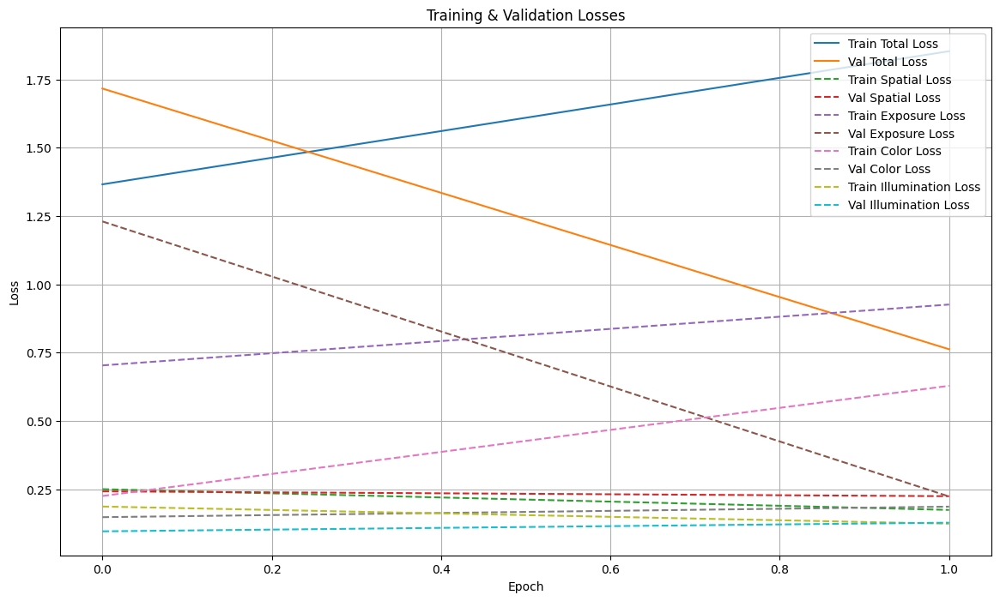

Saving model at epoch 2 to finetuned_models/zero_dce_finetune1007/epoch1...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch1\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch1\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 3
ETA: 3.71 min
Train Loss: 2.2784523963928223
  Spatial Consistency Loss: 0.14608065783977509
  Exposure Control Loss: 1.1750967502593994
  Color Constancy Loss: 0.8308295011520386
  Illumination Smoothness Loss: 0.12644553184509277
Validation Loss: 1.0062289237976074
  Spatial Consistency Loss: 0.2695465683937073
  Exposure Control Loss: 0.25183582305908203
  Color Constancy Loss: 0.3784724771976471
  Illumination Smoothness Loss: 0.10637403279542923



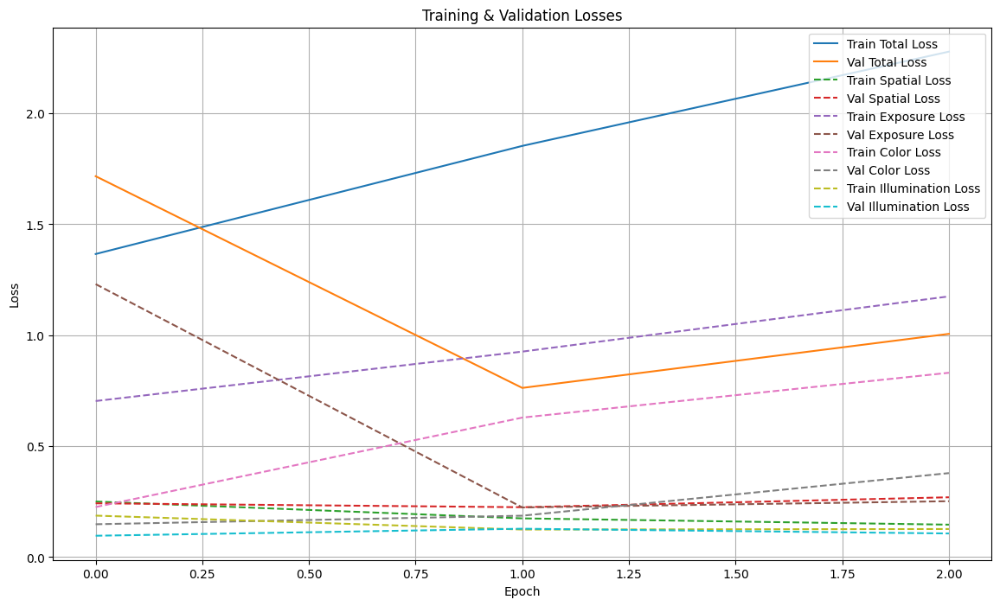

Saving model at epoch 3 to finetuned_models/zero_dce_finetune1007/epoch2...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch2\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch2\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]


Epoch: 4
ETA: 3.86 min
Train Loss: 1.53435218334198
  Spatial Consistency Loss: 0.21604286134243011
  Exposure Control Loss: 1.0771164894104004
  Color Constancy Loss: 0.11097238957881927
  Illumination Smoothness Loss: 0.1302204430103302
Validation Loss: 1.6112066507339478
  Spatial Consistency Loss: 0.19278936088085175
  Exposure Control Loss: 0.8452403545379639
  Color Constancy Loss: 0.5023425221443176
  Illumination Smoothness Loss: 0.07083456963300705



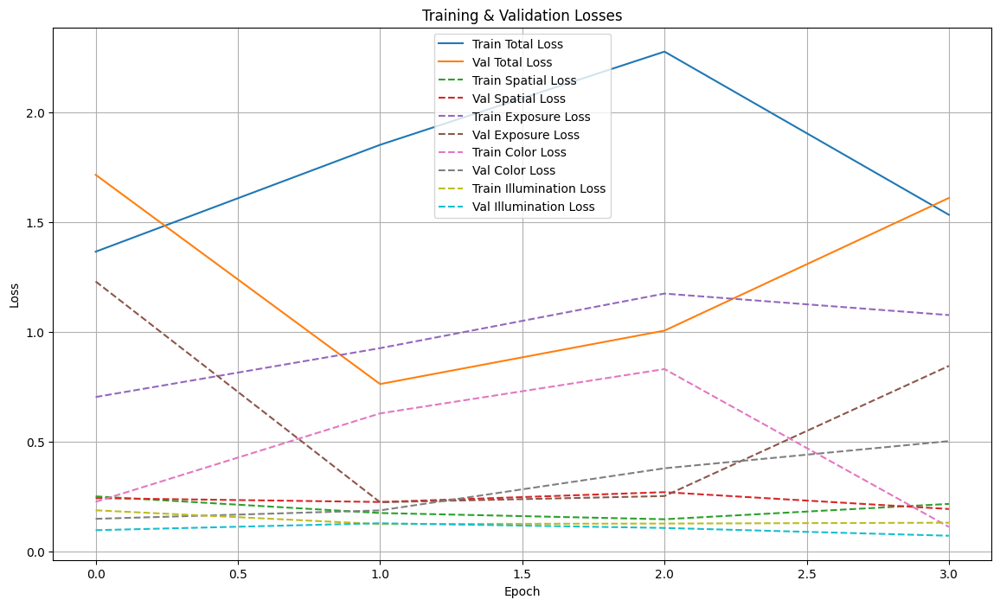

Saving model at epoch 4 to finetuned_models/zero_dce_finetune1007/epoch3...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch3\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch3\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 5
ETA: 3.86 min
Train Loss: 2.2990047931671143
  Spatial Consistency Loss: 0.1326328068971634
  Exposure Control Loss: 1.2567126750946045
  Color Constancy Loss: 0.7921502590179443
  Illumination Smoothness Loss: 0.11750910431146622
Validation Loss: 0.6903128027915955
  Spatial Consistency Loss: 0.19359935820102692
  Exposure Control Loss: 0.3020157516002655
  Color Constancy Loss: 0.09923091530799866
  Illumination Smoothness Loss: 0.09546681493520737



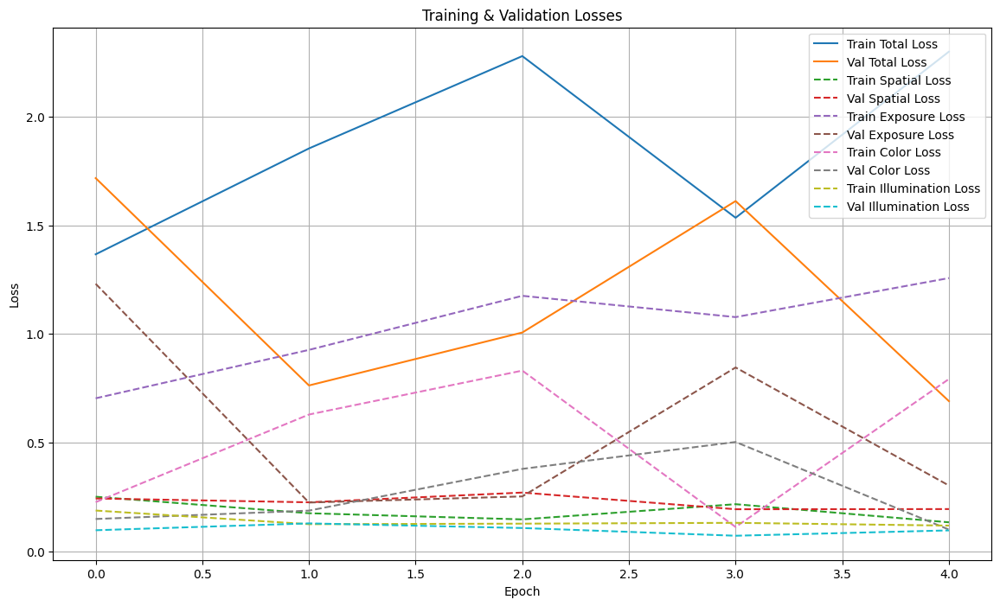

Saving model at epoch 5 to finetuned_models/zero_dce_finetune1007/epoch4...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch4\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch4\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 6
ETA: 3.79 min
Train Loss: 2.2259674072265625
  Spatial Consistency Loss: 0.17459246516227722
  Exposure Control Loss: 0.44927191734313965
  Color Constancy Loss: 1.4439404010772705
  Illumination Smoothness Loss: 0.1581626981496811
Validation Loss: 1.0125542879104614
  Spatial Consistency Loss: 0.1938265711069107
  Exposure Control Loss: 0.694779098033905
  Color Constancy Loss: 0.014320234768092632
  Illumination Smoothness Loss: 0.10962840169668198



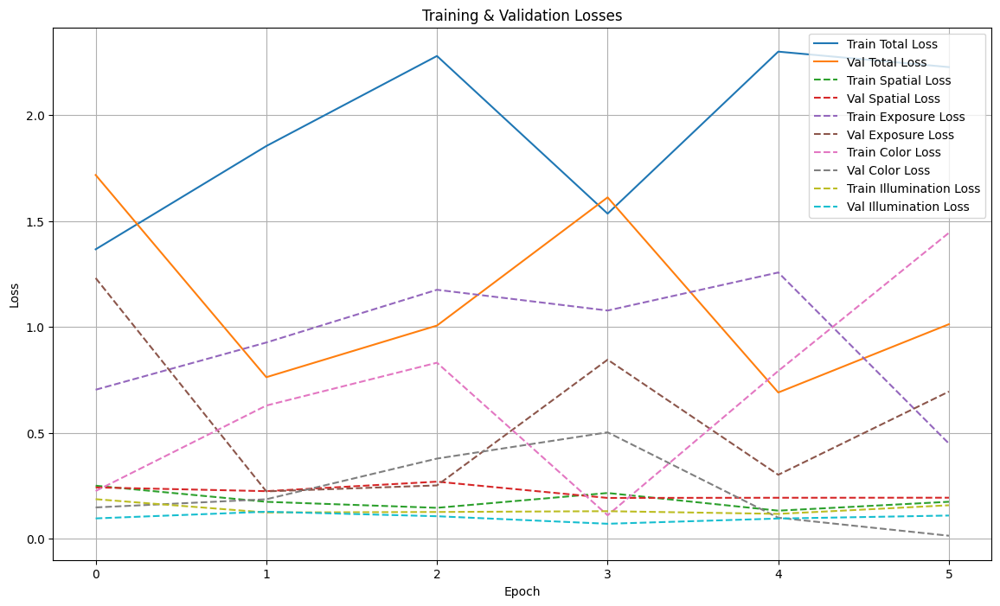

Saving model at epoch 6 to finetuned_models/zero_dce_finetune1007/epoch5...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch5\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch5\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 7
ETA: 3.8 min
Train Loss: 2.388981819152832
  Spatial Consistency Loss: 0.16352319717407227
  Exposure Control Loss: 0.43189737200737
  Color Constancy Loss: 1.6022179126739502
  Illumination Smoothness Loss: 0.1913432478904724
Validation Loss: 0.7362069487571716
  Spatial Consistency Loss: 0.25103726983070374
  Exposure Control Loss: 0.18165674805641174
  Color Constancy Loss: 0.21801935136318207
  Illumination Smoothness Loss: 0.08549357950687408



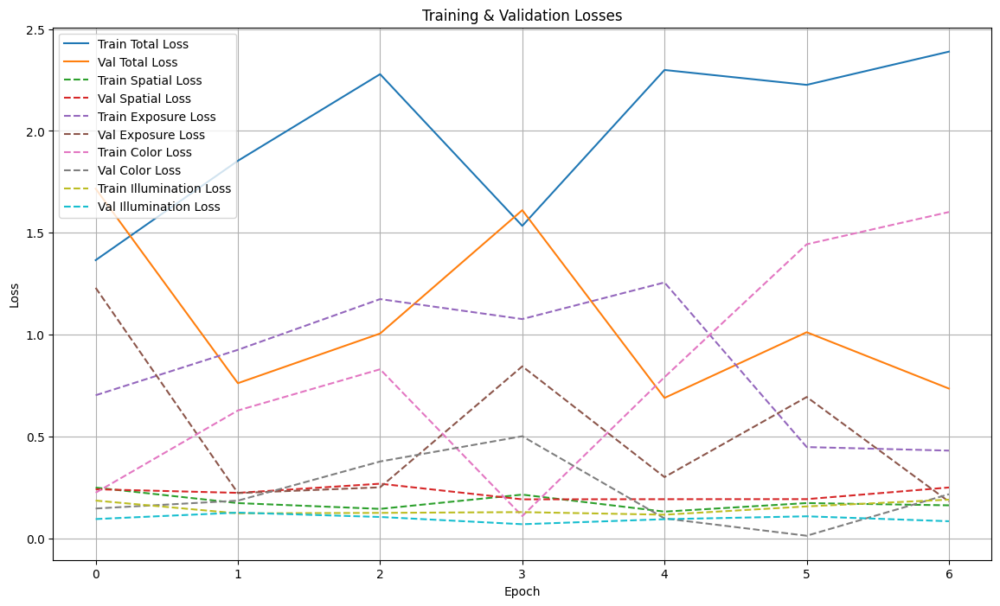

Saving model at epoch 7 to finetuned_models/zero_dce_finetune1007/epoch6...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch6\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch6\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 8
ETA: 3.77 min
Train Loss: 1.032508134841919
  Spatial Consistency Loss: 0.24655024707317352
  Exposure Control Loss: 0.661529541015625
  Color Constancy Loss: 0.055321287363767624
  Illumination Smoothness Loss: 0.0691070482134819
Validation Loss: 0.6887293457984924
  Spatial Consistency Loss: 0.17731215059757233
  Exposure Control Loss: 0.3664095401763916
  Color Constancy Loss: 0.05928138270974159
  Illumination Smoothness Loss: 0.08572624623775482



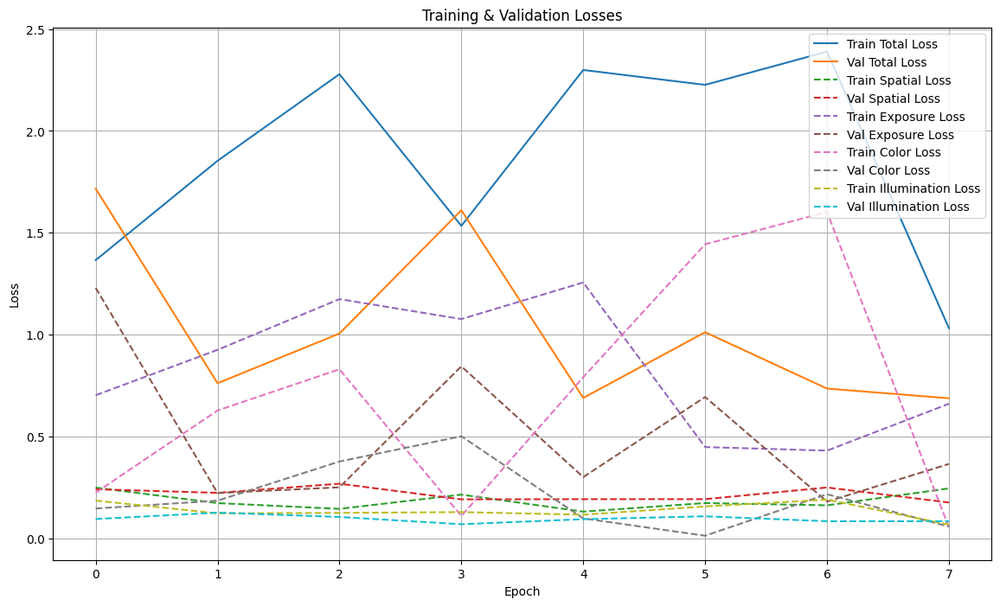

Saving model at epoch 8 to finetuned_models/zero_dce_finetune1007/epoch7...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch7\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch7\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 9
ETA: 3.94 min
Train Loss: 1.4677257537841797
  Spatial Consistency Loss: 0.1792897880077362
  Exposure Control Loss: 0.8339195847511292
  Color Constancy Loss: 0.35696494579315186
  Illumination Smoothness Loss: 0.09755142778158188
Validation Loss: 1.3608081340789795
  Spatial Consistency Loss: 0.19301632046699524
  Exposure Control Loss: 1.0208251476287842
  Color Constancy Loss: 0.06585424393415451
  Illumination Smoothness Loss: 0.08111244440078735



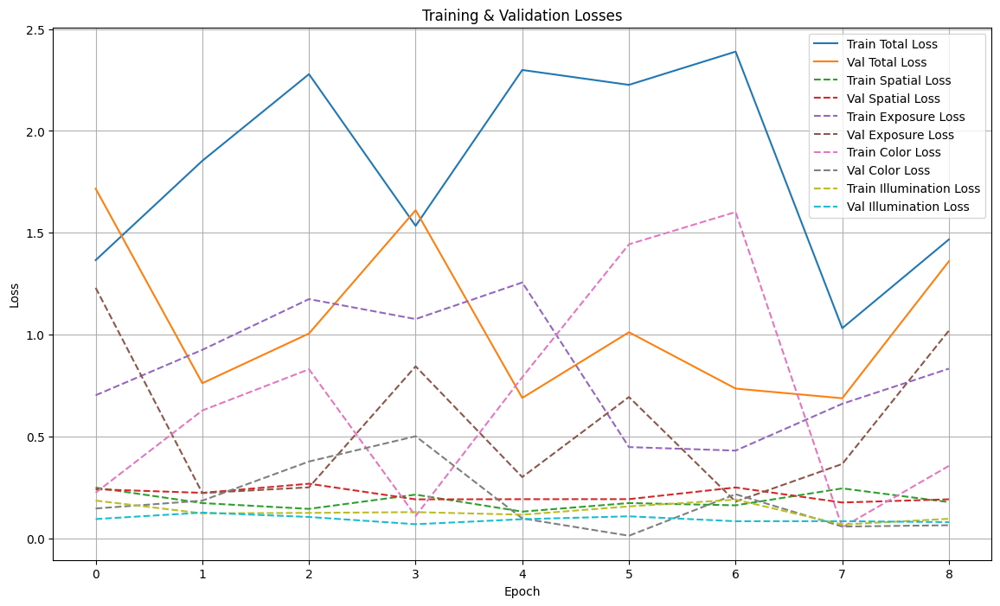

Saving model at epoch 9 to finetuned_models/zero_dce_finetune1007/epoch8...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch8\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch8\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 10
ETA: 3.72 min
Train Loss: 1.7480829954147339
  Spatial Consistency Loss: 0.1353788524866104
  Exposure Control Loss: 1.1086863279342651
  Color Constancy Loss: 0.41331973671913147
  Illumination Smoothness Loss: 0.09069817513227463
Validation Loss: 0.9593215584754944
  Spatial Consistency Loss: 0.1862901747226715
  Exposure Control Loss: 0.660962700843811
  Color Constancy Loss: 0.004150049295276403
  Illumination Smoothness Loss: 0.10791870206594467



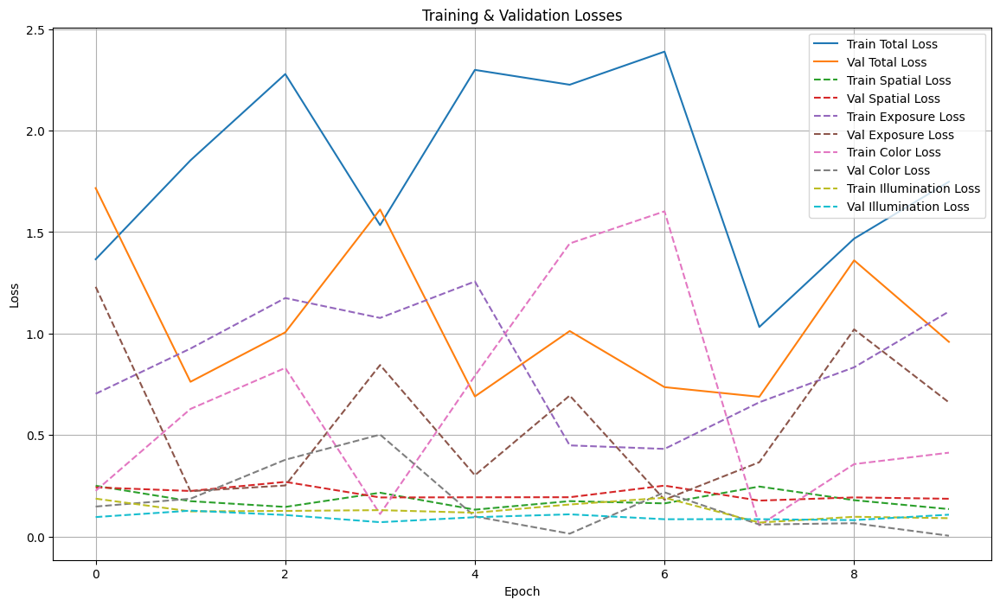

Saving model at epoch 10 to finetuned_models/zero_dce_finetune1007/epoch9...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch9\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch9\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 11
ETA: 3.87 min
Train Loss: 1.3882720470428467
  Spatial Consistency Loss: 0.20587652921676636
  Exposure Control Loss: 0.7411799430847168
  Color Constancy Loss: 0.34781432151794434
  Illumination Smoothness Loss: 0.09340120106935501
Validation Loss: 0.6851676106452942
  Spatial Consistency Loss: 0.16991765797138214
  Exposure Control Loss: 0.39727288484573364
  Color Constancy Loss: 0.04265314340591431
  Illumination Smoothness Loss: 0.07532396167516708



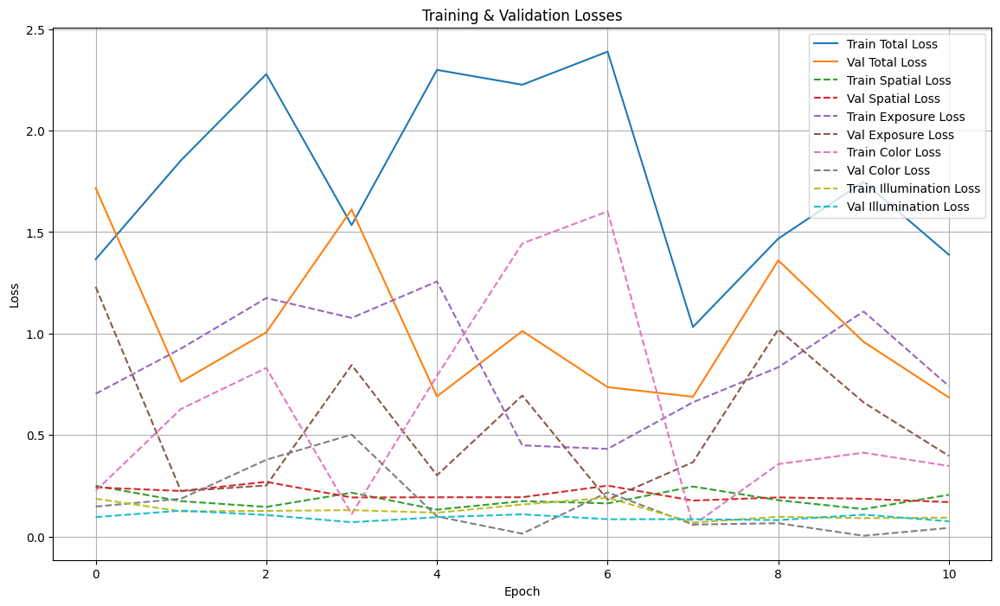

Saving model at epoch 11 to finetuned_models/zero_dce_finetune1007/epoch10...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch10\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch10\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 12
ETA: 3.8 min
Train Loss: 5.73016357421875
  Spatial Consistency Loss: 0.046073295176029205
  Exposure Control Loss: 2.09335994720459
  Color Constancy Loss: 3.3054628372192383
  Illumination Smoothness Loss: 0.28526806831359863
Validation Loss: 0.9857721328735352
  Spatial Consistency Loss: 0.17791111767292023
  Exposure Control Loss: 0.5804969072341919
  Color Constancy Loss: 0.14786137640476227
  Illumination Smoothness Loss: 0.07950276136398315



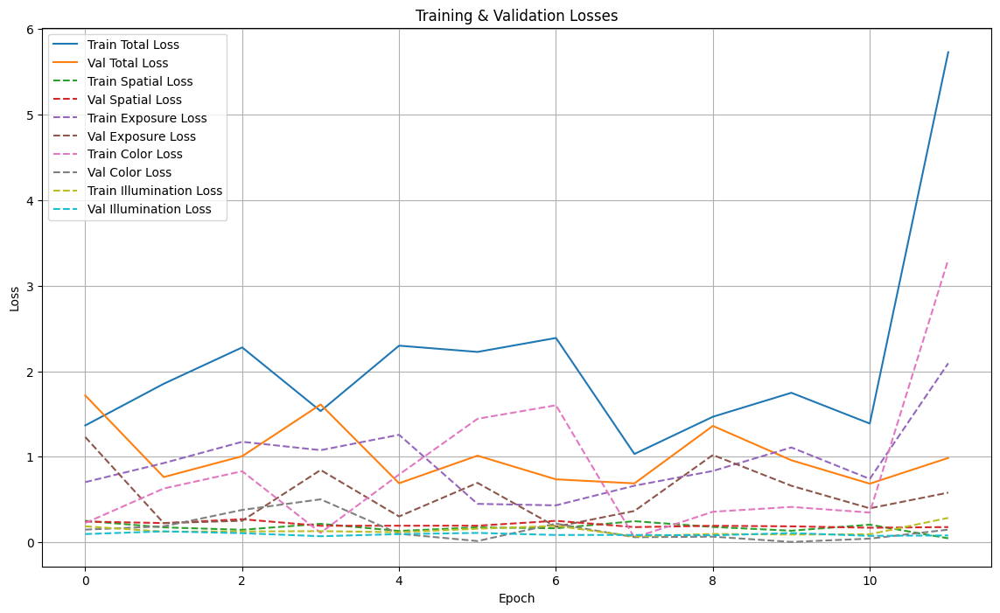

Saving model at epoch 12 to finetuned_models/zero_dce_finetune1007/epoch11...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch11\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch11\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 13
ETA: 3.78 min
Train Loss: 0.8768066763877869
  Spatial Consistency Loss: 0.17641900479793549
  Exposure Control Loss: 0.39095553755760193
  Color Constancy Loss: 0.2104230374097824
  Illumination Smoothness Loss: 0.09900911152362823
Validation Loss: 1.1253433227539062
  Spatial Consistency Loss: 0.21103835105895996
  Exposure Control Loss: 0.5577378273010254
  Color Constancy Loss: 0.2684929072856903
  Illumination Smoothness Loss: 0.08807426691055298



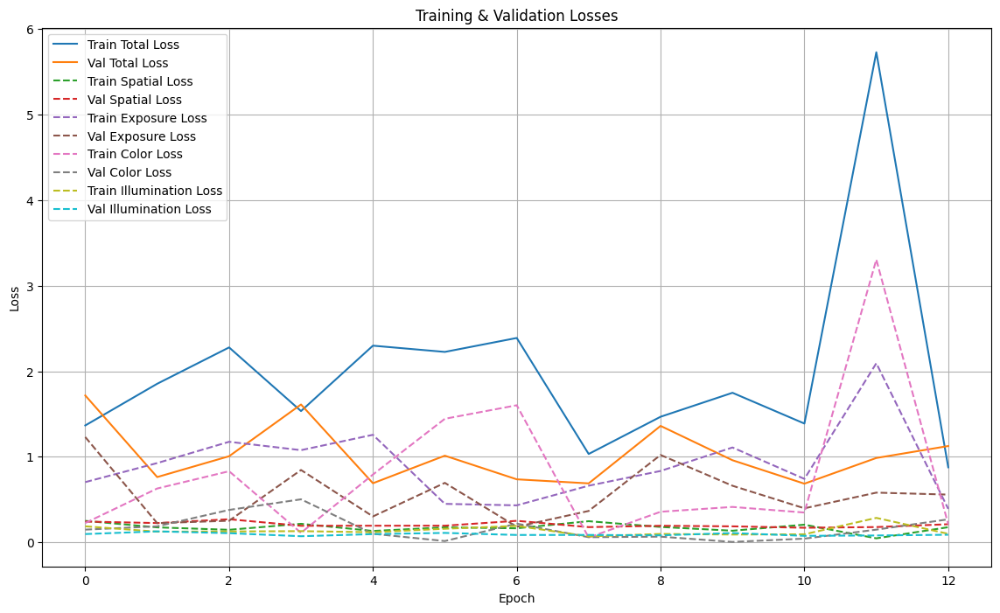

Saving model at epoch 13 to finetuned_models/zero_dce_finetune1007/epoch12...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch12\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch12\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 14
ETA: 3.78 min
Train Loss: 1.2374345064163208
  Spatial Consistency Loss: 0.18282347917556763
  Exposure Control Loss: 0.6654384732246399
  Color Constancy Loss: 0.24158287048339844
  Illumination Smoothness Loss: 0.14758965373039246
Validation Loss: 0.6707310676574707
  Spatial Consistency Loss: 0.1665036678314209
  Exposure Control Loss: 0.4092389643192291
  Color Constancy Loss: 0.02810993790626526
  Illumination Smoothness Loss: 0.066878542304039



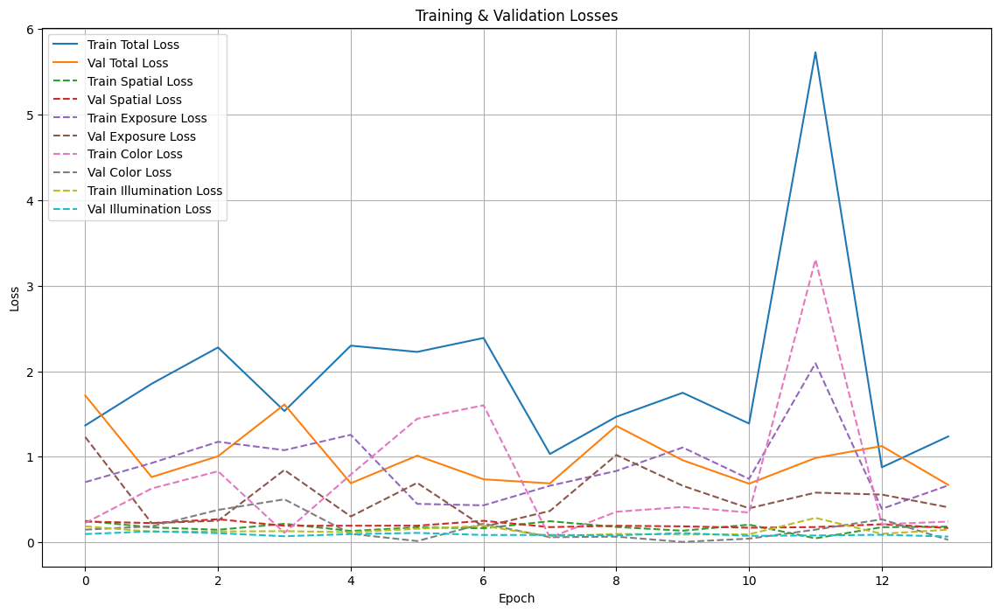

Saving model at epoch 14 to finetuned_models/zero_dce_finetune1007/epoch13...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch13\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch13\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 15
ETA: 3.76 min
Train Loss: 0.8534187078475952
  Spatial Consistency Loss: 0.23835942149162292
  Exposure Control Loss: 0.5332611799240112
  Color Constancy Loss: 0.028090626001358032
  Illumination Smoothness Loss: 0.05370745807886124
Validation Loss: 1.5466933250427246
  Spatial Consistency Loss: 0.18477605283260345
  Exposure Control Loss: 1.2649582624435425
  Color Constancy Loss: 0.02110305242240429
  Illumination Smoothness Loss: 0.07585595548152924



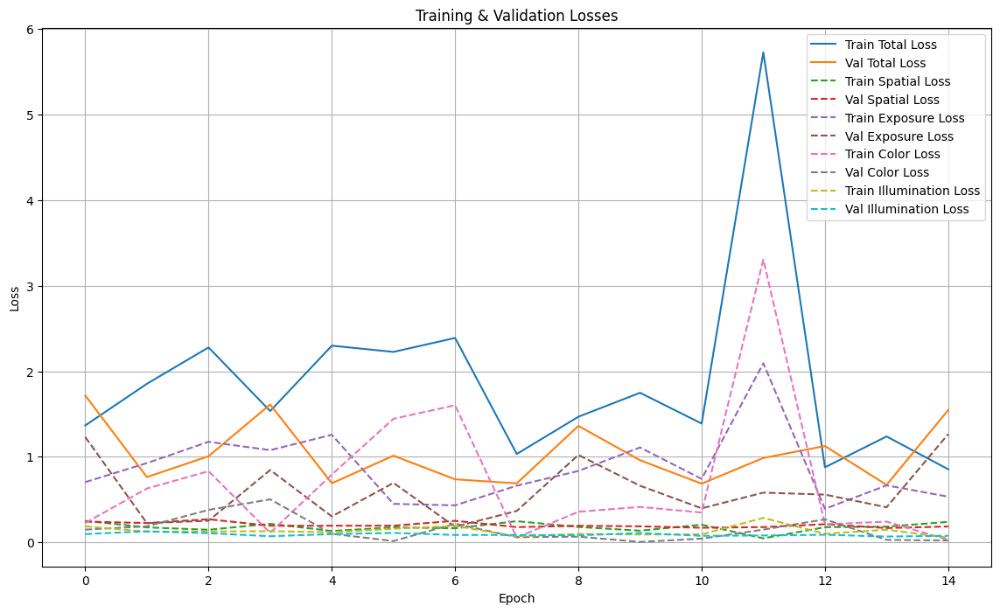

Saving model at epoch 15 to finetuned_models/zero_dce_finetune1007/epoch14...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch14\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch14\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 16
ETA: 3.78 min
Train Loss: 1.6325912475585938
  Spatial Consistency Loss: 0.13235591351985931
  Exposure Control Loss: 1.1052706241607666
  Color Constancy Loss: 0.3225276470184326
  Illumination Smoothness Loss: 0.07243707776069641
Validation Loss: 0.8960779905319214
  Spatial Consistency Loss: 0.20841367542743683
  Exposure Control Loss: 0.5473499298095703
  Color Constancy Loss: 0.056794192641973495
  Illumination Smoothness Loss: 0.08352021127939224



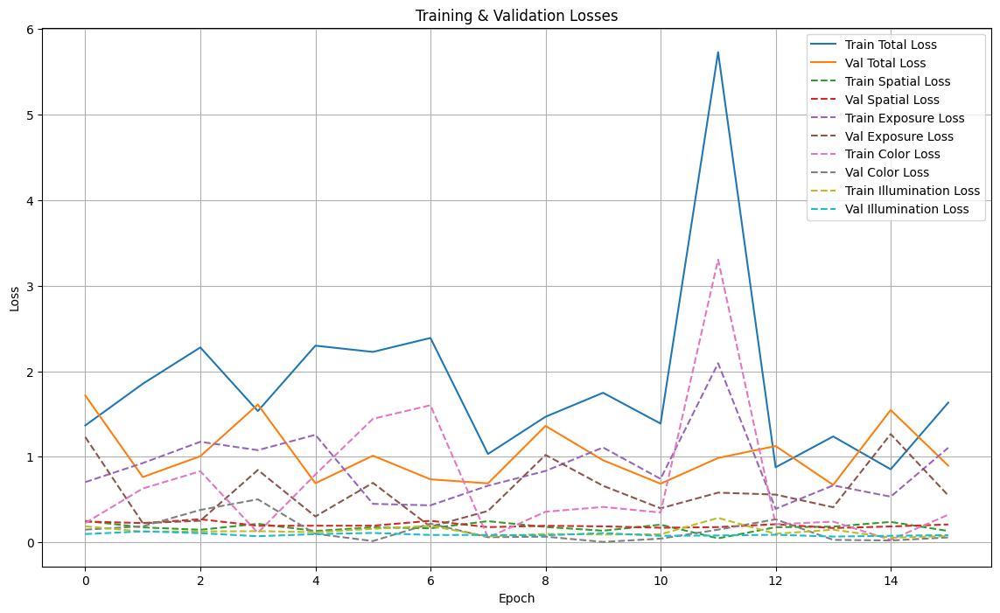

Saving model at epoch 16 to finetuned_models/zero_dce_finetune1007/epoch15...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch15\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch15\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 17
ETA: 3.9 min
Train Loss: 0.8229124546051025
  Spatial Consistency Loss: 0.16515272855758667
  Exposure Control Loss: 0.46241849660873413
  Color Constancy Loss: 0.10201949626207352
  Illumination Smoothness Loss: 0.09332171827554703
Validation Loss: 1.0909560918807983
  Spatial Consistency Loss: 0.20885907113552094
  Exposure Control Loss: 0.5528613328933716
  Color Constancy Loss: 0.25072431564331055
  Illumination Smoothness Loss: 0.07851135730743408



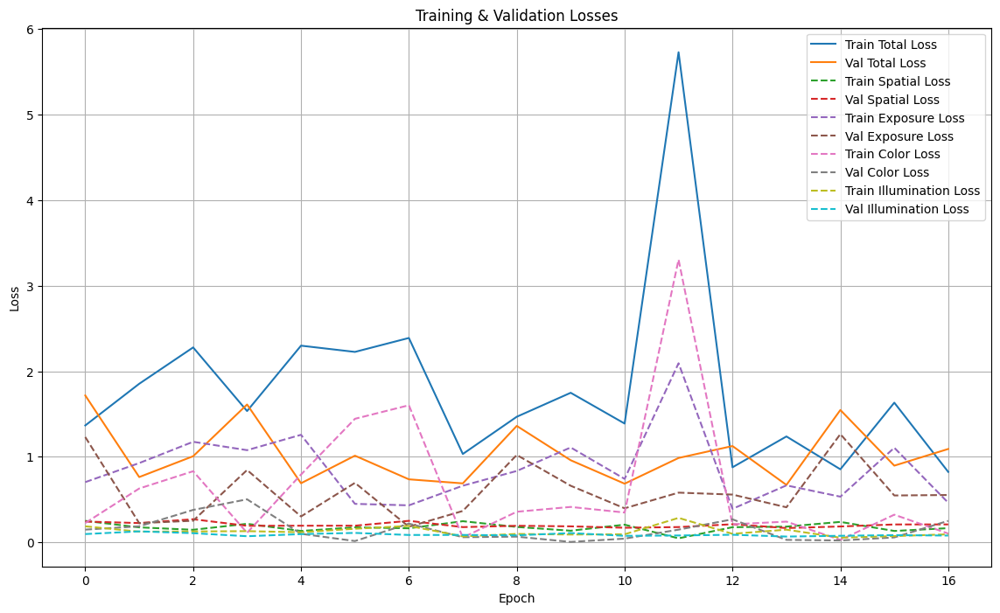

Saving model at epoch 17 to finetuned_models/zero_dce_finetune1007/epoch16...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch16\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch16\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 18
ETA: 3.93 min
Train Loss: 5.582298755645752
  Spatial Consistency Loss: 0.041968584060668945
  Exposure Control Loss: 2.221461057662964
  Color Constancy Loss: 3.0974225997924805
  Illumination Smoothness Loss: 0.22144636511802673
Validation Loss: 0.902249813079834
  Spatial Consistency Loss: 0.1752742975950241
  Exposure Control Loss: 0.5825095176696777
  Color Constancy Loss: 0.06997575610876083
  Illumination Smoothness Loss: 0.0744902715086937



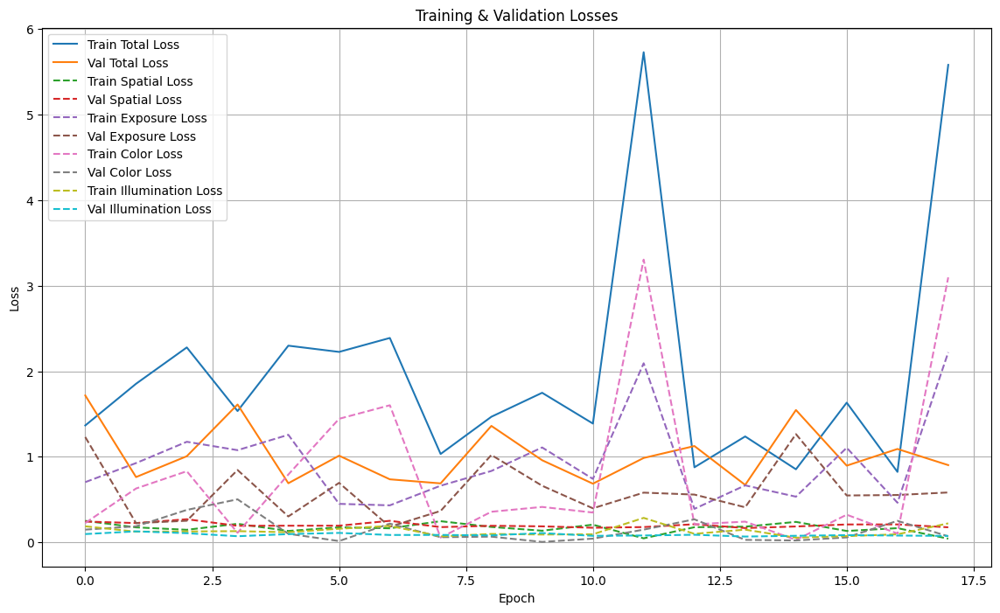

Saving model at epoch 18 to finetuned_models/zero_dce_finetune1007/epoch17...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch17\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch17\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 19
ETA: 3.95 min
Train Loss: 5.177260875701904
  Spatial Consistency Loss: 0.04501144587993622
  Exposure Control Loss: 2.1471590995788574
  Color Constancy Loss: 2.7953004837036133
  Illumination Smoothness Loss: 0.18978962302207947
Validation Loss: 1.4224867820739746
  Spatial Consistency Loss: 0.10750266909599304
  Exposure Control Loss: 1.1888684034347534
  Color Constancy Loss: 0.056842658668756485
  Illumination Smoothness Loss: 0.06927303224802017



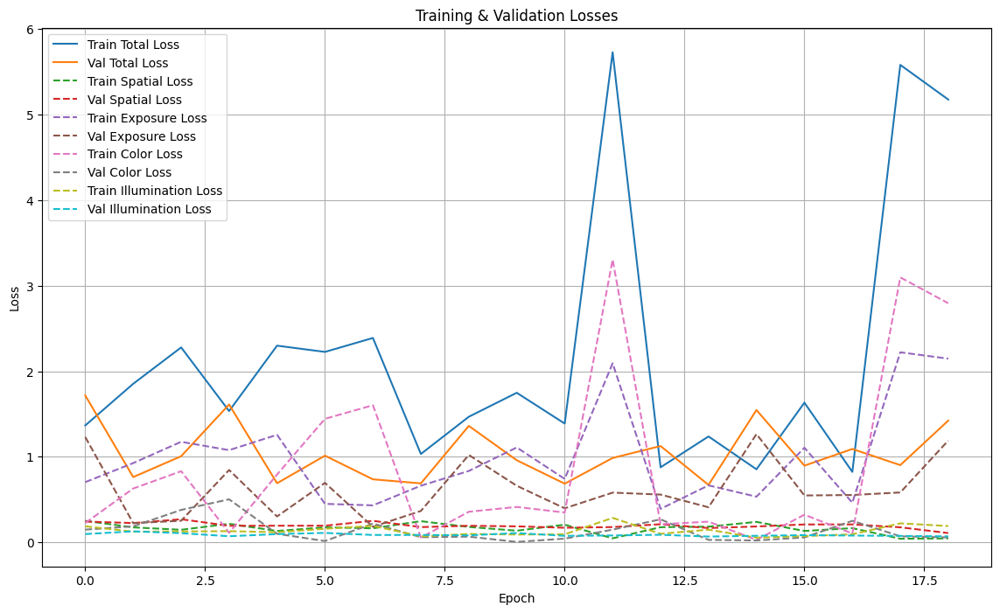

Saving model at epoch 19 to finetuned_models/zero_dce_finetune1007/epoch18...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch18\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch18\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 20
ETA: 3.79 min
Train Loss: 1.3461858034133911
  Spatial Consistency Loss: 0.17633813619613647
  Exposure Control Loss: 1.1047604084014893
  Color Constancy Loss: 0.01565014384686947
  Illumination Smoothness Loss: 0.04943704605102539
Validation Loss: 0.674915075302124
  Spatial Consistency Loss: 0.16258054971694946
  Exposure Control Loss: 0.43458622694015503
  Color Constancy Loss: 0.023390648886561394
  Illumination Smoothness Loss: 0.0543576255440712



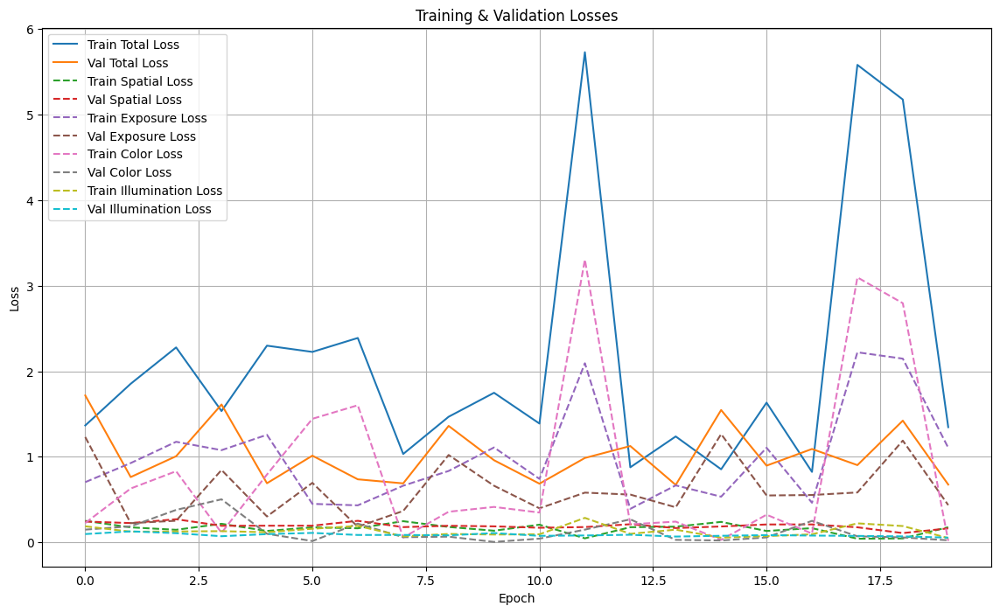

Saving model at epoch 20 to finetuned_models/zero_dce_finetune1007/epoch19...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch19\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch19\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.09s/steps]



Epoch: 21
ETA: 4.09 min
Train Loss: 0.7336164712905884
  Spatial Consistency Loss: 0.17350095510482788
  Exposure Control Loss: 0.4879779815673828
  Color Constancy Loss: 0.0247353482991457
  Illumination Smoothness Loss: 0.047402214258909225
Validation Loss: 0.6701840162277222
  Spatial Consistency Loss: 0.163518026471138
  Exposure Control Loss: 0.4237995743751526
  Color Constancy Loss: 0.030726689845323563
  Illumination Smoothness Loss: 0.052139732986688614



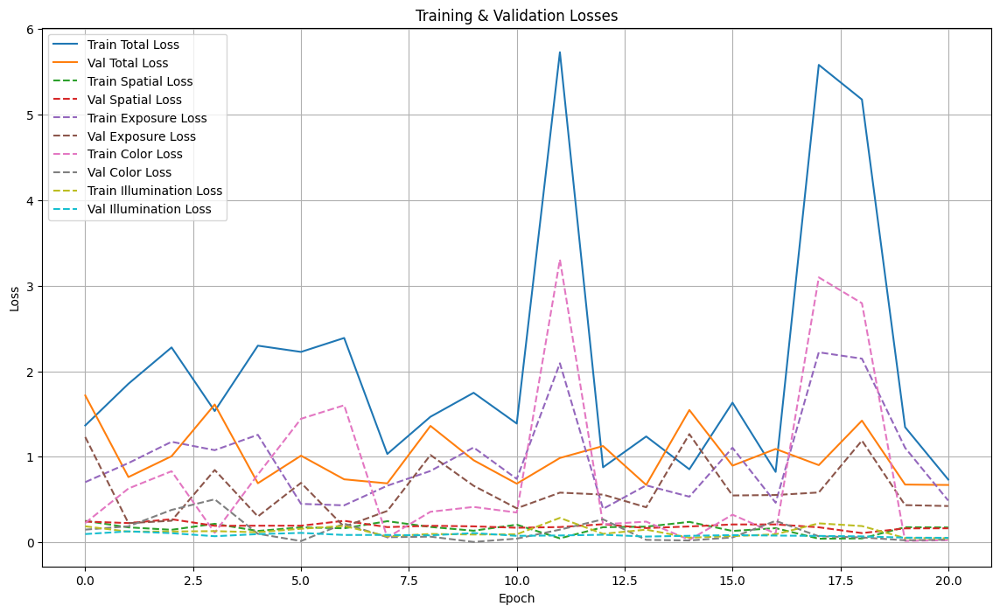

Saving model at epoch 21 to finetuned_models/zero_dce_finetune1007/epoch20...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch20\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch20\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 22
ETA: 3.8 min
Train Loss: 3.379041910171509
  Spatial Consistency Loss: 0.06090250238776207
  Exposure Control Loss: 2.697097063064575
  Color Constancy Loss: 0.556591808795929
  Illumination Smoothness Loss: 0.06445048749446869
Validation Loss: 0.5035348534584045
  Spatial Consistency Loss: 0.22945883870124817
  Exposure Control Loss: 0.1506107747554779
  Color Constancy Loss: 0.07452333718538284
  Illumination Smoothness Loss: 0.04894188791513443



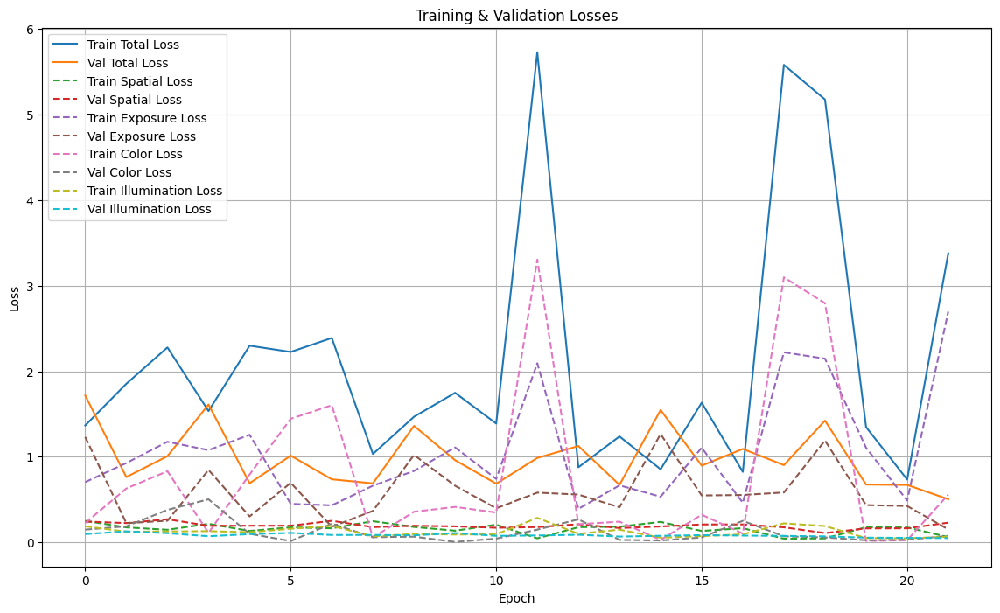

Saving model at epoch 22 to finetuned_models/zero_dce_finetune1007/epoch21...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch21\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch21\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 23
ETA: 3.89 min
Train Loss: 1.9779491424560547
  Spatial Consistency Loss: 0.11226293444633484
  Exposure Control Loss: 1.4544318914413452
  Color Constancy Loss: 0.3382192850112915
  Illumination Smoothness Loss: 0.07303501665592194
Validation Loss: 0.5057627558708191
  Spatial Consistency Loss: 0.23216989636421204
  Exposure Control Loss: 0.15409618616104126
  Color Constancy Loss: 0.07193504273891449
  Illumination Smoothness Loss: 0.04756167158484459



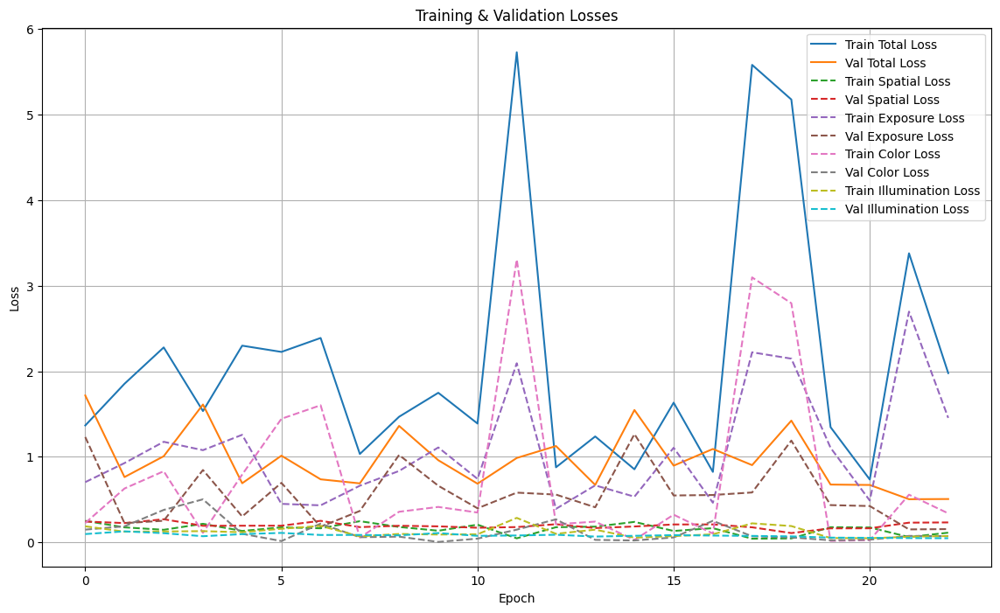

Saving model at epoch 23 to finetuned_models/zero_dce_finetune1007/epoch22...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch22\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch22\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 24
ETA: 3.83 min
Train Loss: 0.7425538301467896
  Spatial Consistency Loss: 0.18064242601394653
  Exposure Control Loss: 0.36997556686401367
  Color Constancy Loss: 0.11830371618270874
  Illumination Smoothness Loss: 0.0736321210861206
Validation Loss: 1.71890127658844
  Spatial Consistency Loss: 0.17869864404201508
  Exposure Control Loss: 1.4963951110839844
  Color Constancy Loss: 0.005859604105353355
  Illumination Smoothness Loss: 0.03794784098863602



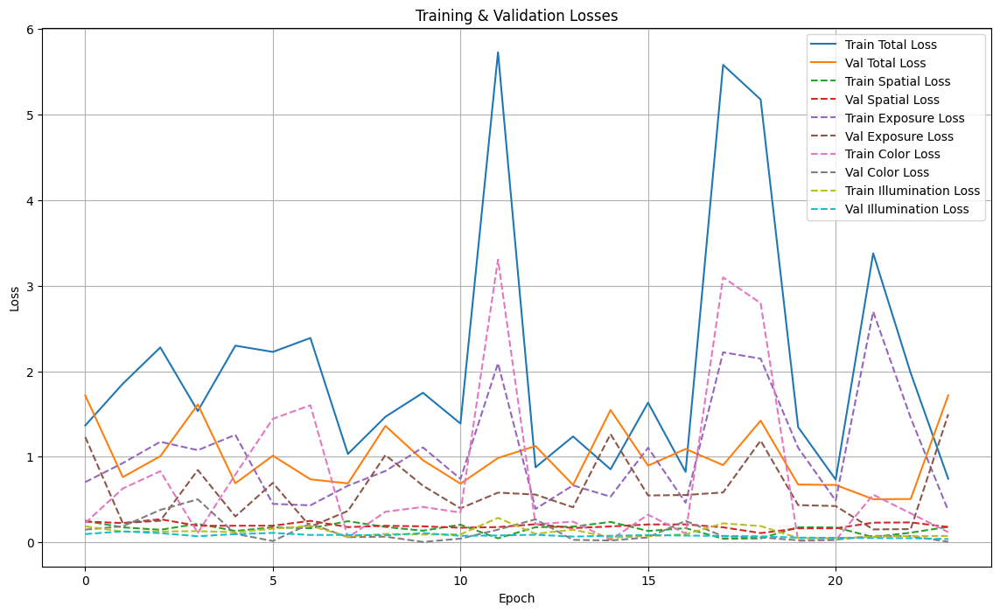

Saving model at epoch 24 to finetuned_models/zero_dce_finetune1007/epoch23...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch23\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch23\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 25
ETA: 3.83 min
Train Loss: 1.6024185419082642
  Spatial Consistency Loss: 0.18172293901443481
  Exposure Control Loss: 1.352994441986084
  Color Constancy Loss: 0.026129741221666336
  Illumination Smoothness Loss: 0.0415714867413044
Validation Loss: 1.3479024171829224
  Spatial Consistency Loss: 0.16806326806545258
  Exposure Control Loss: 1.1140073537826538
  Color Constancy Loss: 0.004027920309454203
  Illumination Smoothness Loss: 0.061803847551345825



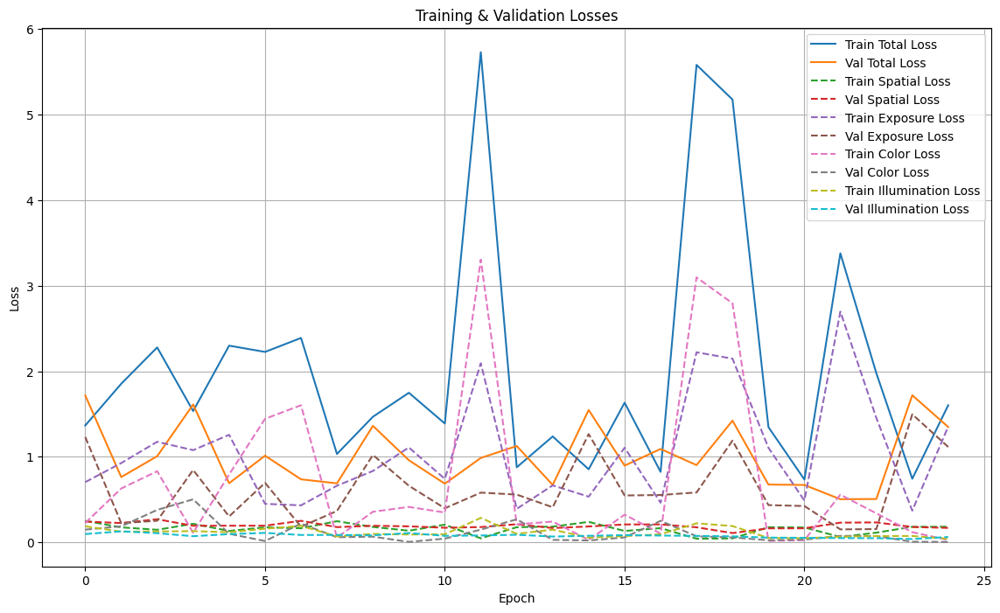

Saving model at epoch 25 to finetuned_models/zero_dce_finetune1007/epoch24...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch24\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch24\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 26
ETA: 3.72 min
Train Loss: 0.7762110233306885
  Spatial Consistency Loss: 0.16193360090255737
  Exposure Control Loss: 0.47598153352737427
  Color Constancy Loss: 0.06303584575653076
  Illumination Smoothness Loss: 0.07526002824306488
Validation Loss: 1.0579863786697388
  Spatial Consistency Loss: 0.2053670585155487
  Exposure Control Loss: 0.5460708141326904
  Color Constancy Loss: 0.2452702671289444
  Illumination Smoothness Loss: 0.061278242617845535



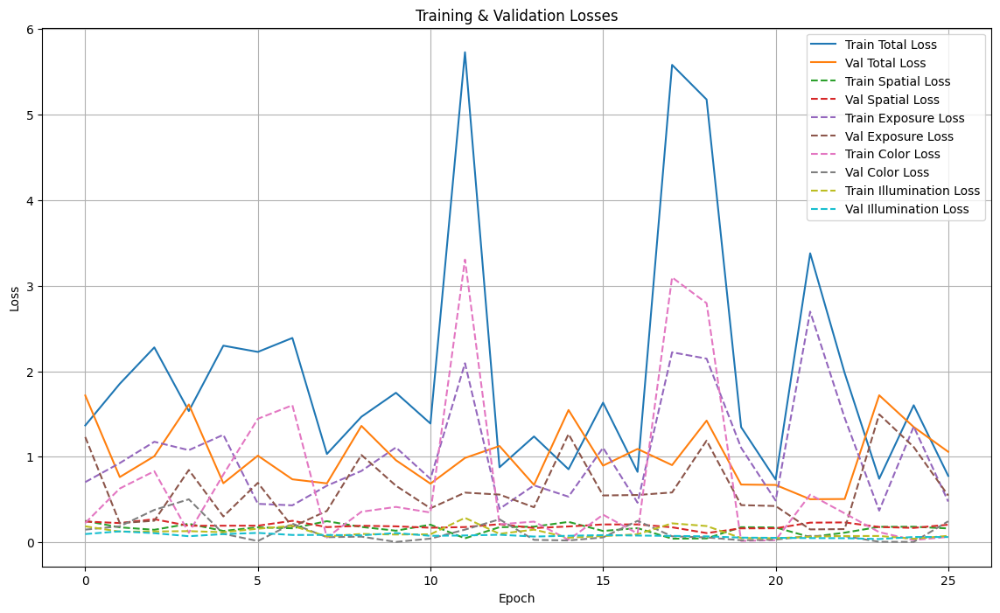

Saving model at epoch 26 to finetuned_models/zero_dce_finetune1007/epoch25...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch25\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch25\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 27
ETA: 3.98 min
Train Loss: 1.3256045579910278
  Spatial Consistency Loss: 0.17307765781879425
  Exposure Control Loss: 1.1051850318908691
  Color Constancy Loss: 0.008149108849465847
  Illumination Smoothness Loss: 0.03919266164302826
Validation Loss: 1.0325539112091064
  Spatial Consistency Loss: 0.1687140166759491
  Exposure Control Loss: 0.7125325202941895
  Color Constancy Loss: 0.07211514562368393
  Illumination Smoothness Loss: 0.07919223606586456



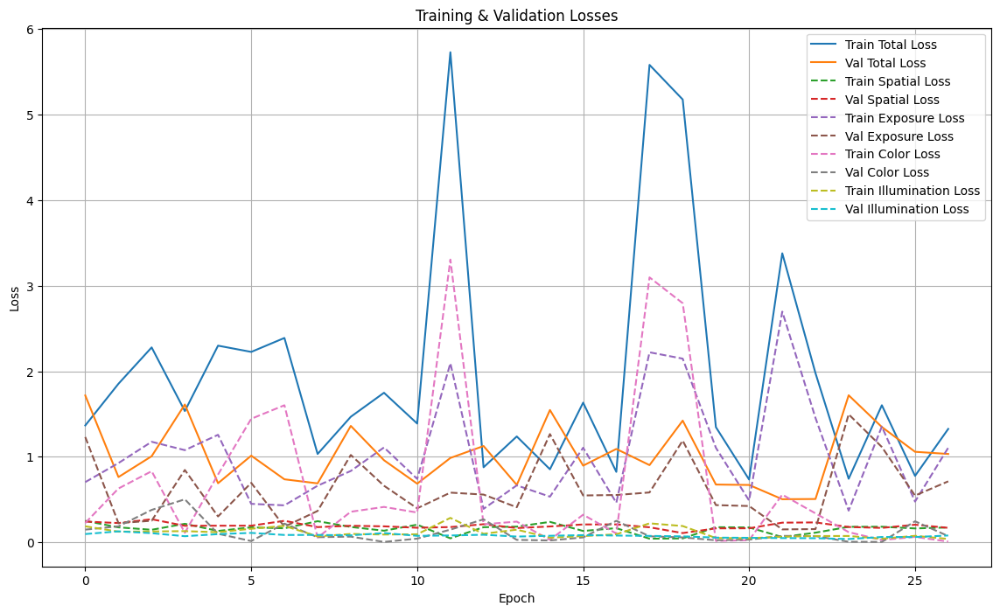

Saving model at epoch 27 to finetuned_models/zero_dce_finetune1007/epoch26...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch26\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch26\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 28
ETA: 3.94 min
Train Loss: 1.3119466304779053
  Spatial Consistency Loss: 0.16739627718925476
  Exposure Control Loss: 0.8580688238143921
  Color Constancy Loss: 0.22663140296936035
  Illumination Smoothness Loss: 0.059850048273801804
Validation Loss: 1.725732445716858
  Spatial Consistency Loss: 0.16867385804653168
  Exposure Control Loss: 1.5095824003219604
  Color Constancy Loss: 0.00989933405071497
  Illumination Smoothness Loss: 0.03757675737142563



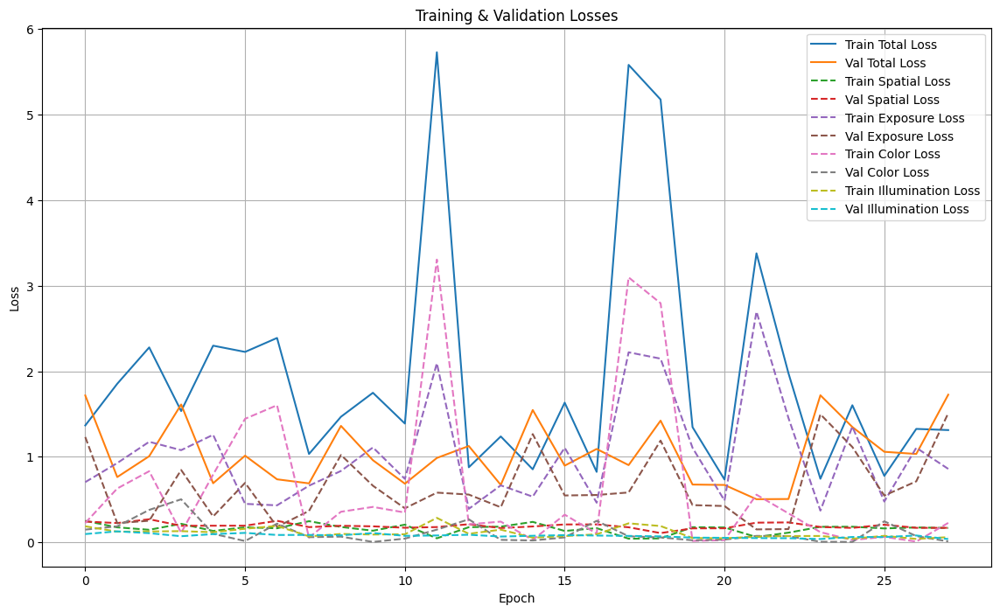

Saving model at epoch 28 to finetuned_models/zero_dce_finetune1007/epoch27...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch27\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch27\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 29
ETA: 3.94 min
Train Loss: 1.9976279735565186
  Spatial Consistency Loss: 0.1521129310131073
  Exposure Control Loss: 0.4367363154888153
  Color Constancy Loss: 1.3166580200195312
  Illumination Smoothness Loss: 0.09212061762809753
Validation Loss: 1.308442234992981
  Spatial Consistency Loss: 0.12348850816488266
  Exposure Control Loss: 0.997528076171875
  Color Constancy Loss: 0.13456077873706818
  Illumination Smoothness Loss: 0.05286477878689766



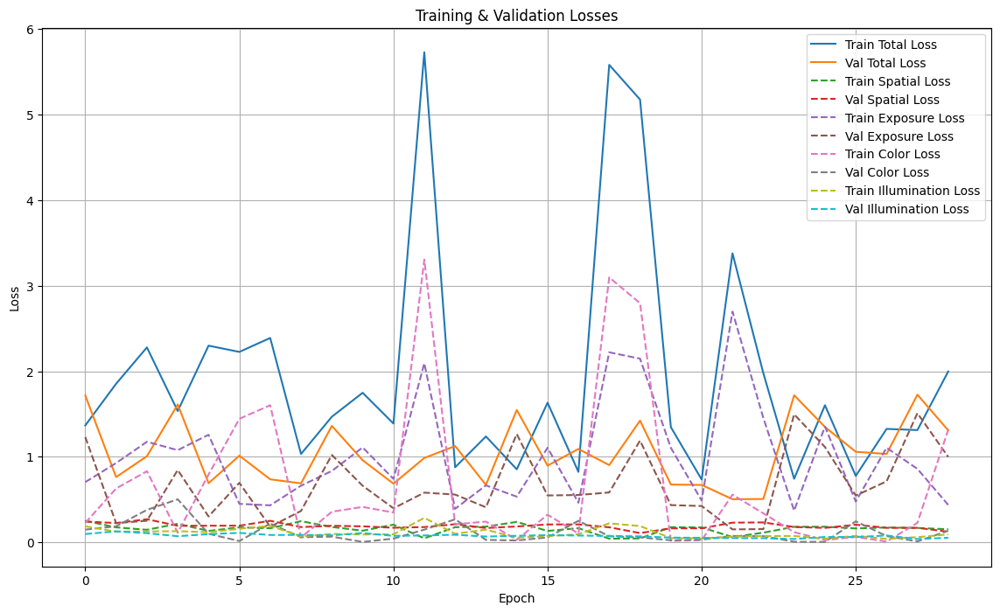

Saving model at epoch 29 to finetuned_models/zero_dce_finetune1007/epoch28...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch28\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch28\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 30
ETA: 3.92 min
Train Loss: 3.4157567024230957
  Spatial Consistency Loss: 0.06085403636097908
  Exposure Control Loss: 2.695172071456909
  Color Constancy Loss: 0.606238603591919
  Illumination Smoothness Loss: 0.0534919798374176
Validation Loss: 1.4912018775939941
  Spatial Consistency Loss: 0.18053825199604034
  Exposure Control Loss: 1.2439347505569458
  Color Constancy Loss: 0.01104907039552927
  Illumination Smoothness Loss: 0.055679842829704285



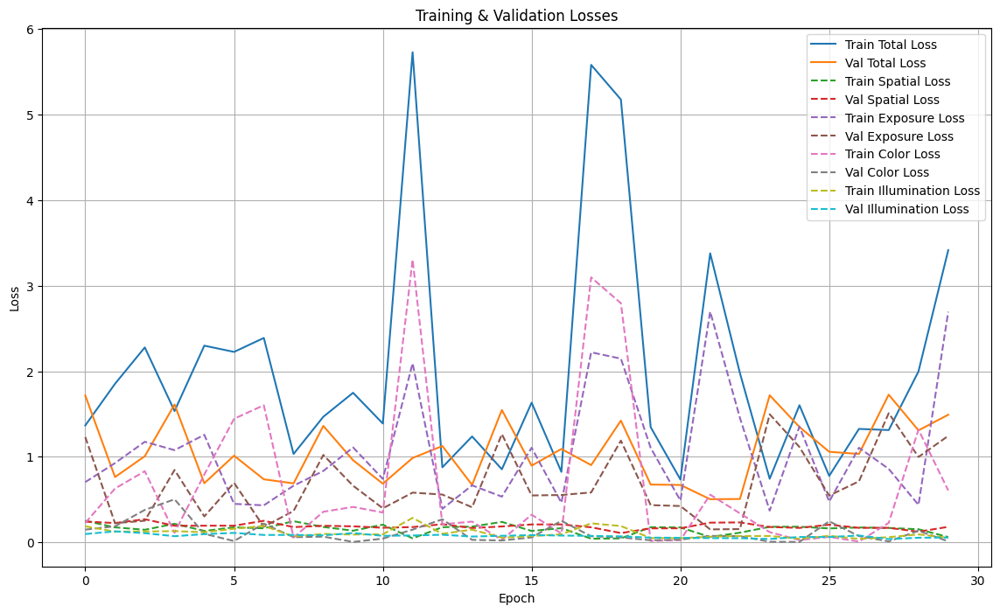

Saving model at epoch 30 to finetuned_models/zero_dce_finetune1007/epoch29...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch29\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch29\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.07s/steps]



Epoch: 31
ETA: 3.9 min
Train Loss: 1.621744155883789
  Spatial Consistency Loss: 0.12732046842575073
  Exposure Control Loss: 1.17368745803833
  Color Constancy Loss: 0.27025800943374634
  Illumination Smoothness Loss: 0.050478264689445496
Validation Loss: 1.0546019077301025
  Spatial Consistency Loss: 0.20437122881412506
  Exposure Control Loss: 0.5430360436439514
  Color Constancy Loss: 0.25083160400390625
  Illumination Smoothness Loss: 0.05636304244399071



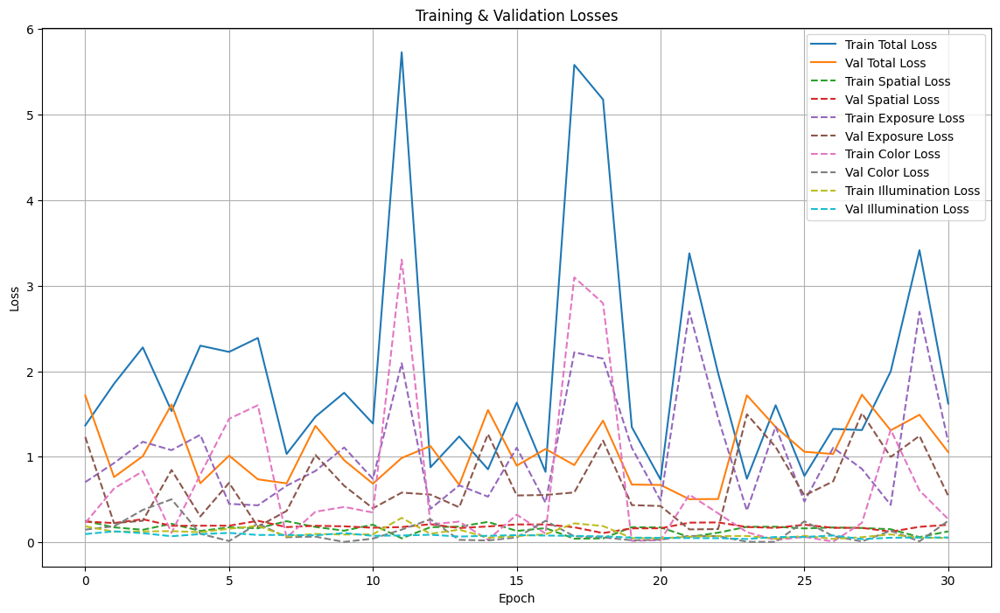

Saving model at epoch 31 to finetuned_models/zero_dce_finetune1007/epoch30...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch30\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch30\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 32
ETA: 3.85 min
Train Loss: 1.6385377645492554
  Spatial Consistency Loss: 0.13831445574760437
  Exposure Control Loss: 0.9955701231956482
  Color Constancy Loss: 0.45238974690437317
  Illumination Smoothness Loss: 0.05226345360279083
Validation Loss: 0.7732674479484558
  Spatial Consistency Loss: 0.17852431535720825
  Exposure Control Loss: 0.5399144887924194
  Color Constancy Loss: 0.009220138192176819
  Illumination Smoothness Loss: 0.045608535408973694



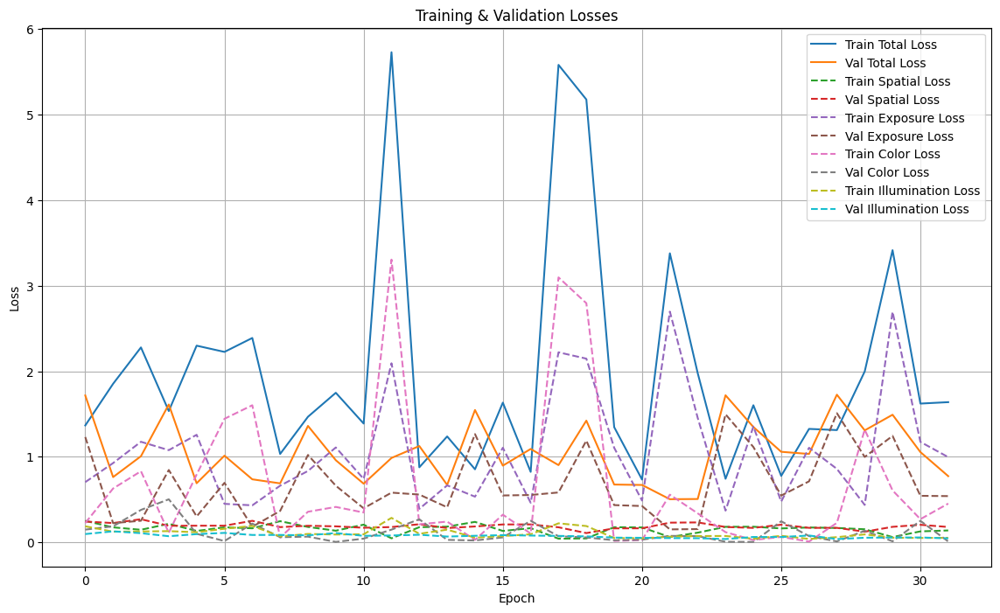

Saving model at epoch 32 to finetuned_models/zero_dce_finetune1007/epoch31...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch31\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch31\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 33
ETA: 3.86 min
Train Loss: 0.8704947233200073
  Spatial Consistency Loss: 0.2082393914461136
  Exposure Control Loss: 0.5673883557319641
  Color Constancy Loss: 0.05542430281639099
  Illumination Smoothness Loss: 0.03944268450140953
Validation Loss: 1.0475049018859863
  Spatial Consistency Loss: 0.16908526420593262
  Exposure Control Loss: 0.7001346945762634
  Color Constancy Loss: 0.11037476360797882
  Illumination Smoothness Loss: 0.06791019439697266



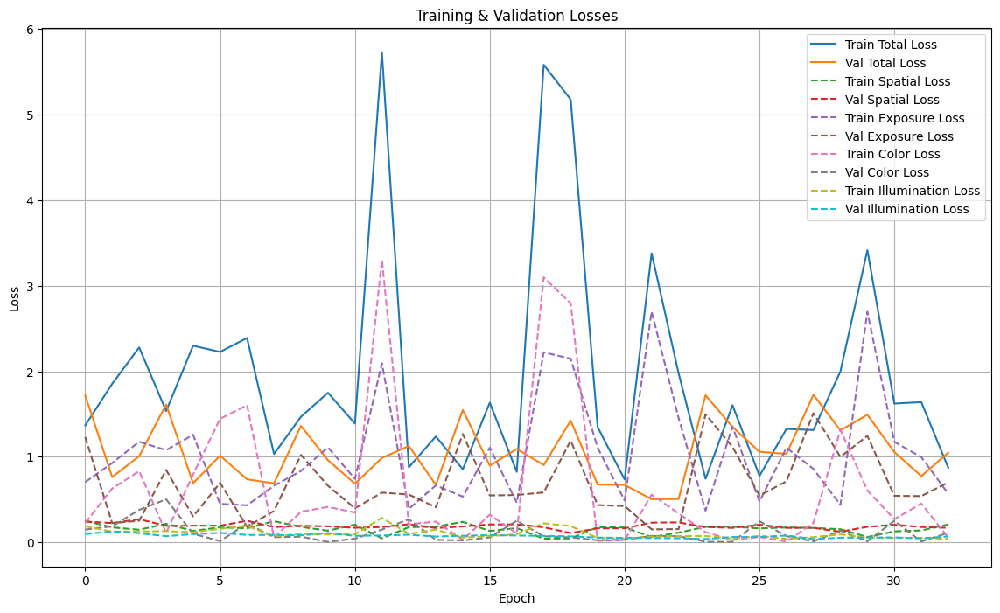

Saving model at epoch 33 to finetuned_models/zero_dce_finetune1007/epoch32...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch32\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch32\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 34
ETA: 3.84 min
Train Loss: 1.3467789888381958
  Spatial Consistency Loss: 0.1699100285768509
  Exposure Control Loss: 0.847165584564209
  Color Constancy Loss: 0.27760350704193115
  Illumination Smoothness Loss: 0.05209977552294731
Validation Loss: 1.017804503440857
  Spatial Consistency Loss: 0.17344915866851807
  Exposure Control Loss: 0.6604528427124023
  Color Constancy Loss: 0.11338252574205399
  Illumination Smoothness Loss: 0.07051994651556015



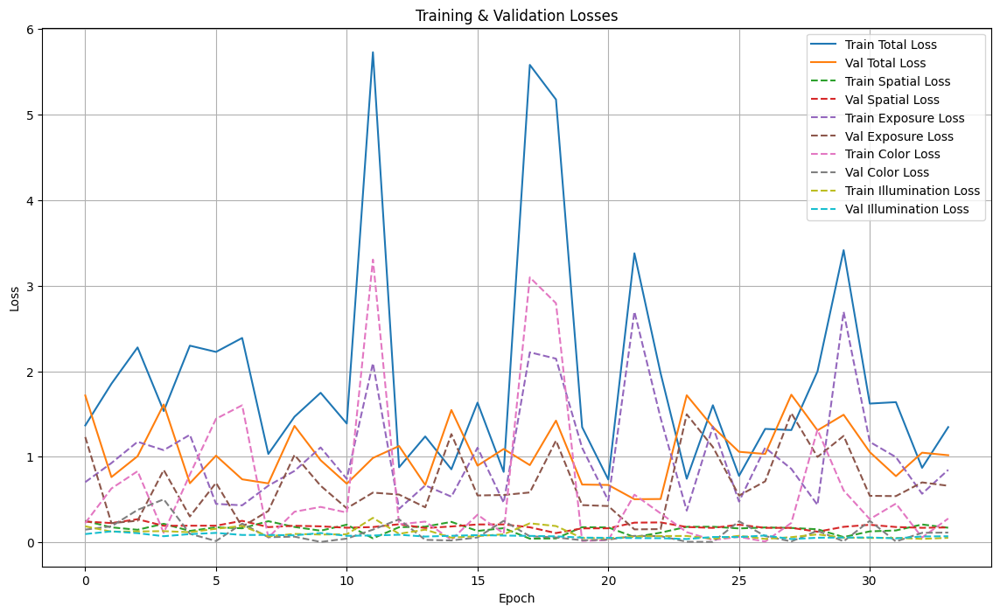

Saving model at epoch 34 to finetuned_models/zero_dce_finetune1007/epoch33...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch33\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch33\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 35
ETA: 4.03 min
Train Loss: 0.8537768125534058
  Spatial Consistency Loss: 0.22552919387817383
  Exposure Control Loss: 0.5740143656730652
  Color Constancy Loss: 0.021719053387641907
  Illumination Smoothness Loss: 0.03251422196626663
Validation Loss: 0.7223941087722778
  Spatial Consistency Loss: 0.15615810453891754
  Exposure Control Loss: 0.4673577845096588
  Color Constancy Loss: 0.06652633845806122
  Illumination Smoothness Loss: 0.03235182538628578



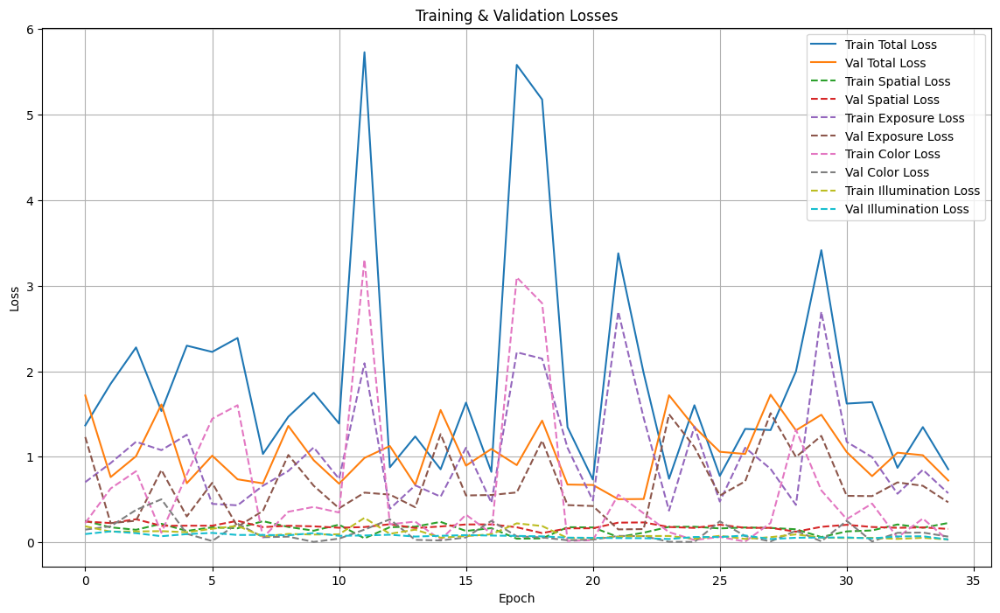

Saving model at epoch 35 to finetuned_models/zero_dce_finetune1007/epoch34...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch34\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch34\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 36
ETA: 4.04 min
Train Loss: 0.8681601881980896
  Spatial Consistency Loss: 0.15914838016033173
  Exposure Control Loss: 0.5187675356864929
  Color Constancy Loss: 0.1620413064956665
  Illumination Smoothness Loss: 0.028202932327985764
Validation Loss: 1.353040337562561
  Spatial Consistency Loss: 0.1731082946062088
  Exposure Control Loss: 1.0874829292297363
  Color Constancy Loss: 0.04364529997110367
  Illumination Smoothness Loss: 0.048803769052028656



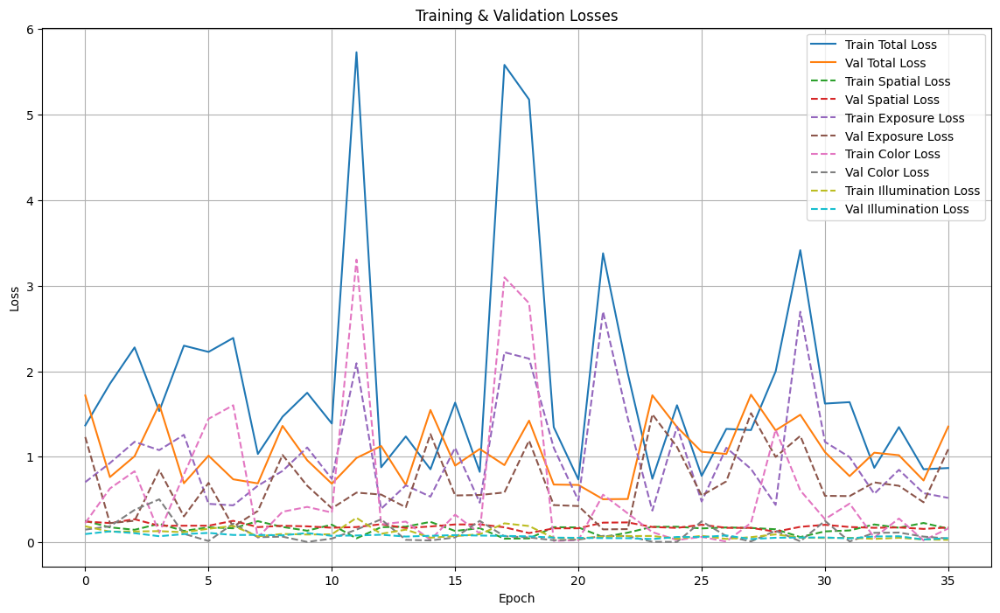

Saving model at epoch 36 to finetuned_models/zero_dce_finetune1007/epoch35...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch35\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch35\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 37
ETA: 4.09 min
Train Loss: 1.367367148399353
  Spatial Consistency Loss: 0.1645829826593399
  Exposure Control Loss: 0.897423267364502
  Color Constancy Loss: 0.25434136390686035
  Illumination Smoothness Loss: 0.051019493490457535
Validation Loss: 1.477075457572937
  Spatial Consistency Loss: 0.17877578735351562
  Exposure Control Loss: 1.235252022743225
  Color Constancy Loss: 0.014456204138696194
  Illumination Smoothness Loss: 0.048591483384370804



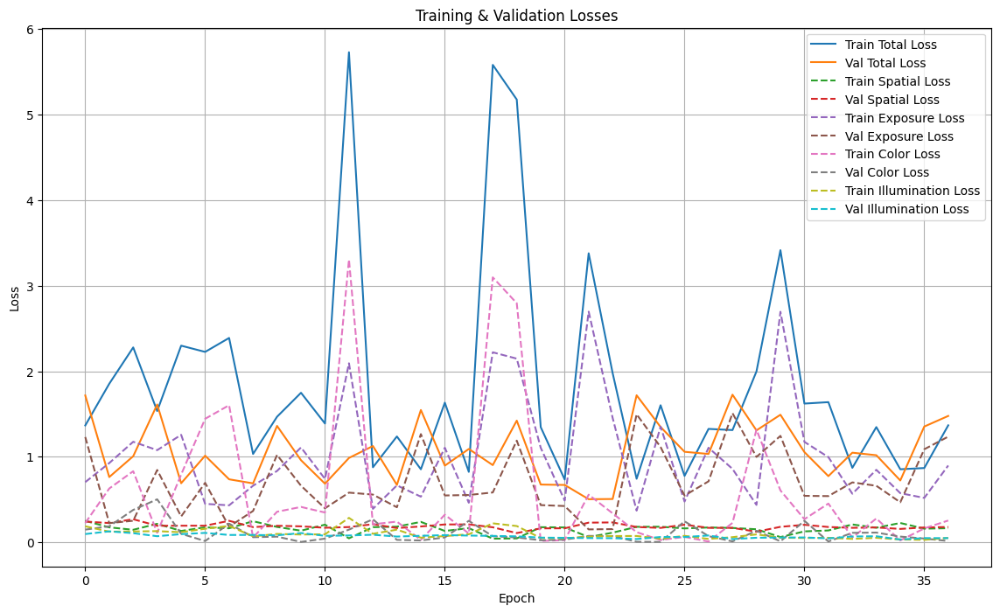

Saving model at epoch 37 to finetuned_models/zero_dce_finetune1007/epoch36...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch36\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch36\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 38
ETA: 3.91 min
Train Loss: 0.788217306137085
  Spatial Consistency Loss: 0.2276531308889389
  Exposure Control Loss: 0.504294753074646
  Color Constancy Loss: 0.02724749967455864
  Illumination Smoothness Loss: 0.029021920636296272
Validation Loss: 1.1139037609100342
  Spatial Consistency Loss: 0.17524930834770203
  Exposure Control Loss: 0.9036507606506348
  Color Constancy Loss: 0.002444481011480093
  Illumination Smoothness Loss: 0.0325591079890728



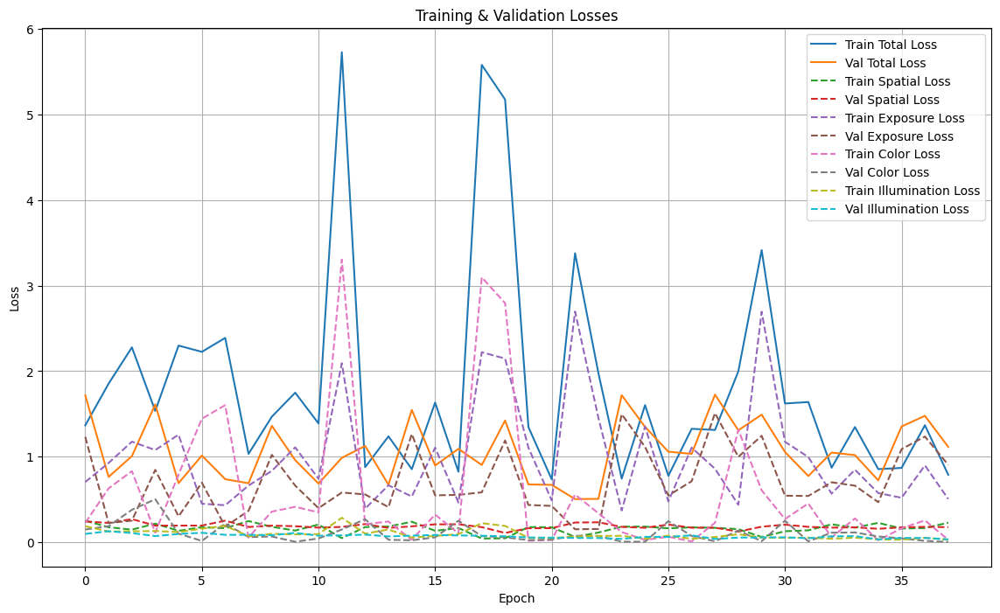

Saving model at epoch 38 to finetuned_models/zero_dce_finetune1007/epoch37...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch37\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch37\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 39
ETA: 3.82 min
Train Loss: 0.8807909488677979
  Spatial Consistency Loss: 0.17619016766548157
  Exposure Control Loss: 0.4755869507789612
  Color Constancy Loss: 0.19176088273525238
  Illumination Smoothness Loss: 0.03725287690758705
Validation Loss: 1.3164417743682861
  Spatial Consistency Loss: 0.16243381798267365
  Exposure Control Loss: 1.1044150590896606
  Color Constancy Loss: 0.0011886951979249716
  Illumination Smoothness Loss: 0.04840419441461563



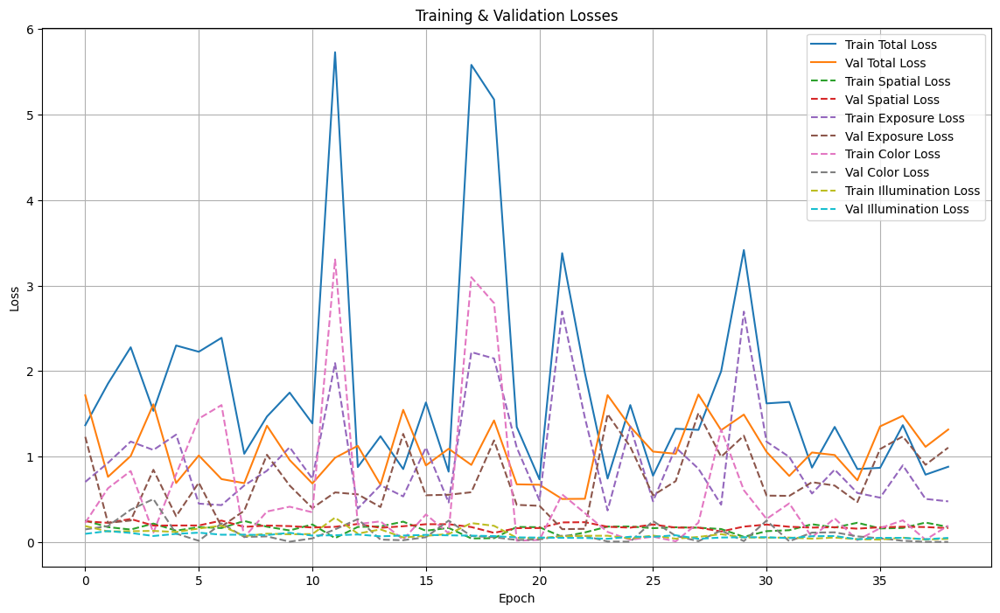

Saving model at epoch 39 to finetuned_models/zero_dce_finetune1007/epoch38...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch38\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch38\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 40
ETA: 3.76 min
Train Loss: 1.2444840669631958
  Spatial Consistency Loss: 0.1693190336227417
  Exposure Control Loss: 0.778583288192749
  Color Constancy Loss: 0.25124073028564453
  Illumination Smoothness Loss: 0.04534102603793144
Validation Loss: 1.1623477935791016
  Spatial Consistency Loss: 0.16642743349075317
  Exposure Control Loss: 0.9482417106628418
  Color Constancy Loss: 0.008214482106268406
  Illumination Smoothness Loss: 0.03946428373456001



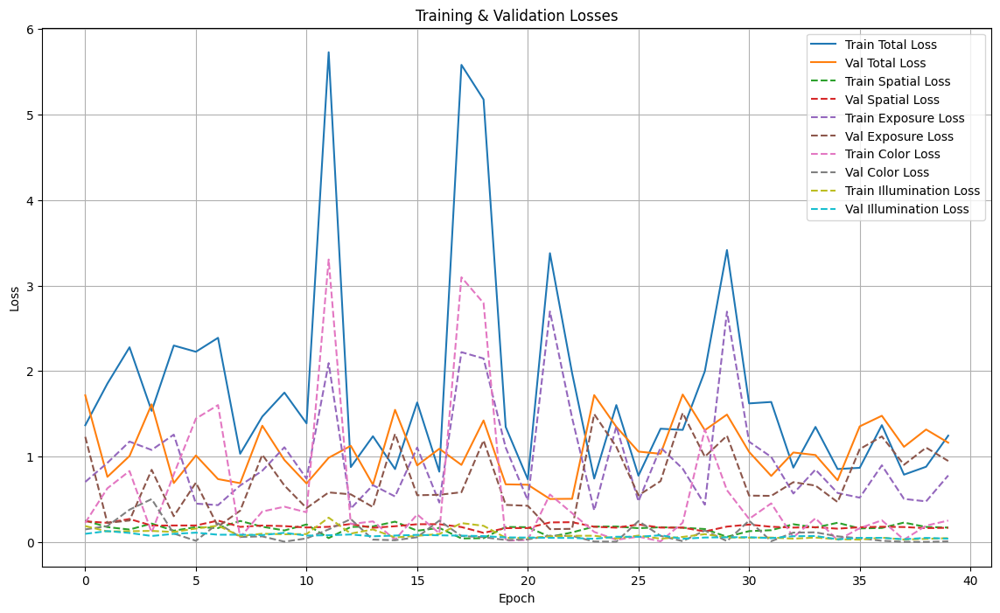

Saving model at epoch 40 to finetuned_models/zero_dce_finetune1007/epoch39...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch39\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch39\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 41
ETA: 3.83 min
Train Loss: 1.6151410341262817
  Spatial Consistency Loss: 0.12386775016784668
  Exposure Control Loss: 1.1990752220153809
  Color Constancy Loss: 0.2515977621078491
  Illumination Smoothness Loss: 0.0406002439558506
Validation Loss: 1.382692575454712
  Spatial Consistency Loss: 0.16998666524887085
  Exposure Control Loss: 1.1019877195358276
  Color Constancy Loss: 0.06438986212015152
  Illumination Smoothness Loss: 0.04632844030857086



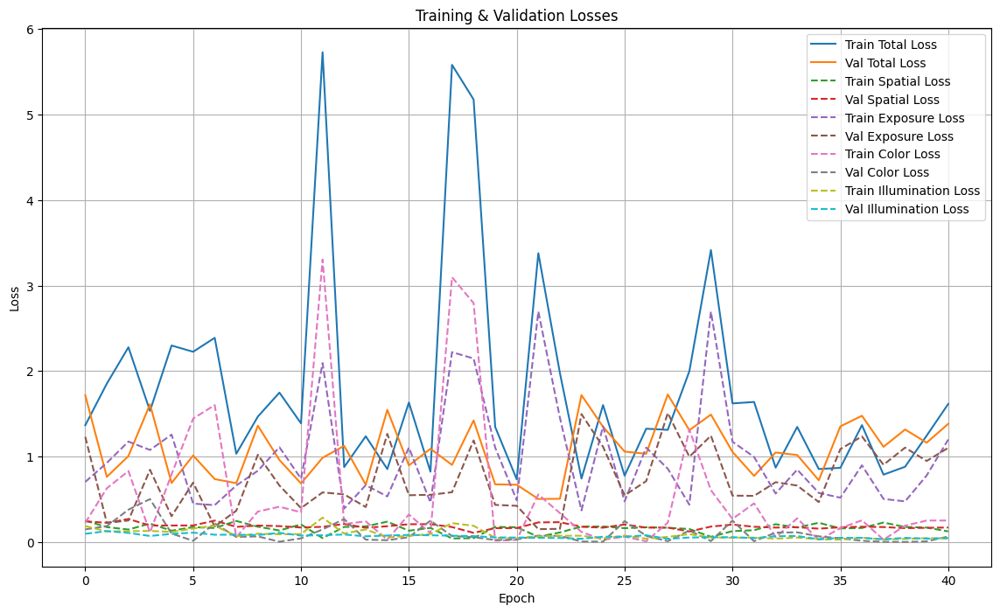

Saving model at epoch 41 to finetuned_models/zero_dce_finetune1007/epoch40...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch40\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch40\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 42
ETA: 3.87 min
Train Loss: 1.4560861587524414
  Spatial Consistency Loss: 0.17099791765213013
  Exposure Control Loss: 1.256593942642212
  Color Constancy Loss: 0.0012496161507442594
  Illumination Smoothness Loss: 0.027244720607995987
Validation Loss: 0.7648541331291199
  Spatial Consistency Loss: 0.17324376106262207
  Exposure Control Loss: 0.552066445350647
  Color Constancy Loss: 0.0030035064555704594
  Illumination Smoothness Loss: 0.0365404337644577



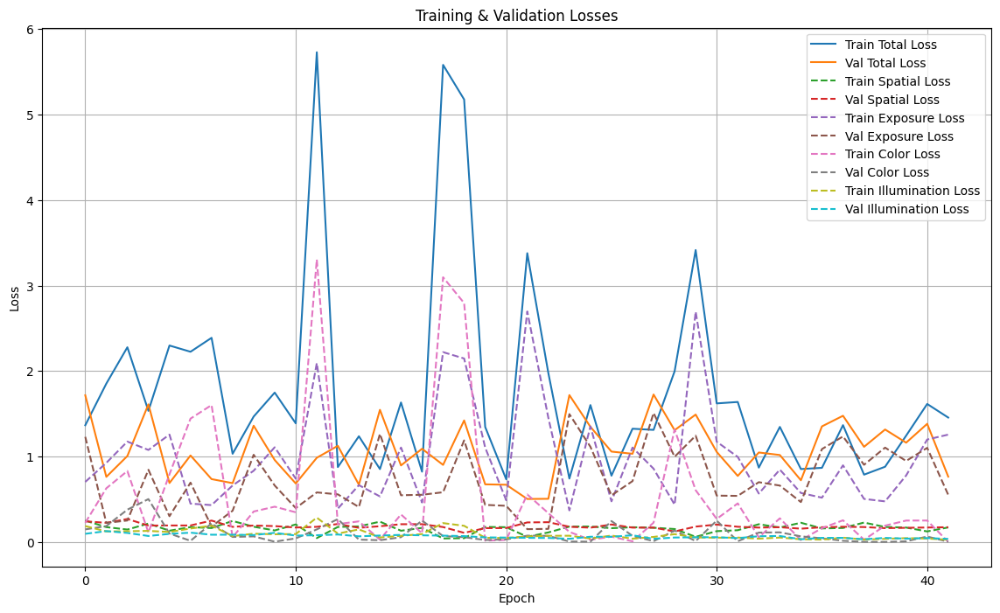

Saving model at epoch 42 to finetuned_models/zero_dce_finetune1007/epoch41...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch41\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch41\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 43
ETA: 3.83 min
Train Loss: 3.350508689880371
  Spatial Consistency Loss: 0.059493422508239746
  Exposure Control Loss: 2.719111204147339
  Color Constancy Loss: 0.5351886749267578
  Illumination Smoothness Loss: 0.03671557456254959
Validation Loss: 1.5607162714004517
  Spatial Consistency Loss: 0.10113637894392014
  Exposure Control Loss: 1.2629424333572388
  Color Constancy Loss: 0.1657606065273285
  Illumination Smoothness Loss: 0.03087684139609337



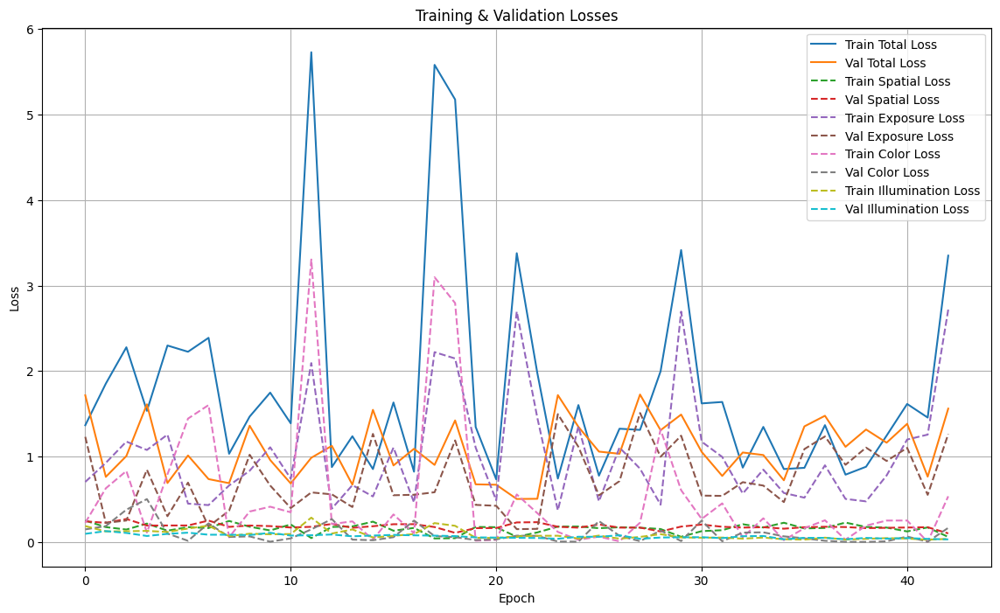

Saving model at epoch 43 to finetuned_models/zero_dce_finetune1007/epoch42...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch42\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch42\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.09s/steps]



Epoch: 44
ETA: 4.07 min
Train Loss: 1.5177208185195923
  Spatial Consistency Loss: 0.16086071729660034
  Exposure Control Loss: 0.4506043791770935
  Color Constancy Loss: 0.8405974507331848
  Illumination Smoothness Loss: 0.06565818190574646
Validation Loss: 1.7089017629623413
  Spatial Consistency Loss: 0.15990978479385376
  Exposure Control Loss: 1.504233956336975
  Color Constancy Loss: 0.0005630473024211824
  Illumination Smoothness Loss: 0.04419492185115814



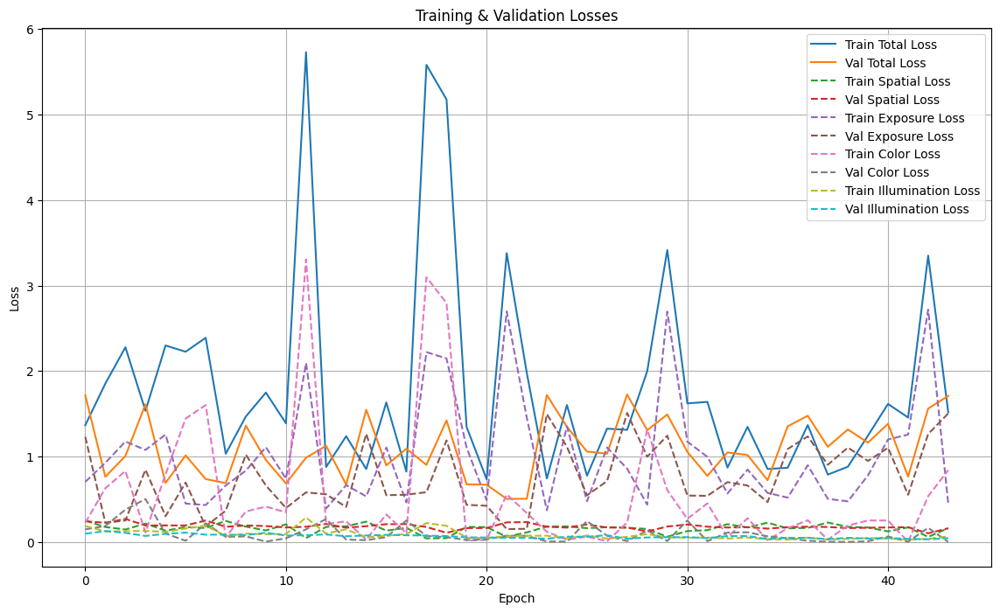

Saving model at epoch 44 to finetuned_models/zero_dce_finetune1007/epoch43...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch43\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch43\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 45
ETA: 3.99 min
Train Loss: 1.6121137142181396
  Spatial Consistency Loss: 0.13382913172245026
  Exposure Control Loss: 1.019928216934204
  Color Constancy Loss: 0.41704627871513367
  Illumination Smoothness Loss: 0.04131003096699715
Validation Loss: 1.3431386947631836
  Spatial Consistency Loss: 0.17497111856937408
  Exposure Control Loss: 1.0684350728988647
  Color Constancy Loss: 0.05614262819290161
  Illumination Smoothness Loss: 0.04358980804681778



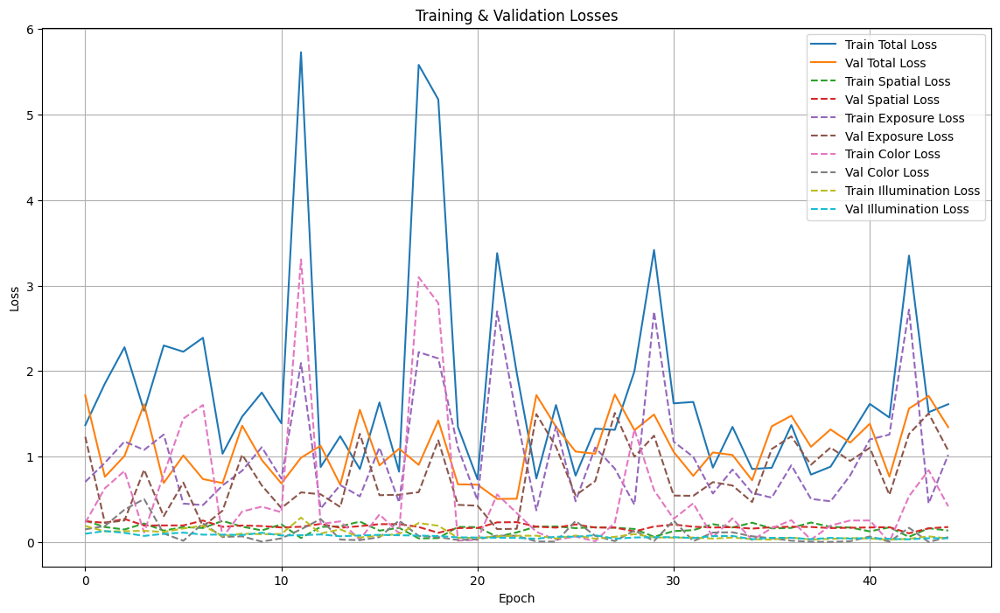

Saving model at epoch 45 to finetuned_models/zero_dce_finetune1007/epoch44...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch44\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch44\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.08s/steps]



Epoch: 46
ETA: 3.94 min
Train Loss: 1.6078985929489136
  Spatial Consistency Loss: 0.1340719312429428
  Exposure Control Loss: 1.0188244581222534
  Color Constancy Loss: 0.4137454628944397
  Illumination Smoothness Loss: 0.04125673323869705
Validation Loss: 1.3326125144958496
  Spatial Consistency Loss: 0.16402611136436462
  Exposure Control Loss: 0.7043821811676025
  Color Constancy Loss: 0.42742785811424255
  Illumination Smoothness Loss: 0.0367763377726078



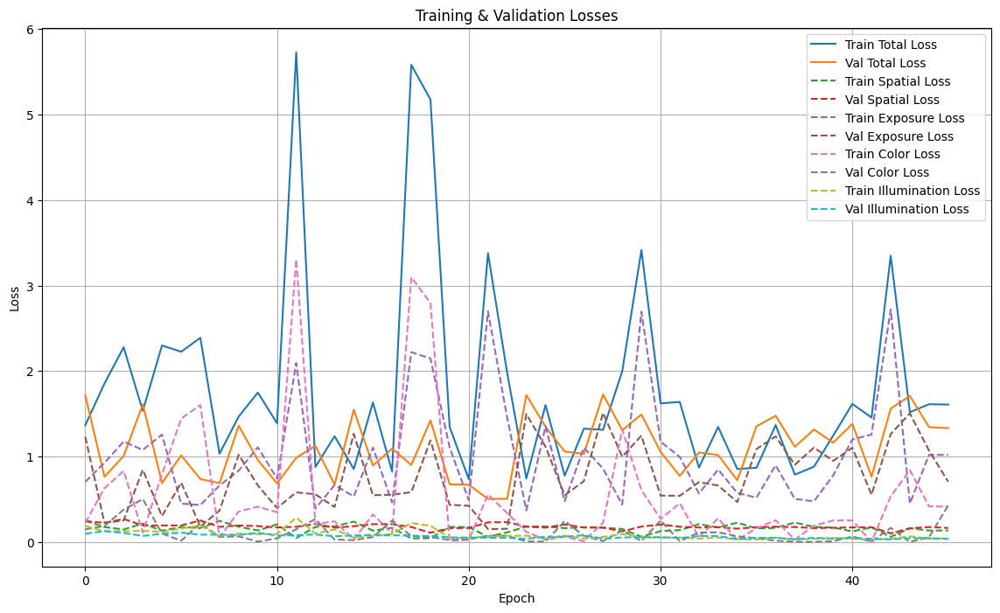

Saving model at epoch 46 to finetuned_models/zero_dce_finetune1007/epoch45...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch45\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch45\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 47
ETA: 3.93 min
Train Loss: 3.3710079193115234
  Spatial Consistency Loss: 0.059749629348516464
  Exposure Control Loss: 2.725086212158203
  Color Constancy Loss: 0.5501931309700012
  Illumination Smoothness Loss: 0.035978980362415314
Validation Loss: 1.092885971069336
  Spatial Consistency Loss: 0.1642792522907257
  Exposure Control Loss: 0.7026041150093079
  Color Constancy Loss: 0.1673600673675537
  Illumination Smoothness Loss: 0.05864255502820015



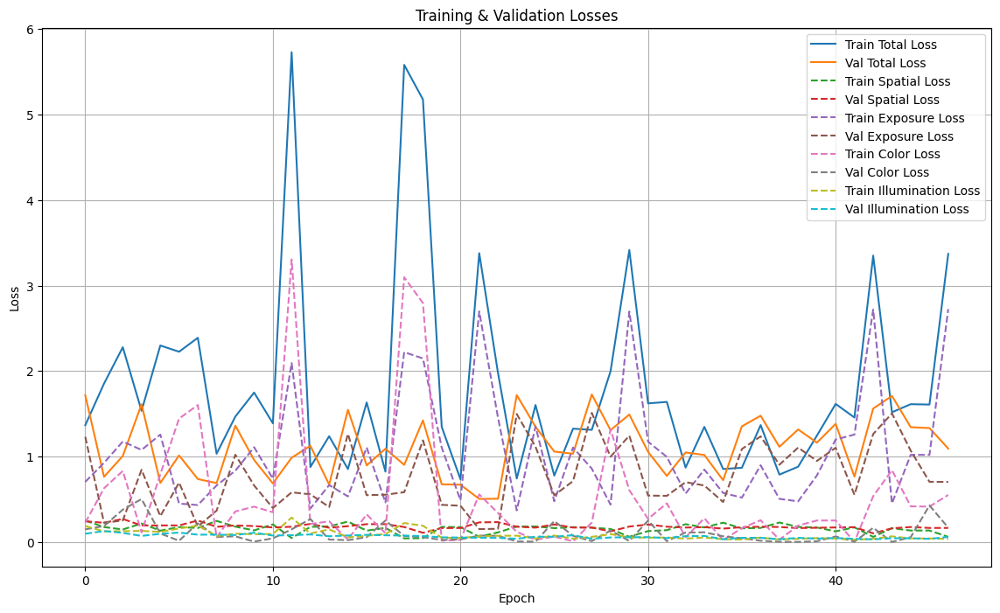

Saving model at epoch 47 to finetuned_models/zero_dce_finetune1007/epoch46...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch46\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch46\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 48
ETA: 3.91 min
Train Loss: 0.5088686943054199
  Spatial Consistency Loss: 0.21903719007968903
  Exposure Control Loss: 0.2567393481731415
  Color Constancy Loss: 0.010192876681685448
  Illumination Smoothness Loss: 0.02289927750825882
Validation Loss: 1.3191466331481934
  Spatial Consistency Loss: 0.16331864893436432
  Exposure Control Loss: 1.1078826189041138
  Color Constancy Loss: 0.004840883892029524
  Illumination Smoothness Loss: 0.04310452938079834



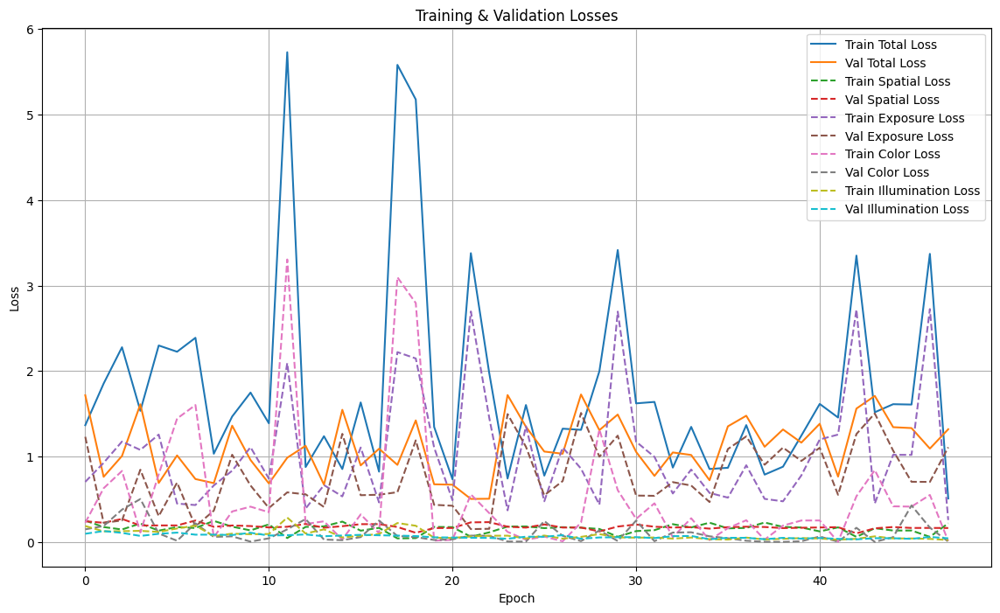

Saving model at epoch 48 to finetuned_models/zero_dce_finetune1007/epoch47...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch47\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch47\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.07s/steps]



Epoch: 49
ETA: 3.91 min
Train Loss: 1.3012653589248657
  Spatial Consistency Loss: 0.16254062950611115
  Exposure Control Loss: 0.8852965235710144
  Color Constancy Loss: 0.21154075860977173
  Illumination Smoothness Loss: 0.04188739135861397
Validation Loss: 1.3642747402191162
  Spatial Consistency Loss: 0.1217169463634491
  Exposure Control Loss: 0.9815508127212524
  Color Constancy Loss: 0.22991889715194702
  Illumination Smoothness Loss: 0.03108806535601616



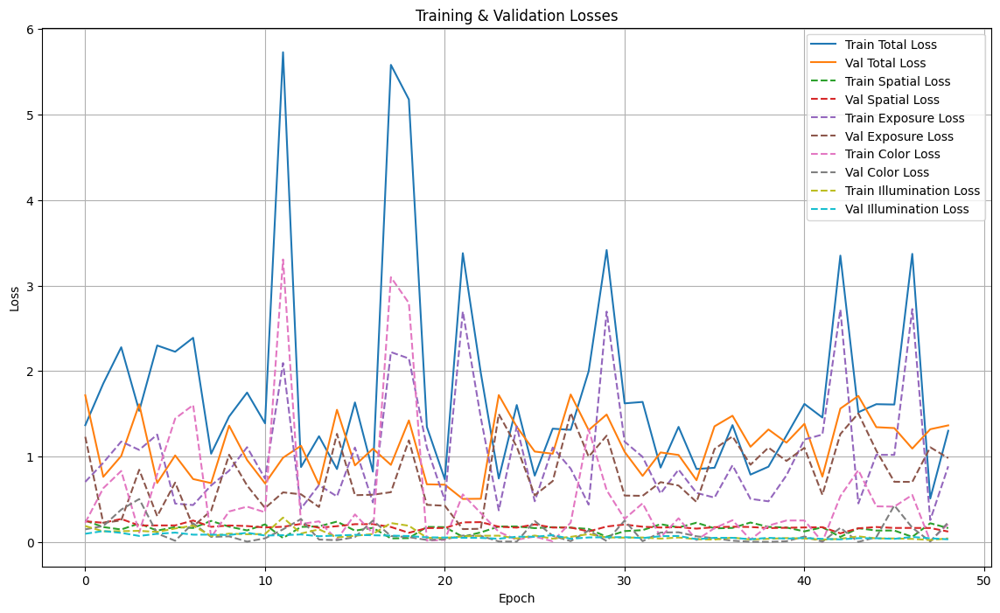

Saving model at epoch 49 to finetuned_models/zero_dce_finetune1007/epoch48...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch48\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch48\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 50
ETA: 3.85 min
Train Loss: 0.9456357955932617
  Spatial Consistency Loss: 0.17380619049072266
  Exposure Control Loss: 0.4865642189979553
  Color Constancy Loss: 0.2611332833766937
  Illumination Smoothness Loss: 0.02413216233253479
Validation Loss: 1.3375968933105469
  Spatial Consistency Loss: 0.17343033850193024
  Exposure Control Loss: 1.0622183084487915
  Color Constancy Loss: 0.05970035120844841
  Illumination Smoothness Loss: 0.042247846722602844



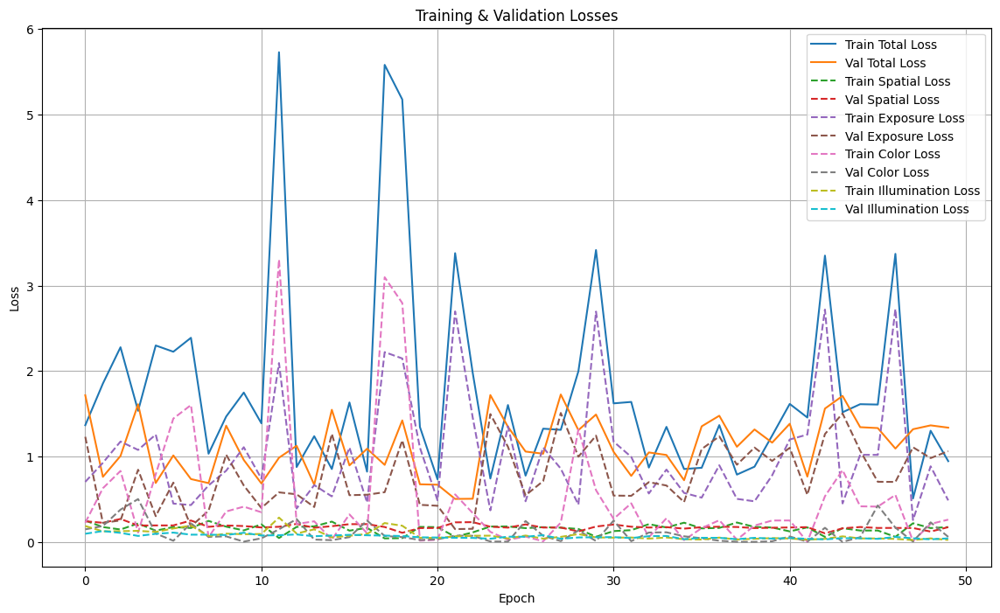

Saving model at epoch 50 to finetuned_models/zero_dce_finetune1007/epoch49...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch49\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch49\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.03steps/s]



Epoch: 51
ETA: 3.81 min
Train Loss: 0.7373136281967163
  Spatial Consistency Loss: 0.15571865439414978
  Exposure Control Loss: 0.4861082434654236
  Color Constancy Loss: 0.044279489666223526
  Illumination Smoothness Loss: 0.05120723694562912
Validation Loss: 0.8296697735786438
  Spatial Consistency Loss: 0.16357487440109253
  Exposure Control Loss: 0.6322582960128784
  Color Constancy Loss: 0.0033206769730895758
  Illumination Smoothness Loss: 0.030515890568494797



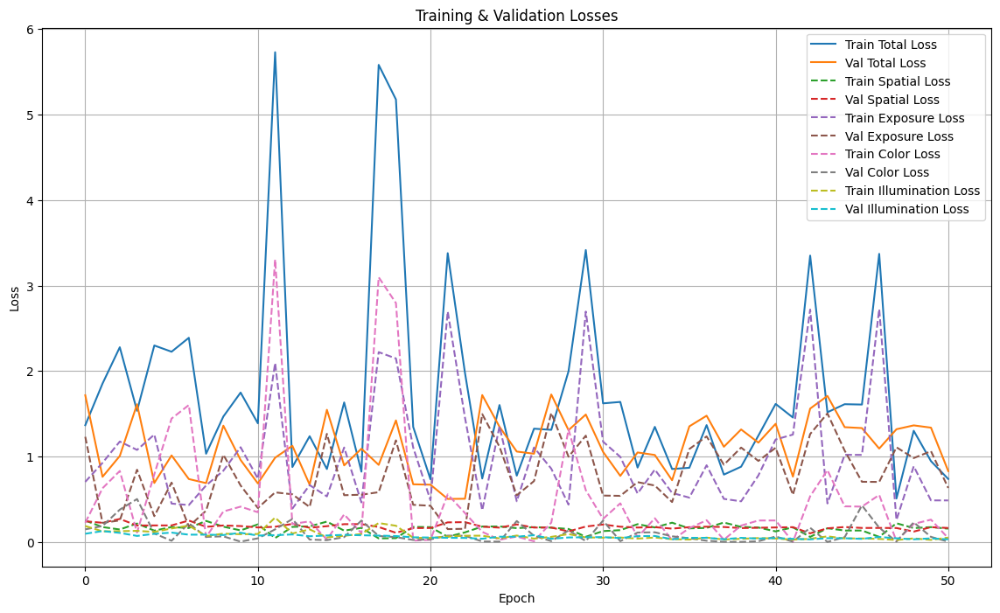

Saving model at epoch 51 to finetuned_models/zero_dce_finetune1007/epoch50...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch50\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch50\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 52
ETA: 3.99 min
Train Loss: 1.4918336868286133
  Spatial Consistency Loss: 0.17301413416862488
  Exposure Control Loss: 1.295624852180481
  Color Constancy Loss: 0.00010547778219915926
  Illumination Smoothness Loss: 0.023089207708835602
Validation Loss: 1.386820673942566
  Spatial Consistency Loss: 0.1722123622894287
  Exposure Control Loss: 1.1162223815917969
  Color Constancy Loss: 0.055433303117752075
  Illumination Smoothness Loss: 0.042952653020620346



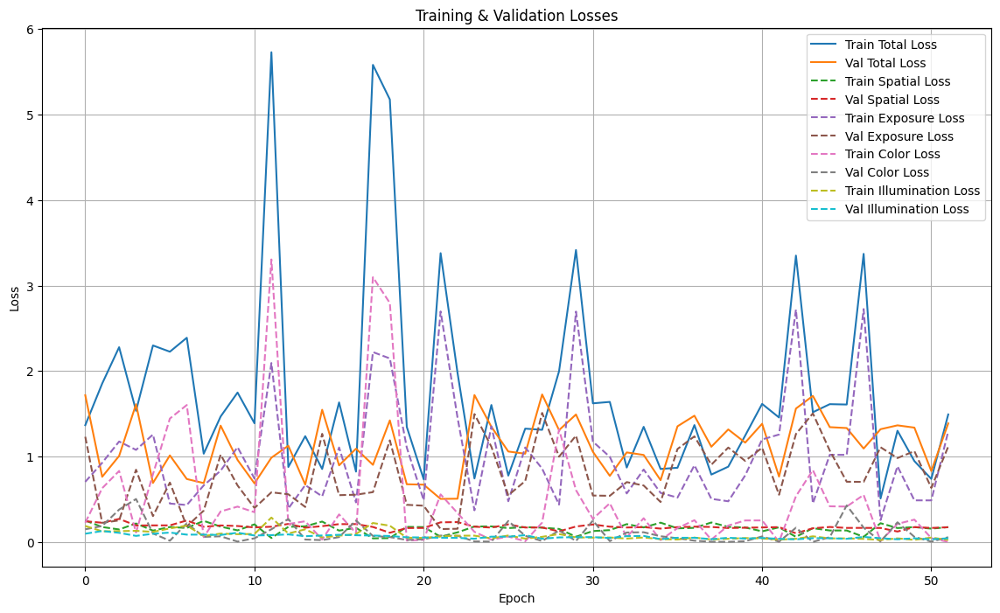

Saving model at epoch 52 to finetuned_models/zero_dce_finetune1007/epoch51...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch51\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch51\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 53
ETA: 3.91 min
Train Loss: 0.8109099864959717
  Spatial Consistency Loss: 0.14805370569229126
  Exposure Control Loss: 0.5611737370491028
  Color Constancy Loss: 0.05132392793893814
  Illumination Smoothness Loss: 0.050358615815639496
Validation Loss: 1.6884692907333374
  Spatial Consistency Loss: 0.1578609198331833
  Exposure Control Loss: 1.4907771348953247
  Color Constancy Loss: 0.0015501307789236307
  Illumination Smoothness Loss: 0.0382811464369297



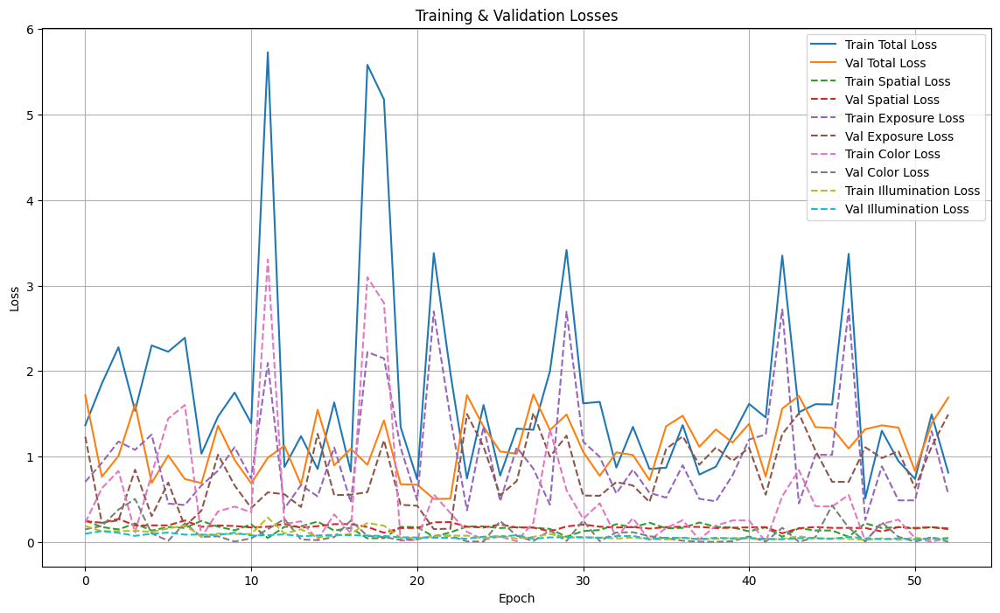

Saving model at epoch 53 to finetuned_models/zero_dce_finetune1007/epoch52...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch52\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch52\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 54
ETA: 3.96 min
Train Loss: 0.795141339302063
  Spatial Consistency Loss: 0.14689145982265472
  Exposure Control Loss: 0.5738341808319092
  Color Constancy Loss: 0.024980906397104263
  Illumination Smoothness Loss: 0.049434810876846313
Validation Loss: 1.4405317306518555
  Spatial Consistency Loss: 0.17330928146839142
  Exposure Control Loss: 1.2188977003097534
  Color Constancy Loss: 0.009538164362311363
  Illumination Smoothness Loss: 0.03878648951649666



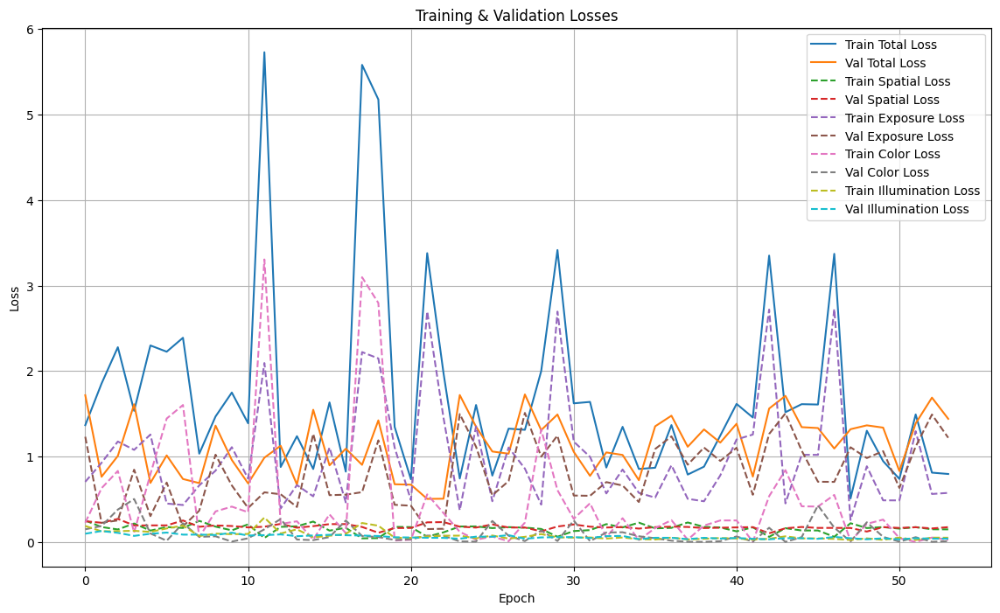

Saving model at epoch 54 to finetuned_models/zero_dce_finetune1007/epoch53...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch53\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch53\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.00steps/s]



Epoch: 55
ETA: 3.91 min
Train Loss: 0.7058037519454956
  Spatial Consistency Loss: 0.15798550844192505
  Exposure Control Loss: 0.46183037757873535
  Color Constancy Loss: 0.03728504478931427
  Illumination Smoothness Loss: 0.04870282858610153
Validation Loss: 0.5112506747245789
  Spatial Consistency Loss: 0.20790646970272064
  Exposure Control Loss: 0.1909346878528595
  Color Constancy Loss: 0.08592631667852402
  Illumination Smoothness Loss: 0.026483187451958656



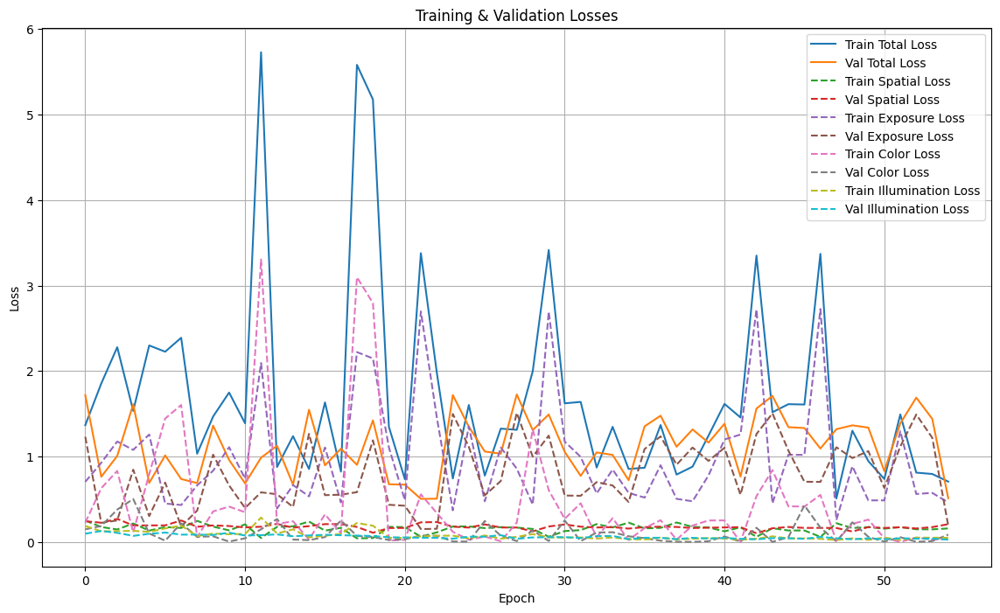

Saving model at epoch 55 to finetuned_models/zero_dce_finetune1007/epoch54...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch54\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch54\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 56
ETA: 3.87 min
Train Loss: 0.7921507358551025
  Spatial Consistency Loss: 0.14971107244491577
  Exposure Control Loss: 0.5380451083183289
  Color Constancy Loss: 0.05291791260242462
  Illumination Smoothness Loss: 0.051476627588272095
Validation Loss: 1.0696685314178467
  Spatial Consistency Loss: 0.15568876266479492
  Exposure Control Loss: 0.8676272034645081
  Color Constancy Loss: 0.021301116794347763
  Illumination Smoothness Loss: 0.025051433593034744



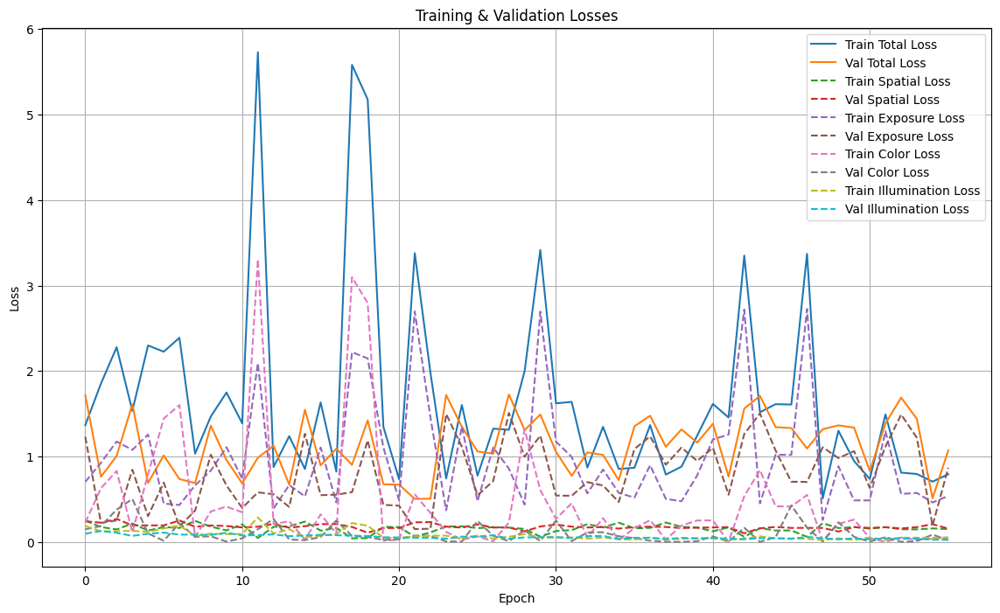

Saving model at epoch 56 to finetuned_models/zero_dce_finetune1007/epoch55...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch55\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch55\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 57
ETA: 3.97 min
Train Loss: 1.8527439832687378
  Spatial Consistency Loss: 0.10342667251825333
  Exposure Control Loss: 1.5498301982879639
  Color Constancy Loss: 0.15406520664691925
  Illumination Smoothness Loss: 0.04542181268334389
Validation Loss: 1.579977035522461
  Spatial Consistency Loss: 0.10119112581014633
  Exposure Control Loss: 1.2568962574005127
  Color Constancy Loss: 0.19757507741451263
  Illumination Smoothness Loss: 0.024314487352967262



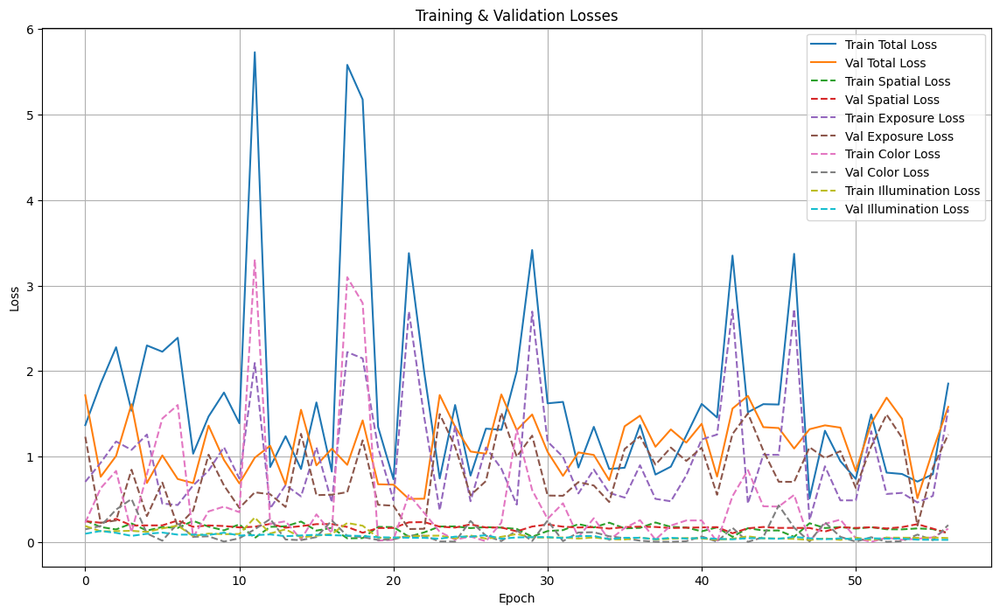

Saving model at epoch 57 to finetuned_models/zero_dce_finetune1007/epoch56...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch56\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch56\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 58
ETA: 3.88 min
Train Loss: 2.9166572093963623
  Spatial Consistency Loss: 0.07262721657752991
  Exposure Control Loss: 2.1730527877807617
  Color Constancy Loss: 0.6432428956031799
  Illumination Smoothness Loss: 0.027734221890568733
Validation Loss: 1.0685346126556396
  Spatial Consistency Loss: 0.15634407103061676
  Exposure Control Loss: 0.8686968684196472
  Color Constancy Loss: 0.020033007487654686
  Illumination Smoothness Loss: 0.02346058376133442



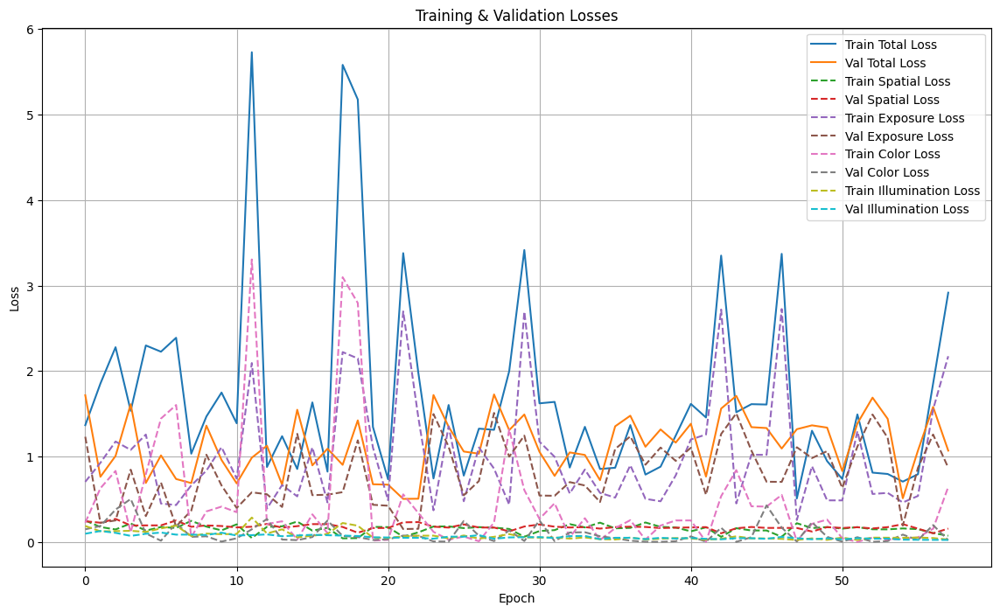

Saving model at epoch 58 to finetuned_models/zero_dce_finetune1007/epoch57...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch57\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch57\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 59
ETA: 3.84 min
Train Loss: 0.6401950716972351
  Spatial Consistency Loss: 0.16591589152812958
  Exposure Control Loss: 0.40647387504577637
  Color Constancy Loss: 0.02103898487985134
  Illumination Smoothness Loss: 0.04676628112792969
Validation Loss: 1.1126656532287598
  Spatial Consistency Loss: 0.1730966567993164
  Exposure Control Loss: 0.9007086753845215
  Color Constancy Loss: 0.014177109114825726
  Illumination Smoothness Loss: 0.024683255702257156



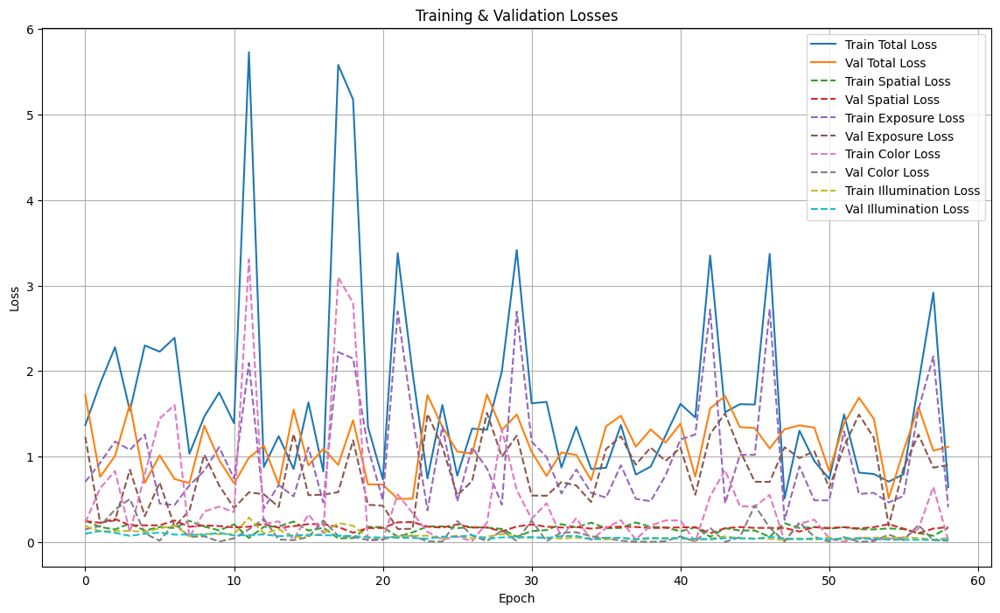

Saving model at epoch 59 to finetuned_models/zero_dce_finetune1007/epoch58...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch58\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch58\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 60
ETA: 3.84 min
Train Loss: 1.3940180540084839
  Spatial Consistency Loss: 0.1630554050207138
  Exposure Control Loss: 0.9057533740997314
  Color Constancy Loss: 0.2855544984340668
  Illumination Smoothness Loss: 0.03965476155281067
Validation Loss: 0.45143646001815796
  Spatial Consistency Loss: 0.21802838146686554
  Exposure Control Loss: 0.1382209062576294
  Color Constancy Loss: 0.0720968097448349
  Illumination Smoothness Loss: 0.02309037186205387



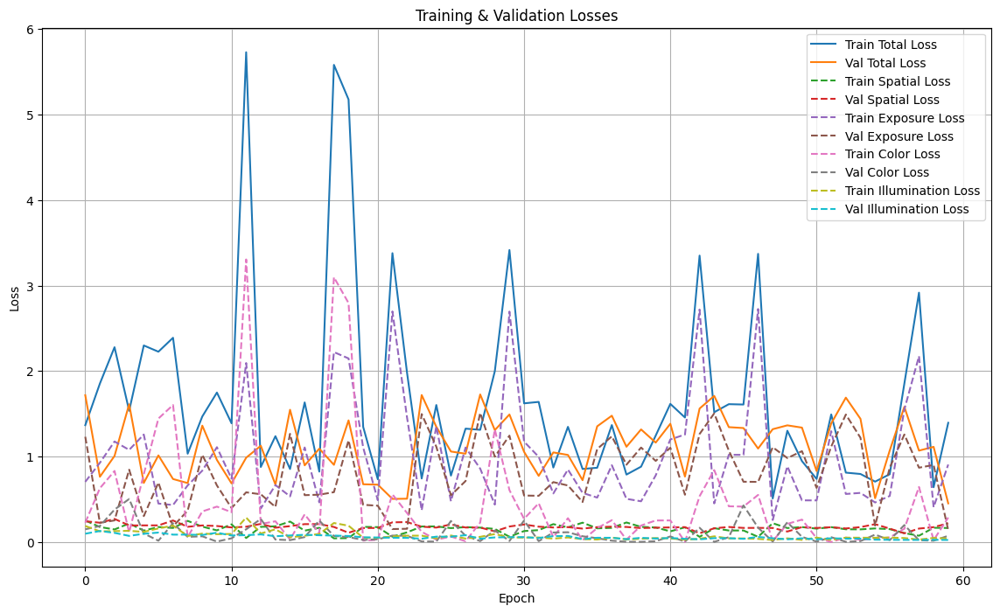

Saving model at epoch 60 to finetuned_models/zero_dce_finetune1007/epoch59...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch59\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch59\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.07s/steps]



Epoch: 61
ETA: 4.12 min
Train Loss: 1.7007412910461426
  Spatial Consistency Loss: 0.10673429071903229
  Exposure Control Loss: 1.4349688291549683
  Color Constancy Loss: 0.11624160408973694
  Illumination Smoothness Loss: 0.04279656708240509
Validation Loss: 0.8358269333839417
  Spatial Consistency Loss: 0.16177067160606384
  Exposure Control Loss: 0.6405479311943054
  Color Constancy Loss: 0.0067936694249510765
  Illumination Smoothness Loss: 0.026714708656072617



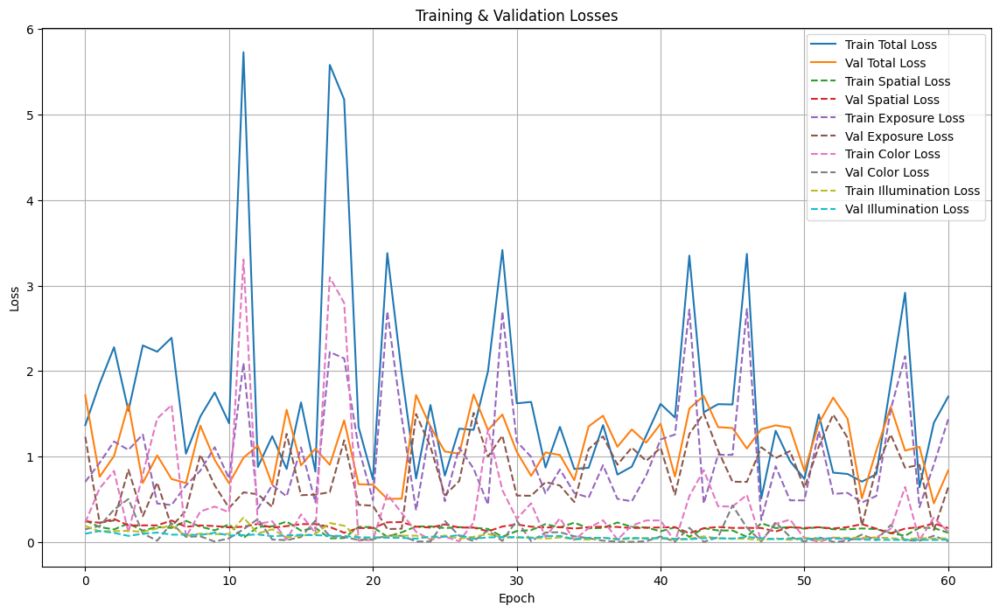

Saving model at epoch 61 to finetuned_models/zero_dce_finetune1007/epoch60...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch60\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch60\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 62
ETA: 3.91 min
Train Loss: 0.9026355743408203
  Spatial Consistency Loss: 0.22037814557552338
  Exposure Control Loss: 0.5914627909660339
  Color Constancy Loss: 0.06813938915729523
  Illumination Smoothness Loss: 0.022655244916677475
Validation Loss: 0.8395429849624634
  Spatial Consistency Loss: 0.1627831757068634
  Exposure Control Loss: 0.6415096521377563
  Color Constancy Loss: 0.00762106804177165
  Illumination Smoothness Loss: 0.02762911096215248



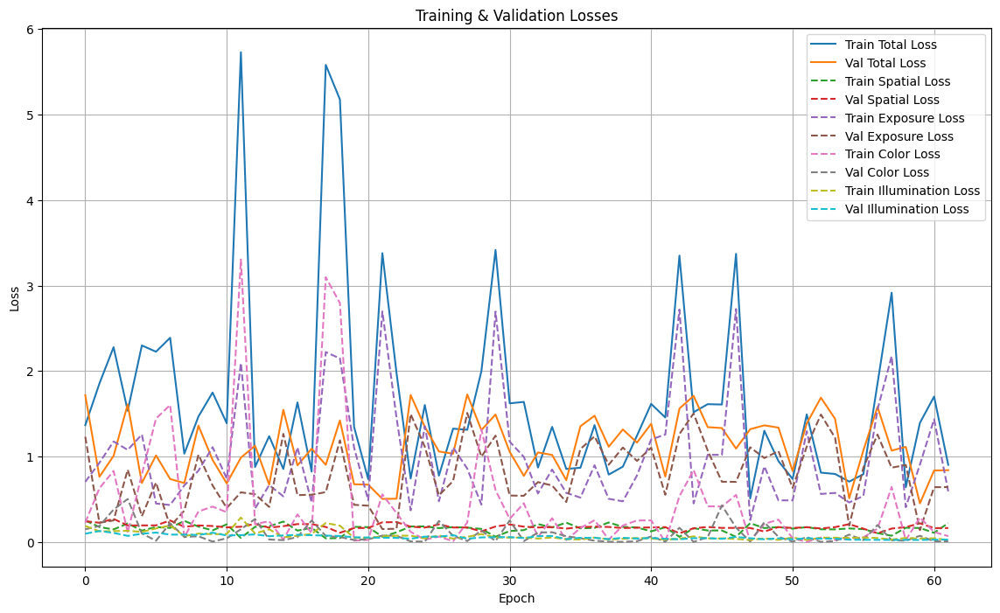

Saving model at epoch 62 to finetuned_models/zero_dce_finetune1007/epoch61...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch61\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch61\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 63
ETA: 3.86 min
Train Loss: 0.6652365922927856
  Spatial Consistency Loss: 0.16140121221542358
  Exposure Control Loss: 0.4313100576400757
  Color Constancy Loss: 0.02495005540549755
  Illumination Smoothness Loss: 0.04757530987262726
Validation Loss: 1.4005844593048096
  Spatial Consistency Loss: 0.11975447088479996
  Exposure Control Loss: 0.9984678626060486
  Color Constancy Loss: 0.25809526443481445
  Illumination Smoothness Loss: 0.024266863241791725



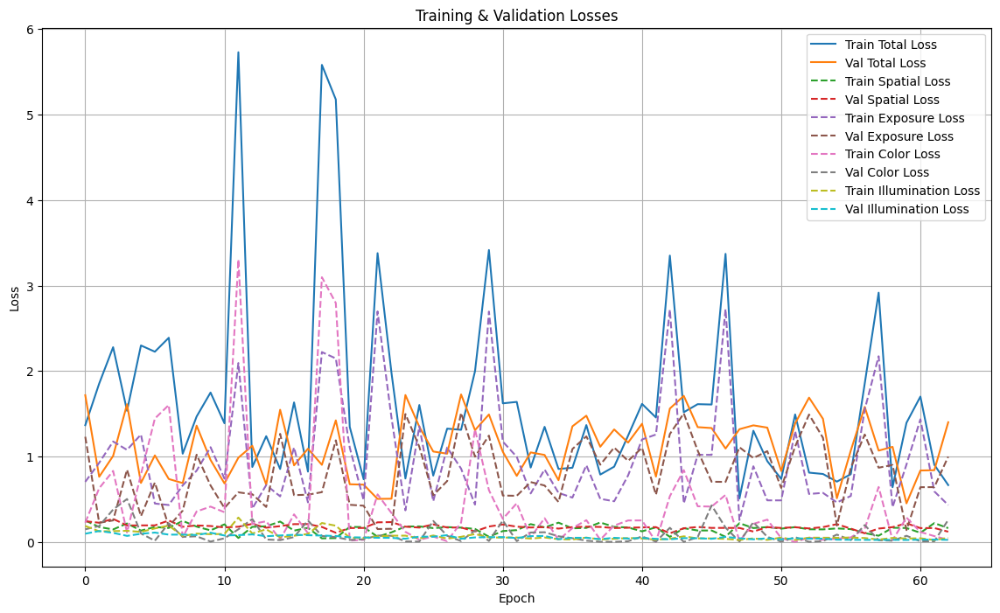

Saving model at epoch 63 to finetuned_models/zero_dce_finetune1007/epoch62...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch62\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch62\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]


Epoch: 64
ETA: 3.81 min
Train Loss: 1.6160829067230225
  Spatial Consistency Loss: 0.12259864807128906
  Exposure Control Loss: 1.2293676137924194
  Color Constancy Loss: 0.23273488879203796
  Illumination Smoothness Loss: 0.03138167783617973
Validation Loss: 1.303331732749939
  Spatial Consistency Loss: 0.1593429446220398
  Exposure Control Loss: 1.1002006530761719
  Color Constancy Loss: 0.00922326184809208
  Illumination Smoothness Loss: 0.03456490859389305



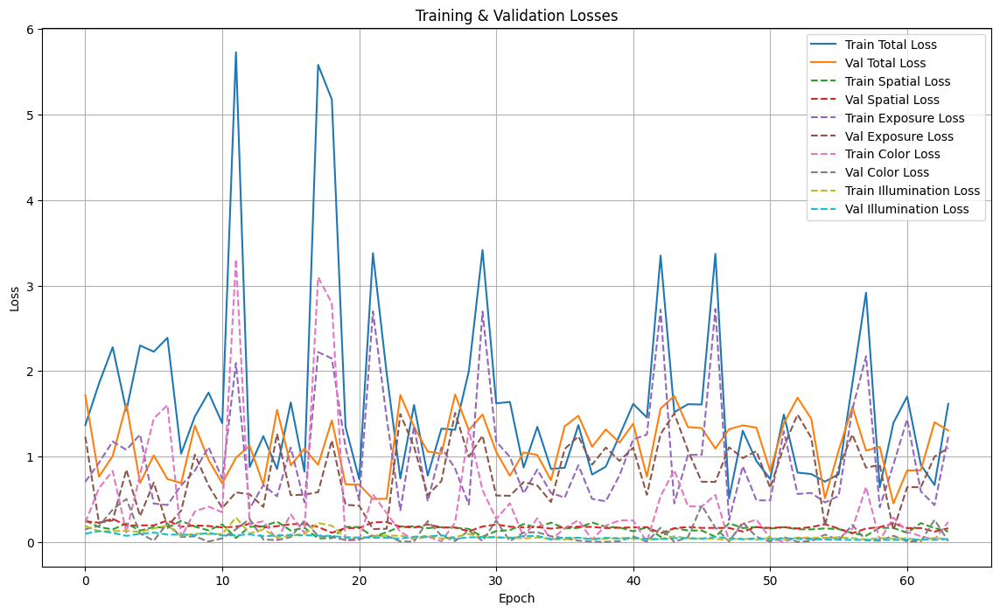

Saving model at epoch 64 to finetuned_models/zero_dce_finetune1007/epoch63...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch63\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch63\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.03steps/s]



Epoch: 65
ETA: 3.77 min
Train Loss: 0.939835250377655
  Spatial Consistency Loss: 0.17469726502895355
  Exposure Control Loss: 0.4510060250759125
  Color Constancy Loss: 0.28840112686157227
  Illumination Smoothness Loss: 0.025730863213539124
Validation Loss: 1.3816686868667603
  Spatial Consistency Loss: 0.17067831754684448
  Exposure Control Loss: 1.109040379524231
  Color Constancy Loss: 0.06312604248523712
  Illumination Smoothness Loss: 0.03882398083806038



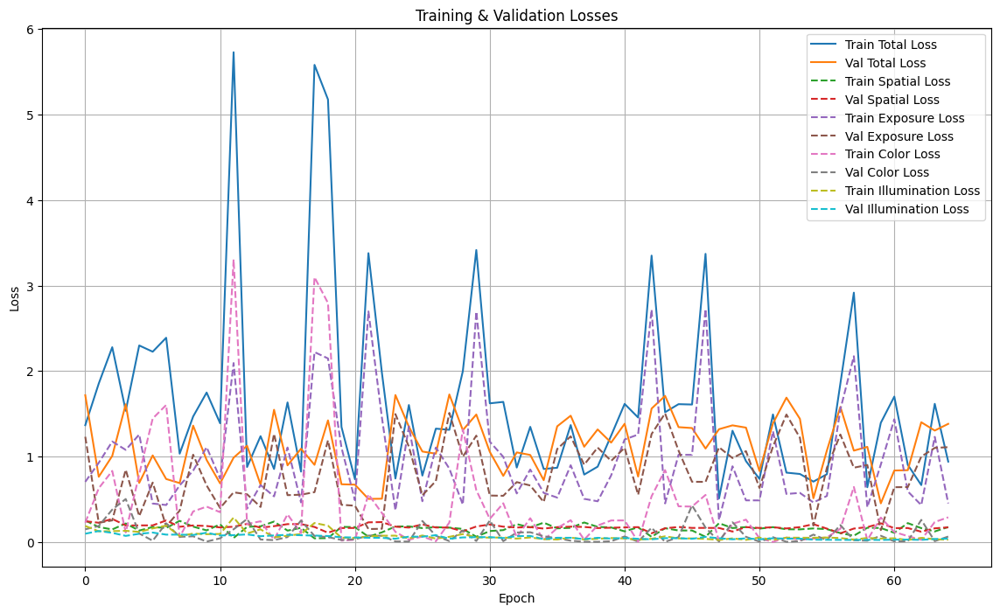

Saving model at epoch 65 to finetuned_models/zero_dce_finetune1007/epoch64...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch64\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch64\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 66
ETA: 3.77 min
Train Loss: 1.3649756908416748
  Spatial Consistency Loss: 0.16361235082149506
  Exposure Control Loss: 0.8397814631462097
  Color Constancy Loss: 0.3254550099372864
  Illumination Smoothness Loss: 0.03612688556313515
Validation Loss: 0.7991304993629456
  Spatial Consistency Loss: 0.15136855840682983
  Exposure Control Loss: 0.48579397797584534
  Color Constancy Loss: 0.14315055310726166
  Illumination Smoothness Loss: 0.018817374482750893



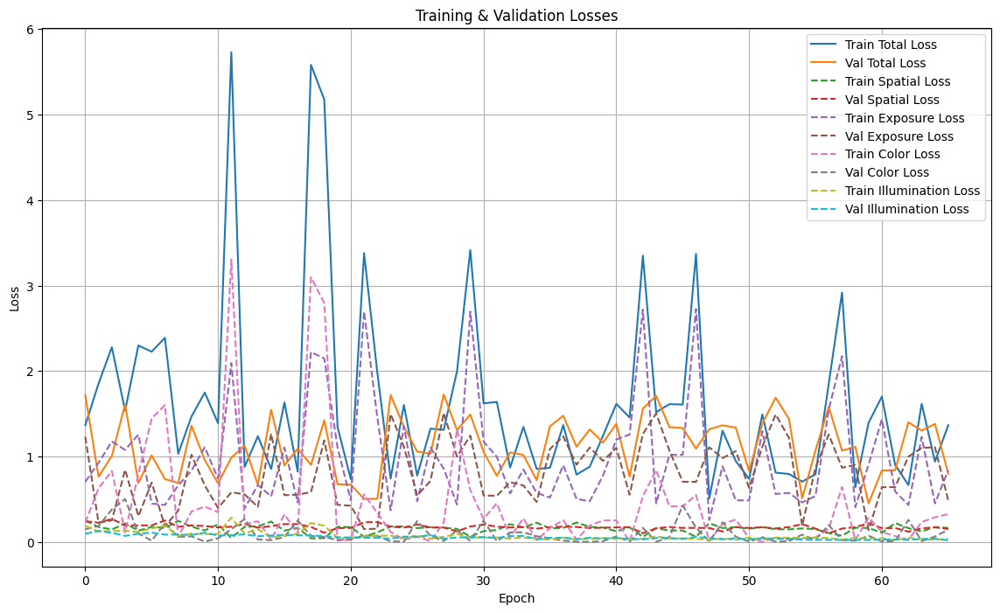

Saving model at epoch 66 to finetuned_models/zero_dce_finetune1007/epoch65...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch65\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch65\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.00steps/s]



Epoch: 67
ETA: 3.75 min
Train Loss: 0.7576076984405518
  Spatial Consistency Loss: 0.22096103429794312
  Exposure Control Loss: 0.4770159423351288
  Color Constancy Loss: 0.0386907197535038
  Illumination Smoothness Loss: 0.02094000205397606
Validation Loss: 1.4057068824768066
  Spatial Consistency Loss: 0.11924091726541519
  Exposure Control Loss: 1.0024843215942383
  Color Constancy Loss: 0.26021233201026917
  Illumination Smoothness Loss: 0.023769386112689972



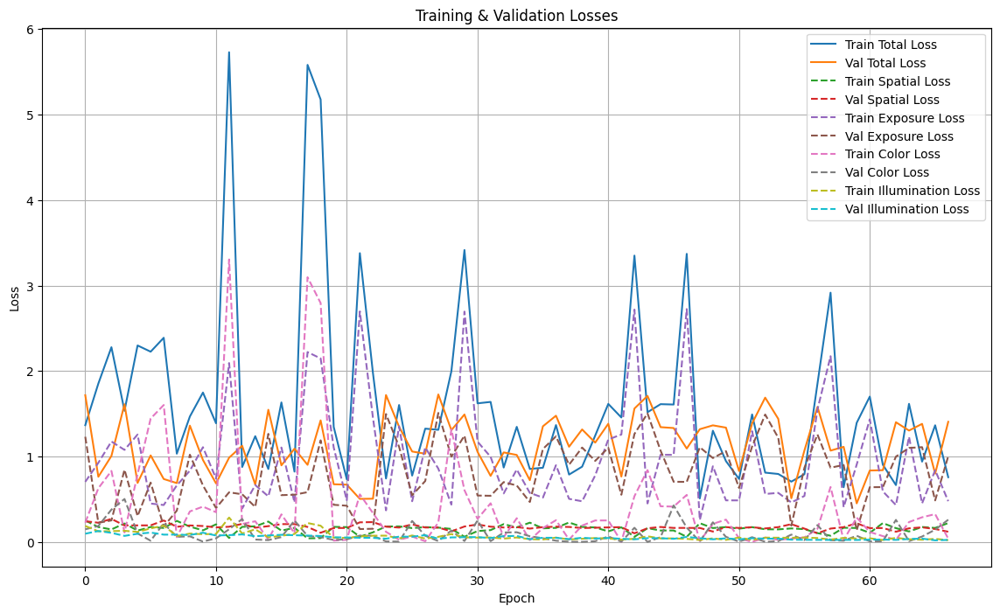

Saving model at epoch 67 to finetuned_models/zero_dce_finetune1007/epoch66...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch66\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch66\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.04steps/s]



Epoch: 68
ETA: 3.69 min
Train Loss: 1.6889142990112305
  Spatial Consistency Loss: 0.12646524608135223
  Exposure Control Loss: 1.0580679178237915
  Color Constancy Loss: 0.47097060084342957
  Illumination Smoothness Loss: 0.03341059759259224
Validation Loss: 1.228230357170105
  Spatial Consistency Loss: 0.1717827171087265
  Exposure Control Loss: 0.9524700045585632
  Color Constancy Loss: 0.07023631781339645
  Illumination Smoothness Loss: 0.033741407096385956



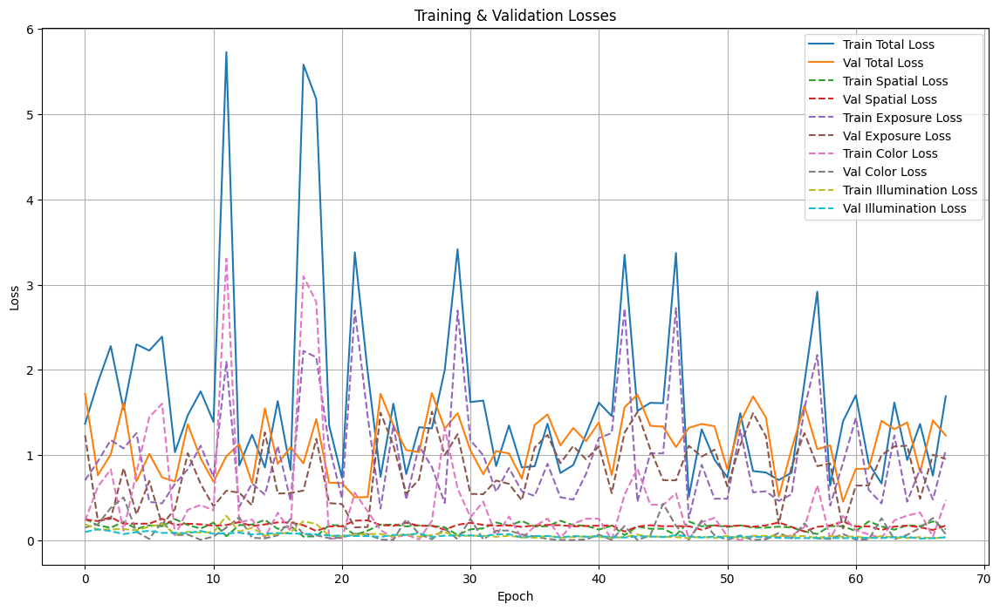

Saving model at epoch 68 to finetuned_models/zero_dce_finetune1007/epoch67...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch67\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch67\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.05s/steps]



Epoch: 69
ETA: 3.89 min
Train Loss: 0.6607491970062256
  Spatial Consistency Loss: 0.19738349318504333
  Exposure Control Loss: 0.40558475255966187
  Color Constancy Loss: 0.03722202405333519
  Illumination Smoothness Loss: 0.020558971911668777
Validation Loss: 1.3738235235214233
  Spatial Consistency Loss: 0.16949759423732758
  Exposure Control Loss: 1.1057182550430298
  Color Constancy Loss: 0.06438487023115158
  Illumination Smoothness Loss: 0.034222885966300964



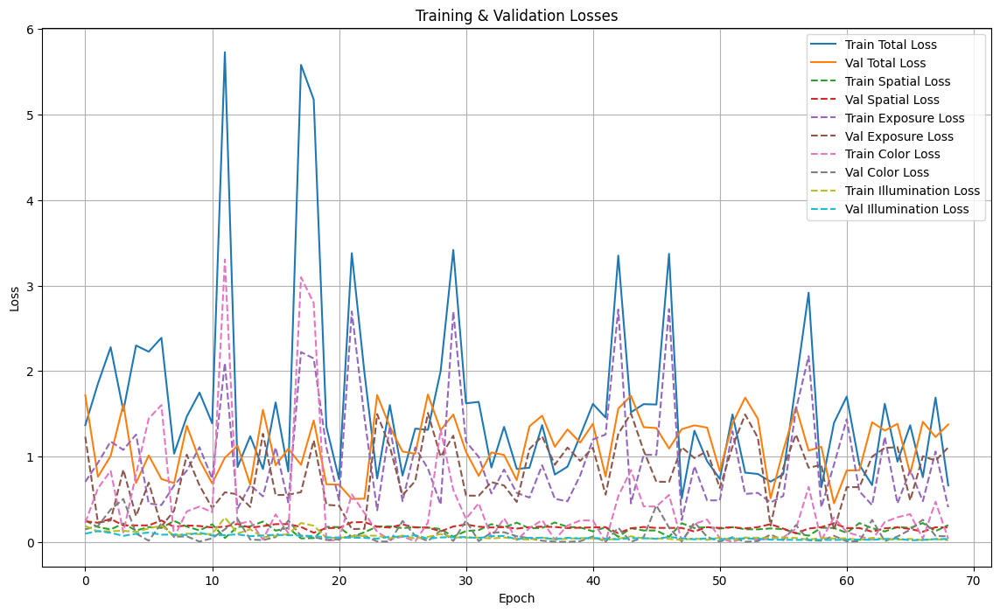

Saving model at epoch 69 to finetuned_models/zero_dce_finetune1007/epoch68...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch68\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch68\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 70
ETA: 3.87 min
Train Loss: 1.4964475631713867
  Spatial Consistency Loss: 0.1716696172952652
  Exposure Control Loss: 1.2887904644012451
  Color Constancy Loss: 0.014325999654829502
  Illumination Smoothness Loss: 0.021661482751369476
Validation Loss: 1.3312803506851196
  Spatial Consistency Loss: 0.16647717356681824
  Exposure Control Loss: 1.0598424673080444
  Color Constancy Loss: 0.0692787691950798
  Illumination Smoothness Loss: 0.03568192571401596



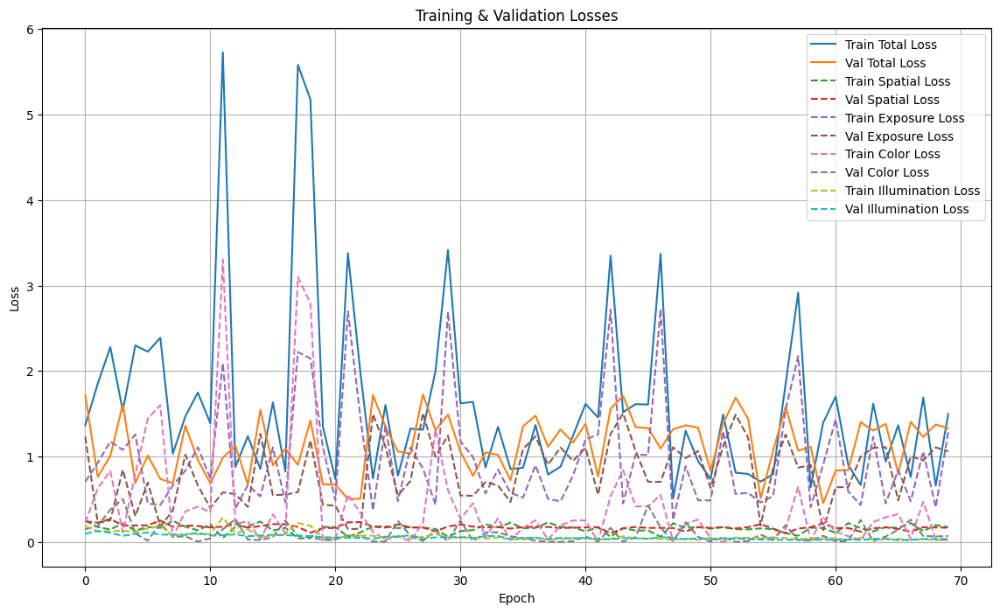

Saving model at epoch 70 to finetuned_models/zero_dce_finetune1007/epoch69...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch69\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch69\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 71
ETA: 3.82 min
Train Loss: 1.6841702461242676
  Spatial Consistency Loss: 0.12623125314712524
  Exposure Control Loss: 1.0624431371688843
  Color Constancy Loss: 0.4643634557723999
  Illumination Smoothness Loss: 0.031132344156503677
Validation Loss: 1.6625609397888184
  Spatial Consistency Loss: 0.1605714112520218
  Exposure Control Loss: 1.4521162509918213
  Color Constancy Loss: 0.027515258640050888
  Illumination Smoothness Loss: 0.022357920184731483



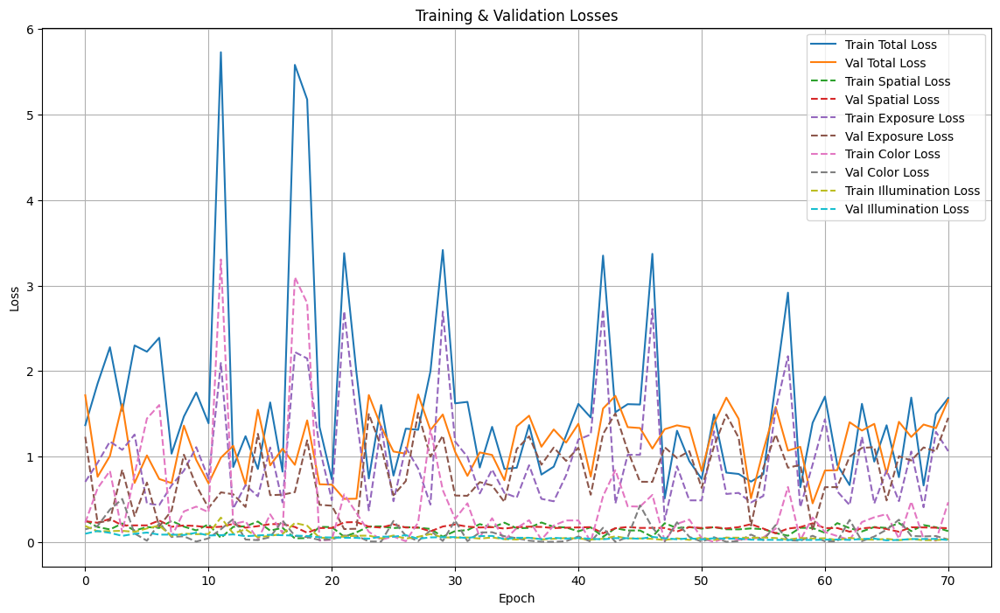

Saving model at epoch 71 to finetuned_models/zero_dce_finetune1007/epoch70...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch70\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch70\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 72
ETA: 3.79 min
Train Loss: 3.2952091693878174
  Spatial Consistency Loss: 0.06294737756252289
  Exposure Control Loss: 2.5146291255950928
  Color Constancy Loss: 0.692496657371521
  Illumination Smoothness Loss: 0.025136157870292664
Validation Loss: 1.420423984527588
  Spatial Consistency Loss: 0.11806321144104004
  Exposure Control Loss: 1.0142980813980103
  Color Constancy Loss: 0.26664507389068604
  Illumination Smoothness Loss: 0.021417615935206413



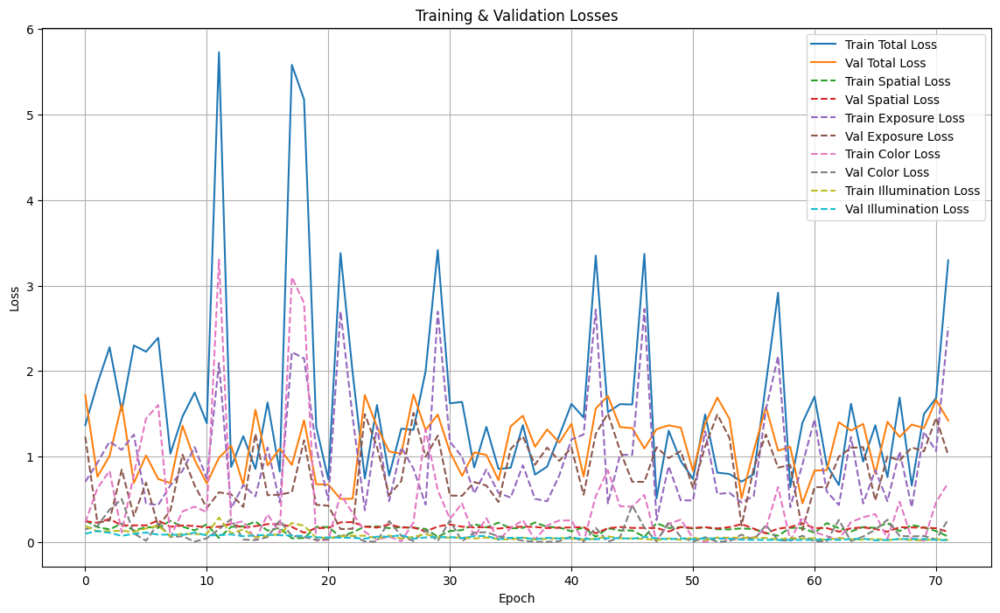

Saving model at epoch 72 to finetuned_models/zero_dce_finetune1007/epoch71...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch71\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch71\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.04steps/s]



Epoch: 73
ETA: 3.76 min
Train Loss: 1.3756343126296997
  Spatial Consistency Loss: 0.1619347780942917
  Exposure Control Loss: 0.5361526012420654
  Color Constancy Loss: 0.6326877474784851
  Illumination Smoothness Loss: 0.0448591373860836
Validation Loss: 0.8302736282348633
  Spatial Consistency Loss: 0.16093792021274567
  Exposure Control Loss: 0.640864908695221
  Color Constancy Loss: 0.004266202915459871
  Illumination Smoothness Loss: 0.024204598739743233



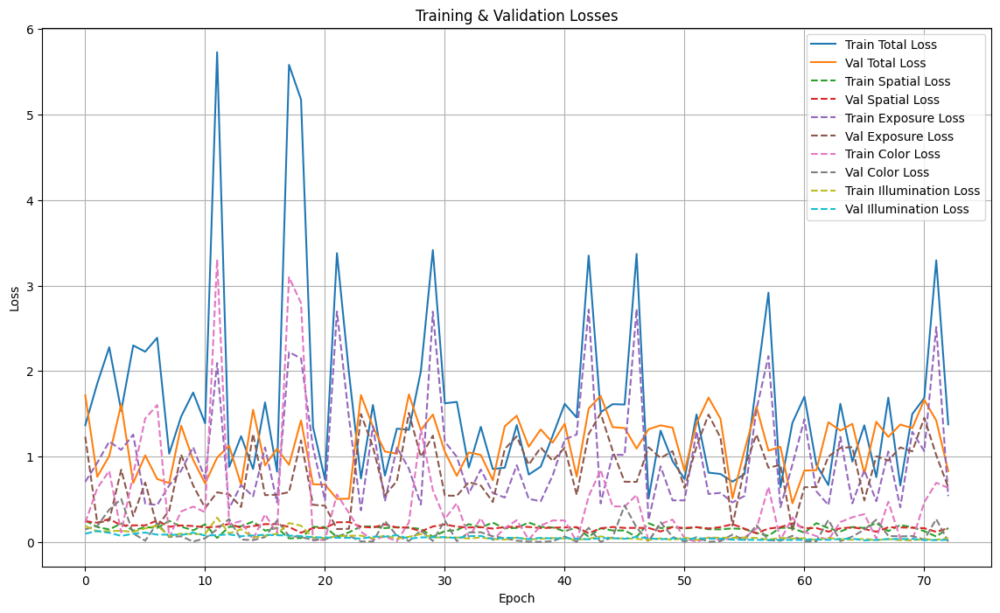

Saving model at epoch 73 to finetuned_models/zero_dce_finetune1007/epoch72...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch72\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch72\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.03steps/s]



Epoch: 74
ETA: 3.79 min
Train Loss: 0.8517441749572754
  Spatial Consistency Loss: 0.20780788362026215
  Exposure Control Loss: 0.5835670232772827
  Color Constancy Loss: 0.03550880402326584
  Illumination Smoothness Loss: 0.024860454723238945
Validation Loss: 1.0940754413604736
  Spatial Consistency Loss: 0.15264303982257843
  Exposure Control Loss: 0.8791462182998657
  Color Constancy Loss: 0.04101000353693962
  Illumination Smoothness Loss: 0.021276069805026054



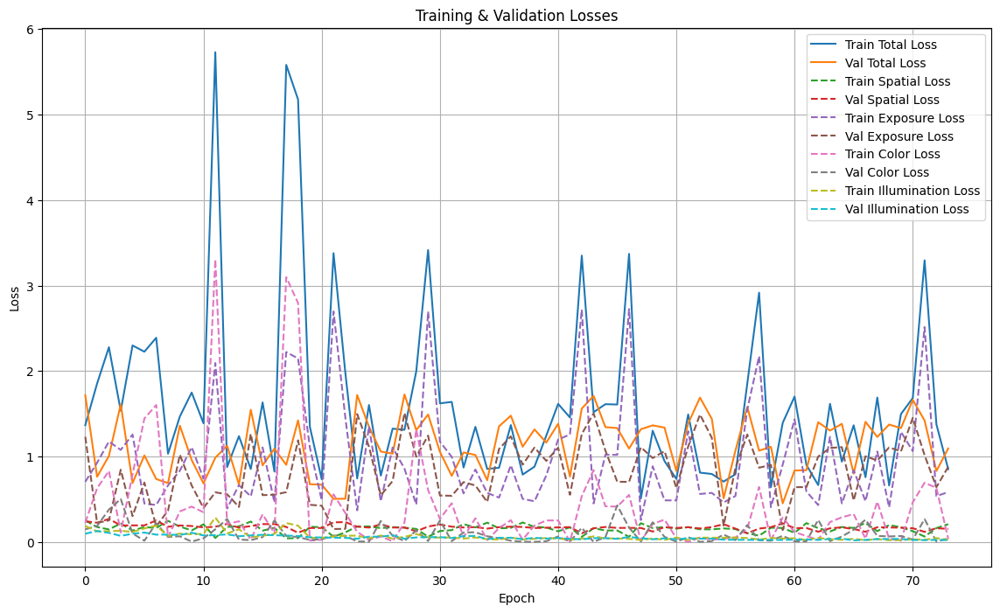

Saving model at epoch 74 to finetuned_models/zero_dce_finetune1007/epoch73...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch73\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch73\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 75
ETA: 3.75 min
Train Loss: 5.111963272094727
  Spatial Consistency Loss: 0.032577577978372574
  Exposure Control Loss: 2.5334527492523193
  Color Constancy Loss: 2.4971673488616943
  Illumination Smoothness Loss: 0.04876547306776047
Validation Loss: 1.4754472970962524
  Spatial Consistency Loss: 0.11383955925703049
  Exposure Control Loss: 1.0621473789215088
  Color Constancy Loss: 0.27834028005599976
  Illumination Smoothness Loss: 0.021120164543390274



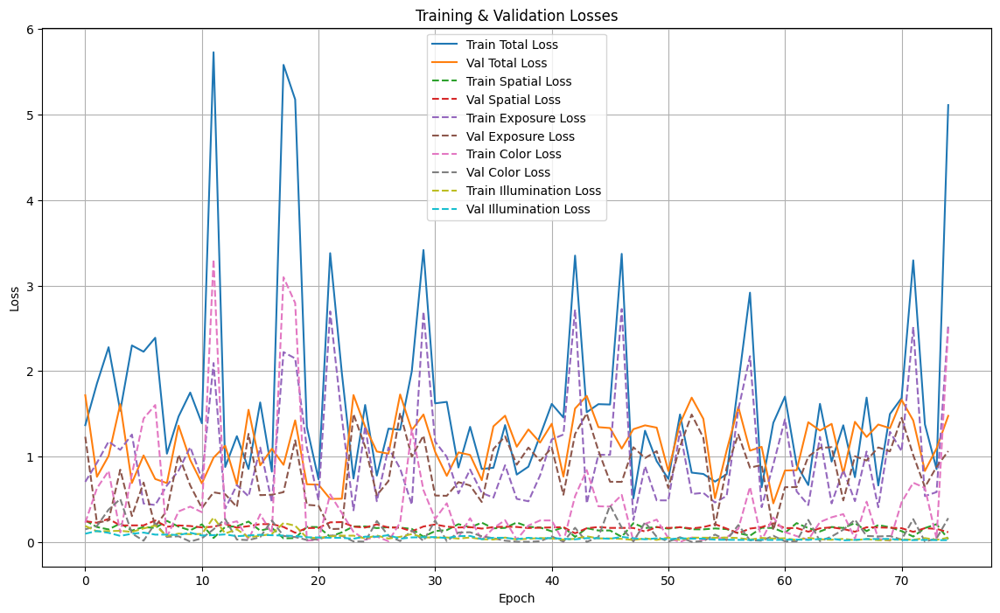

Saving model at epoch 75 to finetuned_models/zero_dce_finetune1007/epoch74...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch74\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch74\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 76
ETA: 3.7 min
Train Loss: 3.335836887359619
  Spatial Consistency Loss: 0.061726100742816925
  Exposure Control Loss: 2.567176580429077
  Color Constancy Loss: 0.6821370124816895
  Illumination Smoothness Loss: 0.024797264486551285
Validation Loss: 0.8145102262496948
  Spatial Consistency Loss: 0.14815592765808105
  Exposure Control Loss: 0.5106359720230103
  Color Constancy Loss: 0.13890796899795532
  Illumination Smoothness Loss: 0.016810337081551552



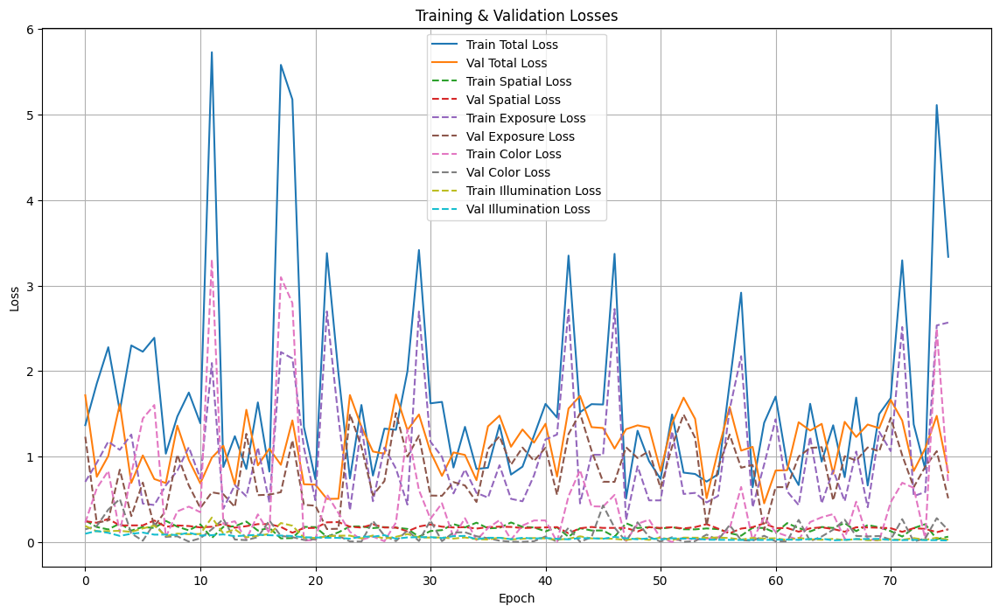

Saving model at epoch 76 to finetuned_models/zero_dce_finetune1007/epoch75...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch75\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch75\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 77
ETA: 3.73 min
Train Loss: 1.4196645021438599
  Spatial Consistency Loss: 0.16693729162216187
  Exposure Control Loss: 1.2316522598266602
  Color Constancy Loss: 0.0013766572810709476
  Illumination Smoothness Loss: 0.019698306918144226
Validation Loss: 0.8418142199516296
  Spatial Consistency Loss: 0.1599164754152298
  Exposure Control Loss: 0.648232102394104
  Color Constancy Loss: 0.006183559074997902
  Illumination Smoothness Loss: 0.027482077479362488



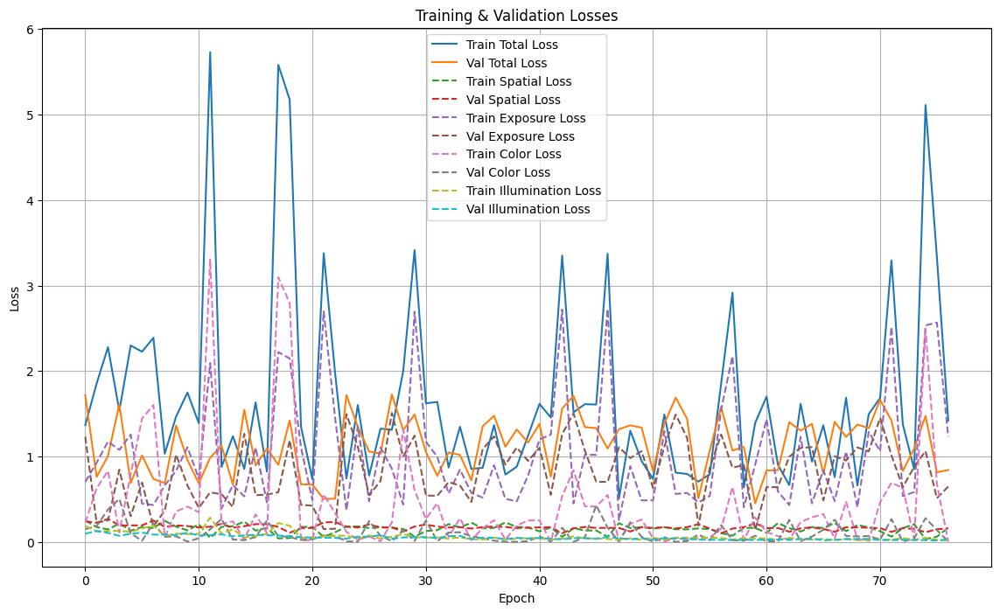

Saving model at epoch 77 to finetuned_models/zero_dce_finetune1007/epoch76...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch76\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch76\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 78
ETA: 3.96 min
Train Loss: 1.6050008535385132
  Spatial Consistency Loss: 0.10887765884399414
  Exposure Control Loss: 1.375037431716919
  Color Constancy Loss: 0.0851363092660904
  Illumination Smoothness Loss: 0.035949476063251495
Validation Loss: 1.0604605674743652
  Spatial Consistency Loss: 0.15197999775409698
  Exposure Control Loss: 0.874008297920227
  Color Constancy Loss: 0.014786023646593094
  Illumination Smoothness Loss: 0.019686197862029076



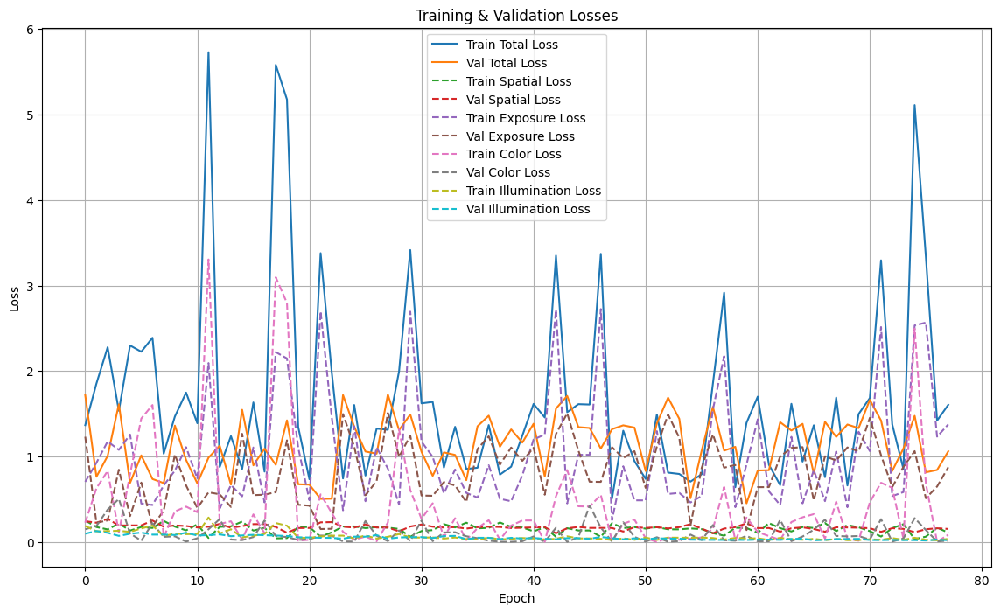

Saving model at epoch 78 to finetuned_models/zero_dce_finetune1007/epoch77...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch77\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch77\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 79
ETA: 3.88 min
Train Loss: 4.831881523132324
  Spatial Consistency Loss: 0.036619480699300766
  Exposure Control Loss: 2.3775601387023926
  Color Constancy Loss: 2.3718278408050537
  Illumination Smoothness Loss: 0.045874081552028656
Validation Loss: 1.420018196105957
  Spatial Consistency Loss: 0.11922071874141693
  Exposure Control Loss: 1.003151774406433
  Color Constancy Loss: 0.277909517288208
  Illumination Smoothness Loss: 0.019736185669898987



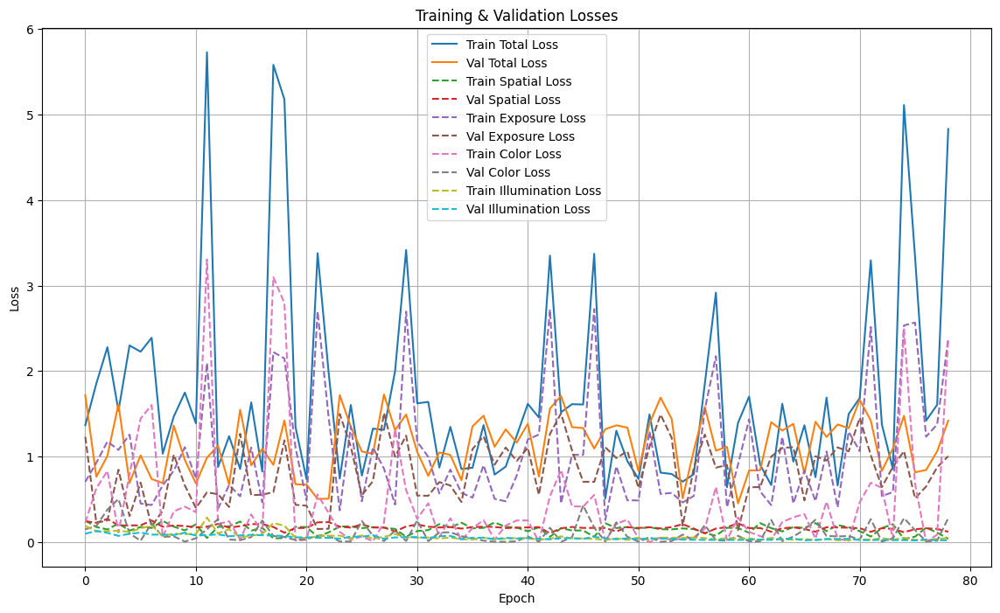

Saving model at epoch 79 to finetuned_models/zero_dce_finetune1007/epoch78...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch78\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch78\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 80
ETA: 3.84 min
Train Loss: 0.6599307060241699
  Spatial Consistency Loss: 0.16140390932559967
  Exposure Control Loss: 0.43332967162132263
  Color Constancy Loss: 0.02460625022649765
  Illumination Smoothness Loss: 0.04059089720249176
Validation Loss: 1.1875898838043213
  Spatial Consistency Loss: 0.15303434431552887
  Exposure Control Loss: 0.8233516216278076
  Color Constancy Loss: 0.16577336192131042
  Illumination Smoothness Loss: 0.045430511236190796



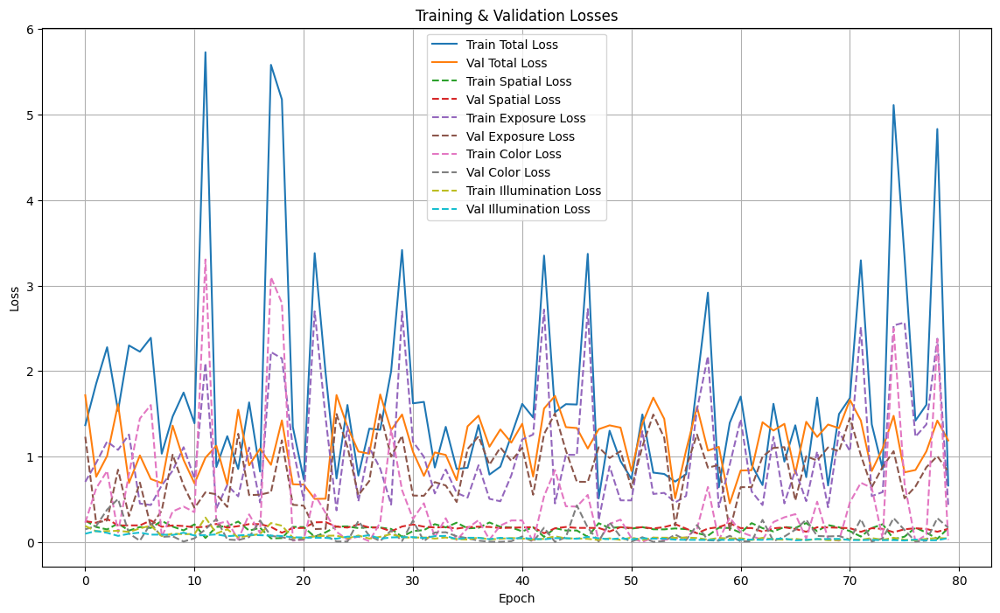

Saving model at epoch 80 to finetuned_models/zero_dce_finetune1007/epoch79...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch79\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch79\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 81
ETA: 3.78 min
Train Loss: 0.9276775121688843
  Spatial Consistency Loss: 0.16765154898166656
  Exposure Control Loss: 0.45758721232414246
  Color Constancy Loss: 0.28496018052101135
  Illumination Smoothness Loss: 0.017478590831160545
Validation Loss: 0.7638900876045227
  Spatial Consistency Loss: 0.16921015083789825
  Exposure Control Loss: 0.5621078014373779
  Color Constancy Loss: 0.00722281401976943
  Illumination Smoothness Loss: 0.025349313393235207



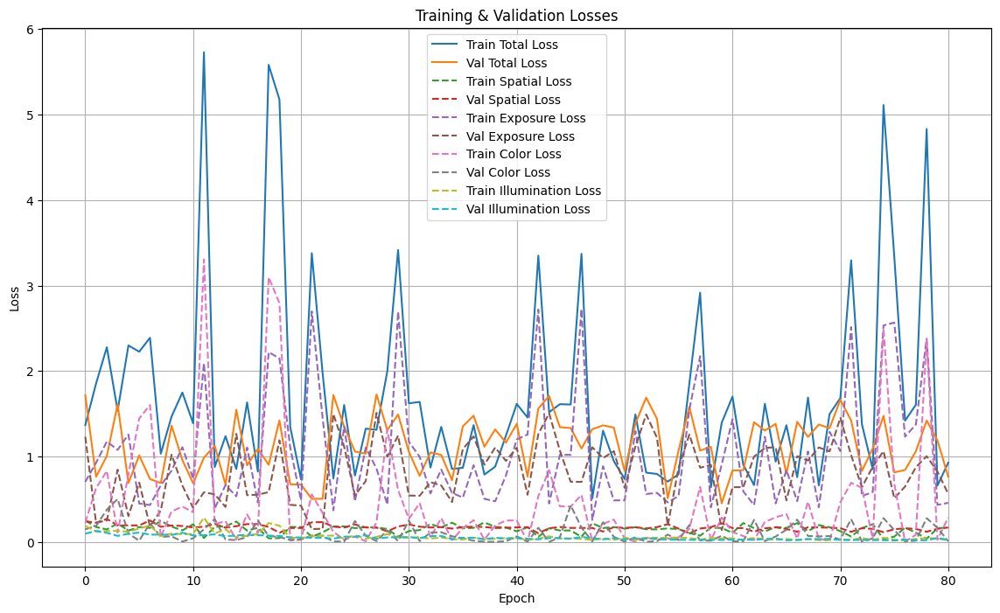

Saving model at epoch 81 to finetuned_models/zero_dce_finetune1007/epoch80...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch80\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch80\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.04s/steps]



Epoch: 82
ETA: 3.88 min
Train Loss: 3.3955624103546143
  Spatial Consistency Loss: 0.05853663384914398
  Exposure Control Loss: 2.7357802391052246
  Color Constancy Loss: 0.5763010382652283
  Illumination Smoothness Loss: 0.02494456060230732
Validation Loss: 1.3720052242279053
  Spatial Consistency Loss: 0.1652907133102417
  Exposure Control Loss: 1.082640290260315
  Color Constancy Loss: 0.09138262271881104
  Illumination Smoothness Loss: 0.03269162029027939



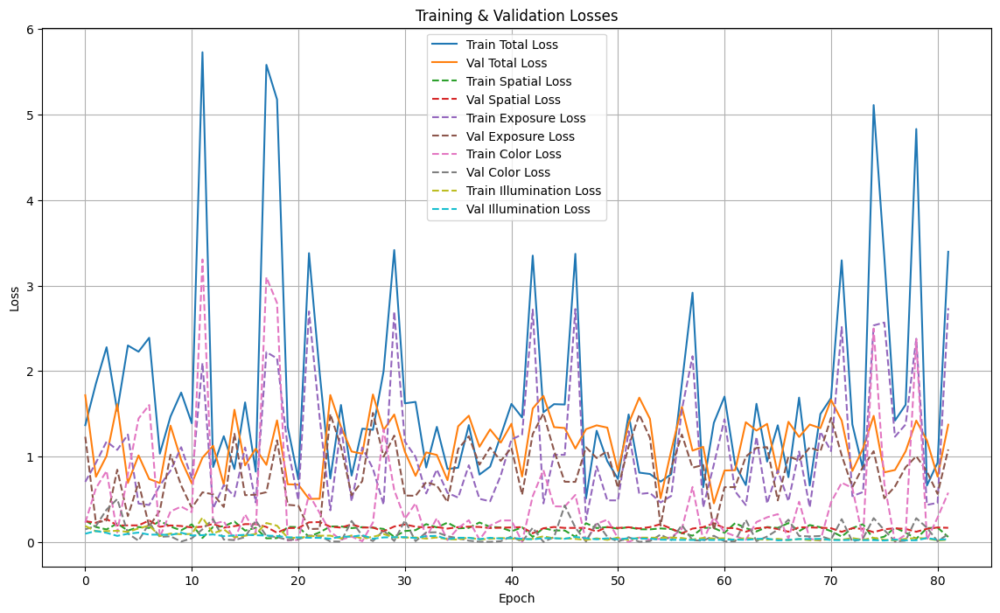

Saving model at epoch 82 to finetuned_models/zero_dce_finetune1007/epoch81...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch81\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch81\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.02s/steps]



Epoch: 83
ETA: 3.83 min
Train Loss: 1.414204478263855
  Spatial Consistency Loss: 0.16165316104888916
  Exposure Control Loss: 0.7033317685127258
  Color Constancy Loss: 0.48729050159454346
  Illumination Smoothness Loss: 0.0619291253387928
Validation Loss: 1.0914316177368164
  Spatial Consistency Loss: 0.15332375466823578
  Exposure Control Loss: 0.8804579973220825
  Color Constancy Loss: 0.039050254970788956
  Illumination Smoothness Loss: 0.018599646165966988



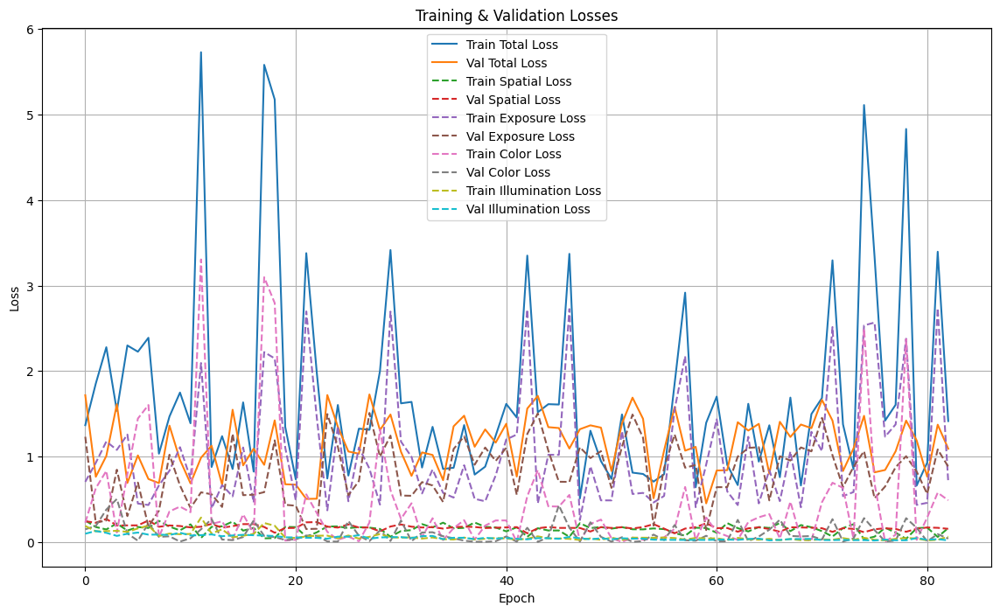

Saving model at epoch 83 to finetuned_models/zero_dce_finetune1007/epoch82...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch82\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch82\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 84
ETA: 3.79 min
Train Loss: 1.7600114345550537
  Spatial Consistency Loss: 0.10386300086975098
  Exposure Control Loss: 1.500499963760376
  Color Constancy Loss: 0.11647208780050278
  Illumination Smoothness Loss: 0.03917635604739189
Validation Loss: 1.6745909452438354
  Spatial Consistency Loss: 0.16214656829833984
  Exposure Control Loss: 1.4619826078414917
  Color Constancy Loss: 0.029645878821611404
  Illumination Smoothness Loss: 0.020815834403038025



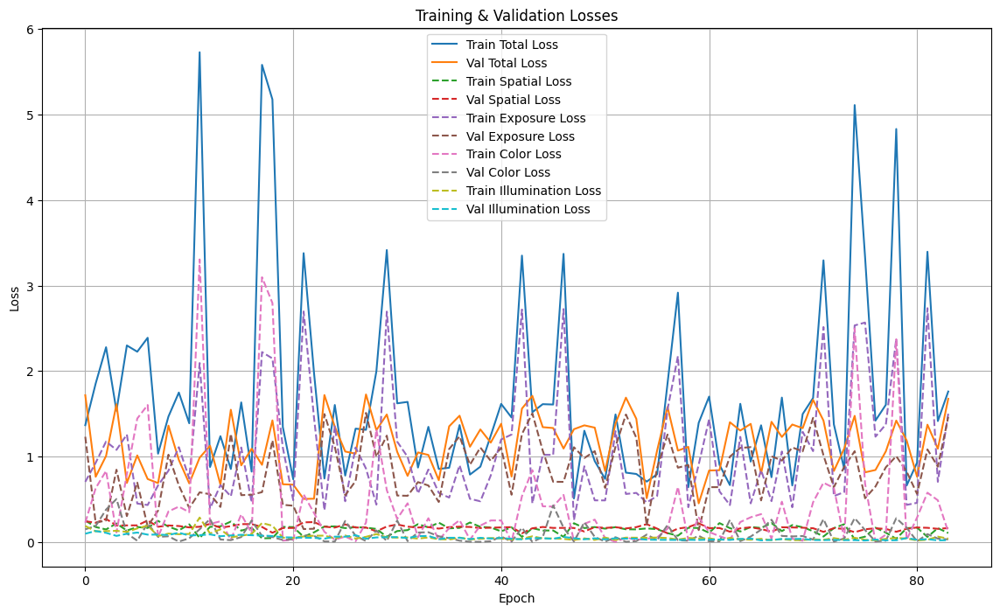

Saving model at epoch 84 to finetuned_models/zero_dce_finetune1007/epoch83...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch83\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch83\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 85
ETA: 3.77 min
Train Loss: 1.7717556953430176
  Spatial Consistency Loss: 0.15014250576496124
  Exposure Control Loss: 0.44676345586776733
  Color Constancy Loss: 1.1286200284957886
  Illumination Smoothness Loss: 0.04622974246740341
Validation Loss: 1.4567996263504028
  Spatial Consistency Loss: 0.11809393763542175
  Exposure Control Loss: 1.0434625148773193
  Color Constancy Loss: 0.2768116593360901
  Illumination Smoothness Loss: 0.018431542441248894



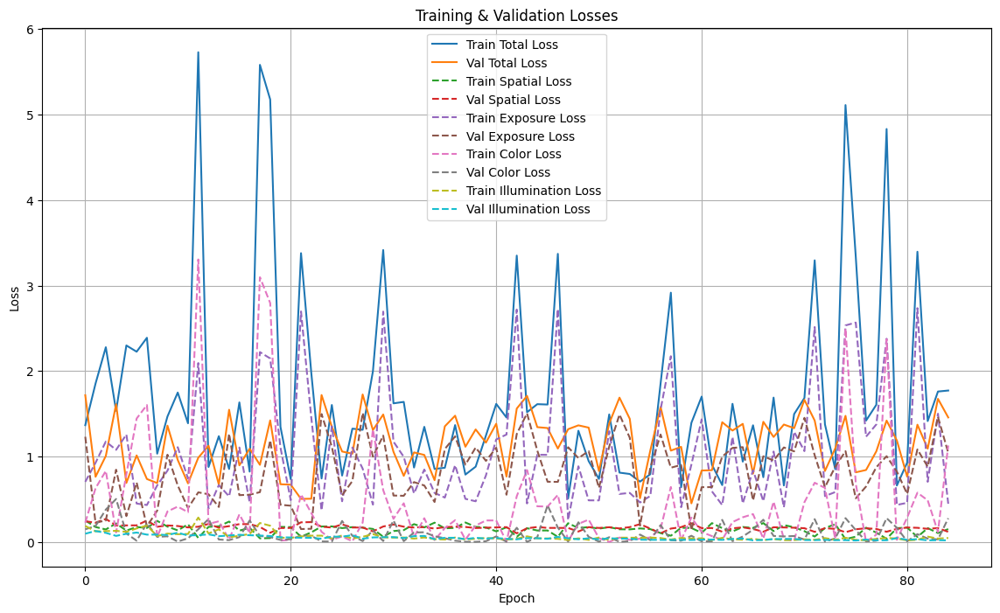

Saving model at epoch 85 to finetuned_models/zero_dce_finetune1007/epoch84...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch84\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch84\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 86
ETA: 3.93 min
Train Loss: 0.6702277064323425
  Spatial Consistency Loss: 0.1869991570711136
  Exposure Control Loss: 0.45534569025039673
  Color Constancy Loss: 0.011106336489319801
  Illumination Smoothness Loss: 0.01677657663822174
Validation Loss: 0.8353492617607117
  Spatial Consistency Loss: 0.15997640788555145
  Exposure Control Loss: 0.6449121236801147
  Color Constancy Loss: 0.006989326328039169
  Illumination Smoothness Loss: 0.023471400141716003



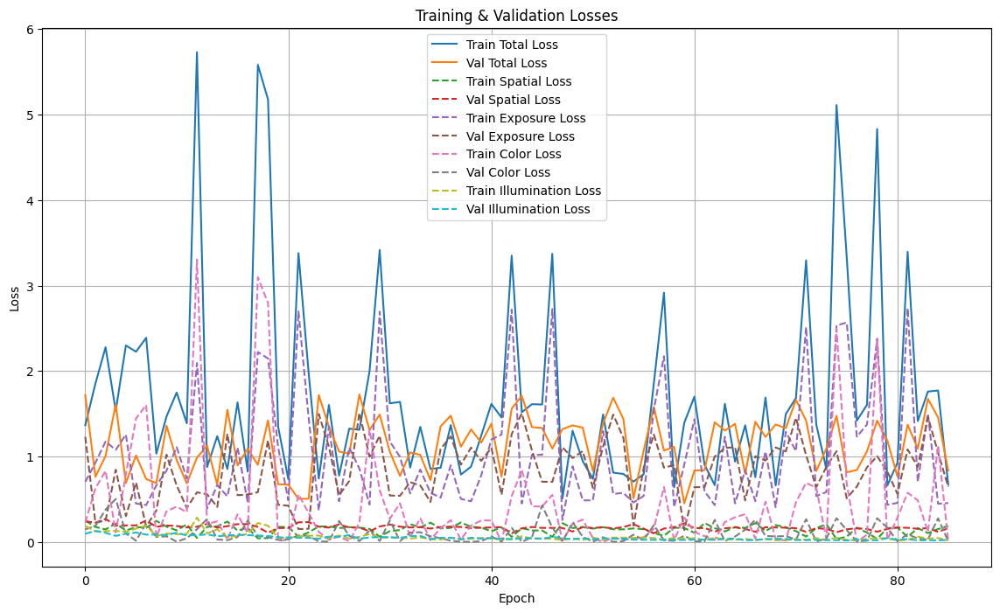

Saving model at epoch 86 to finetuned_models/zero_dce_finetune1007/epoch85...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch85\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch85\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.07s/steps]



Epoch: 87
ETA: 4.02 min
Train Loss: 1.3224685192108154
  Spatial Consistency Loss: 0.16737574338912964
  Exposure Control Loss: 0.6347256898880005
  Color Constancy Loss: 0.463744580745697
  Illumination Smoothness Loss: 0.0566224567592144
Validation Loss: 0.8131434321403503
  Spatial Consistency Loss: 0.15033936500549316
  Exposure Control Loss: 0.491849809885025
  Color Constancy Loss: 0.15618404746055603
  Illumination Smoothness Loss: 0.014770222827792168



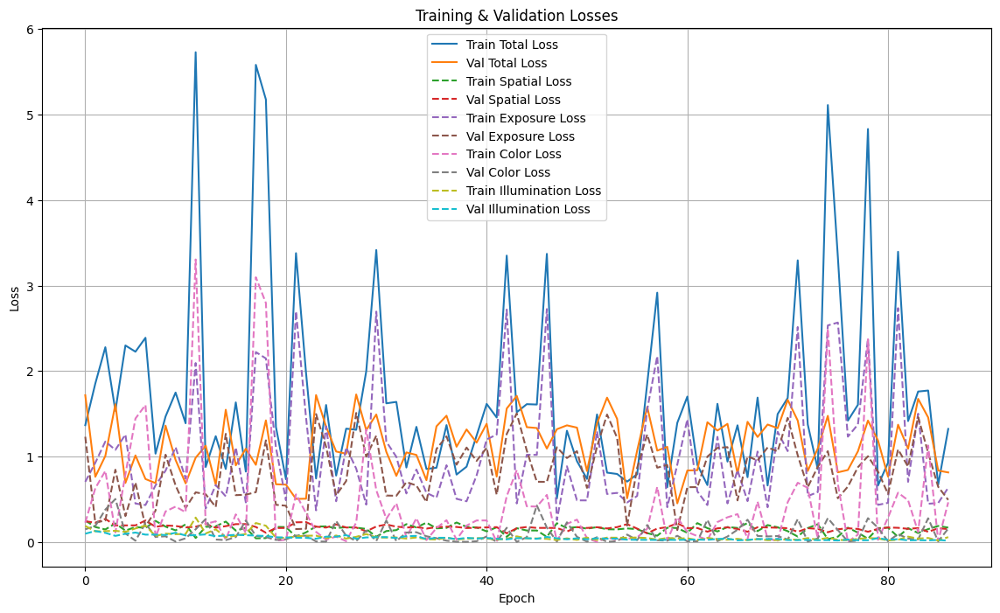

Saving model at epoch 87 to finetuned_models/zero_dce_finetune1007/epoch86...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch86\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch86\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 88
ETA: 3.96 min
Train Loss: 0.8870673775672913
  Spatial Consistency Loss: 0.17730647325515747
  Exposure Control Loss: 0.40438008308410645
  Color Constancy Loss: 0.284930944442749
  Illumination Smoothness Loss: 0.020449867472052574
Validation Loss: 0.8142314553260803
  Spatial Consistency Loss: 0.14954230189323425
  Exposure Control Loss: 0.49536454677581787
  Color Constancy Loss: 0.15323406457901
  Illumination Smoothness Loss: 0.016090523451566696



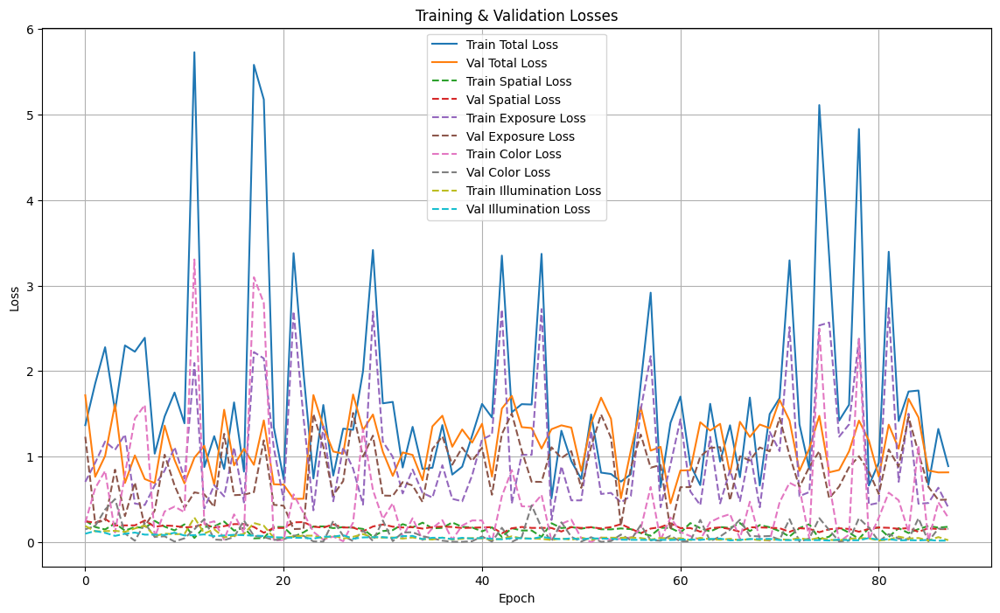

Saving model at epoch 88 to finetuned_models/zero_dce_finetune1007/epoch87...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch87\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch87\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 89
ETA: 3.88 min
Train Loss: 0.7560262680053711
  Spatial Consistency Loss: 0.2198053002357483
  Exposure Control Loss: 0.4607815742492676
  Color Constancy Loss: 0.05924588069319725
  Illumination Smoothness Loss: 0.016193479299545288
Validation Loss: 0.5010033845901489
  Spatial Consistency Loss: 0.2031296193599701
  Exposure Control Loss: 0.19067254662513733
  Color Constancy Loss: 0.08851971477270126
  Illumination Smoothness Loss: 0.018681488931179047



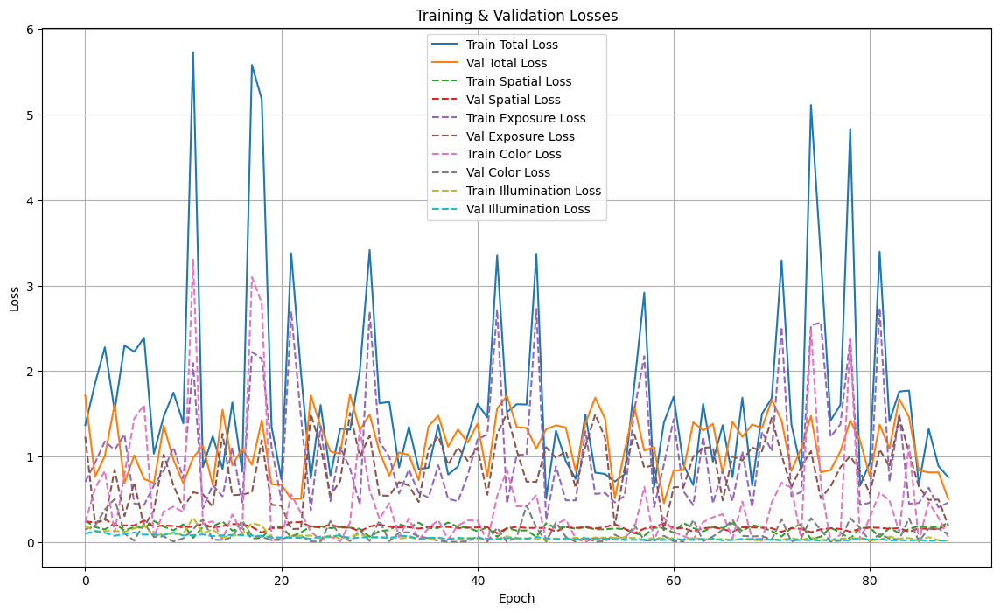

Saving model at epoch 89 to finetuned_models/zero_dce_finetune1007/epoch88...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch88\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch88\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.02steps/s]



Epoch: 90
ETA: 3.91 min
Train Loss: 0.9911954998970032
  Spatial Consistency Loss: 0.1665991097688675
  Exposure Control Loss: 0.502646267414093
  Color Constancy Loss: 0.30603712797164917
  Illumination Smoothness Loss: 0.01591302640736103
Validation Loss: 0.4993913769721985
  Spatial Consistency Loss: 0.20026230812072754
  Exposure Control Loss: 0.1895676702260971
  Color Constancy Loss: 0.08832767605781555
  Illumination Smoothness Loss: 0.021233711391687393



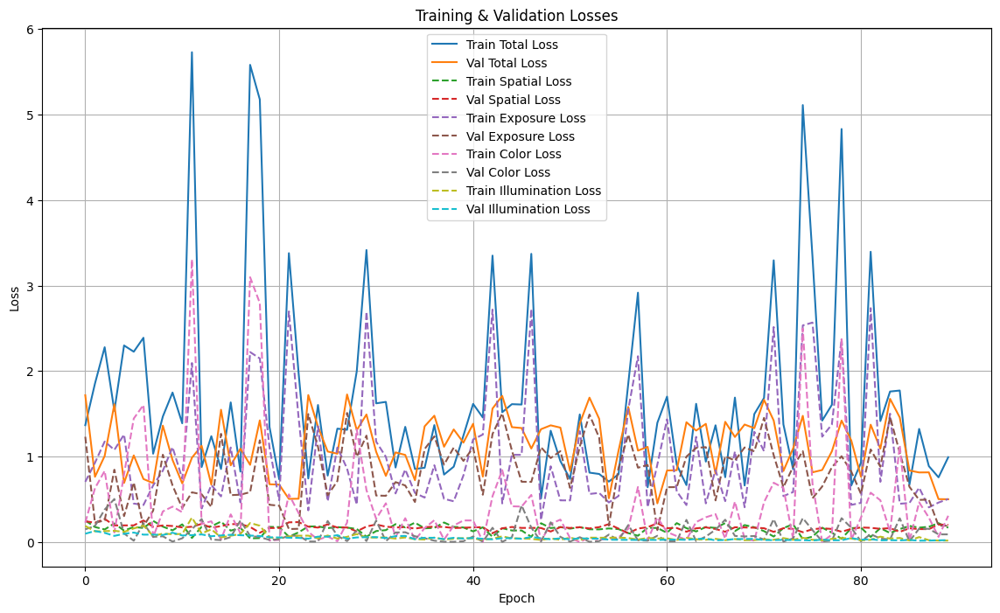

Saving model at epoch 90 to finetuned_models/zero_dce_finetune1007/epoch89...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch89\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch89\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.00s/steps]



Epoch: 91
ETA: 3.85 min
Train Loss: 3.4191341400146484
  Spatial Consistency Loss: 0.056932441890239716
  Exposure Control Loss: 2.7824082374572754
  Color Constancy Loss: 0.5579813122749329
  Illumination Smoothness Loss: 0.02181219682097435
Validation Loss: 1.6652103662490845
  Spatial Consistency Loss: 0.16101029515266418
  Exposure Control Loss: 1.4563374519348145
  Color Constancy Loss: 0.02941552922129631
  Illumination Smoothness Loss: 0.018447119742631912



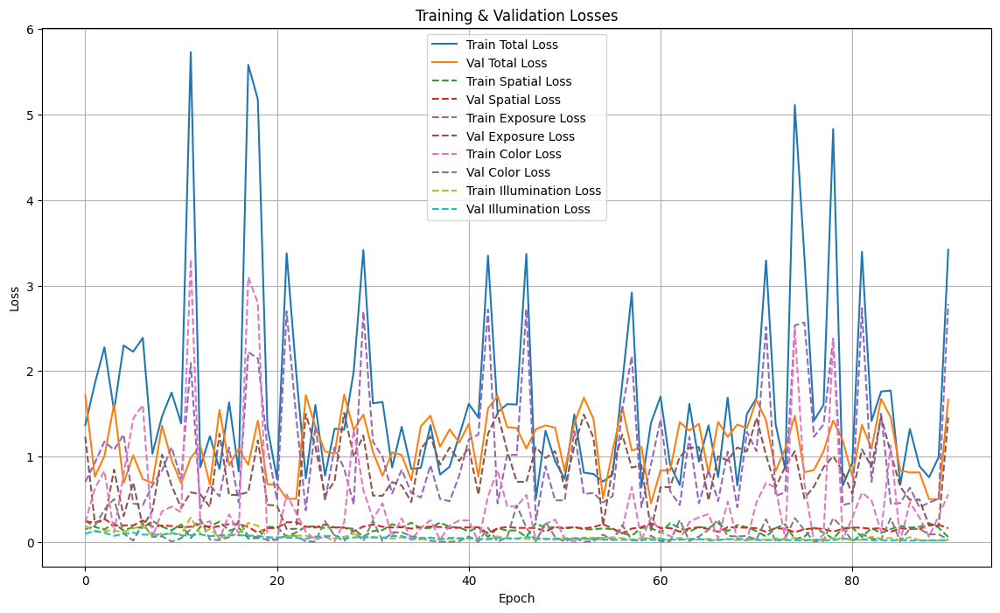

Saving model at epoch 91 to finetuned_models/zero_dce_finetune1007/epoch90...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch90\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch90\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 92
ETA: 3.82 min
Train Loss: 0.9911444187164307
  Spatial Consistency Loss: 0.19263723492622375
  Exposure Control Loss: 0.6936327219009399
  Color Constancy Loss: 0.06605885177850723
  Illumination Smoothness Loss: 0.03881564363837242
Validation Loss: 0.7831721901893616
  Spatial Consistency Loss: 0.19531846046447754
  Exposure Control Loss: 0.5262114405632019
  Color Constancy Loss: 0.02997094951570034
  Illumination Smoothness Loss: 0.03167135640978813



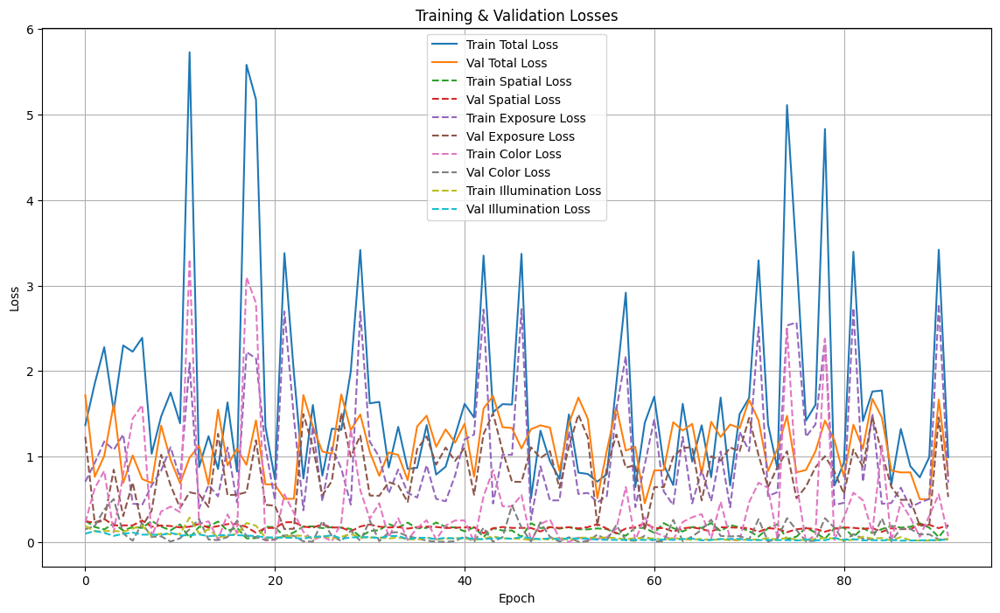

Saving model at epoch 92 to finetuned_models/zero_dce_finetune1007/epoch91...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch91\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch91\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 93
ETA: 3.81 min
Train Loss: 1.5751338005065918
  Spatial Consistency Loss: 0.10880789160728455
  Exposure Control Loss: 1.3934444189071655
  Color Constancy Loss: 0.03656606748700142
  Illumination Smoothness Loss: 0.03631538897752762
Validation Loss: 0.813389778137207
  Spatial Consistency Loss: 0.15002936124801636
  Exposure Control Loss: 0.49357545375823975
  Color Constancy Loss: 0.1556803435087204
  Illumination Smoothness Loss: 0.014104585163295269



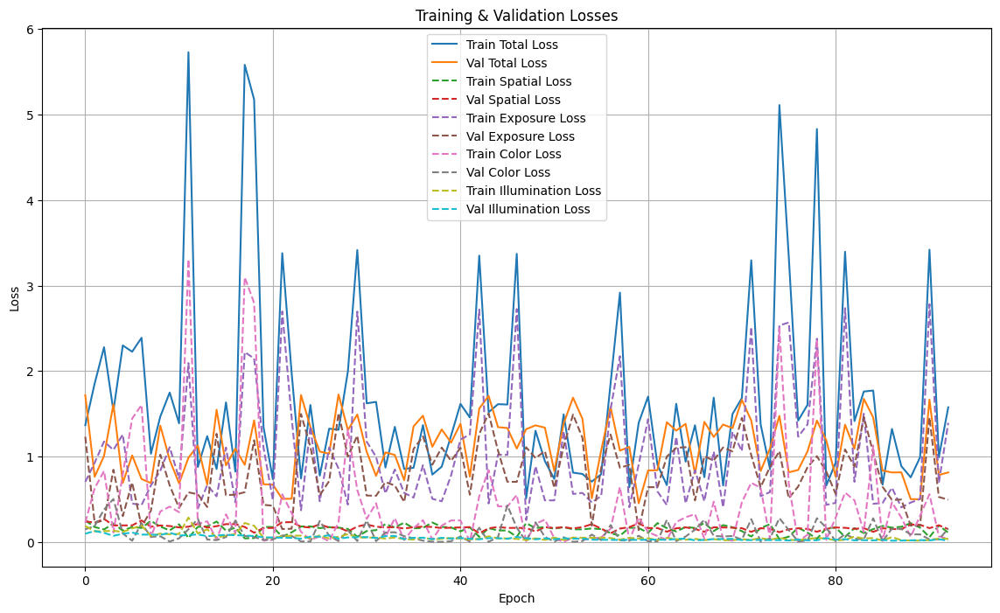

Saving model at epoch 93 to finetuned_models/zero_dce_finetune1007/epoch92...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch92\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch92\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.00steps/s]



Epoch: 94
ETA: 3.78 min
Train Loss: 1.315566897392273
  Spatial Consistency Loss: 0.16851244866847992
  Exposure Control Loss: 0.6743407249450684
  Color Constancy Loss: 0.4151076674461365
  Illumination Smoothness Loss: 0.057606108486652374
Validation Loss: 1.3395167589187622
  Spatial Consistency Loss: 0.16838158667087555
  Exposure Control Loss: 1.0679495334625244
  Color Constancy Loss: 0.07396231591701508
  Illumination Smoothness Loss: 0.02922334149479866



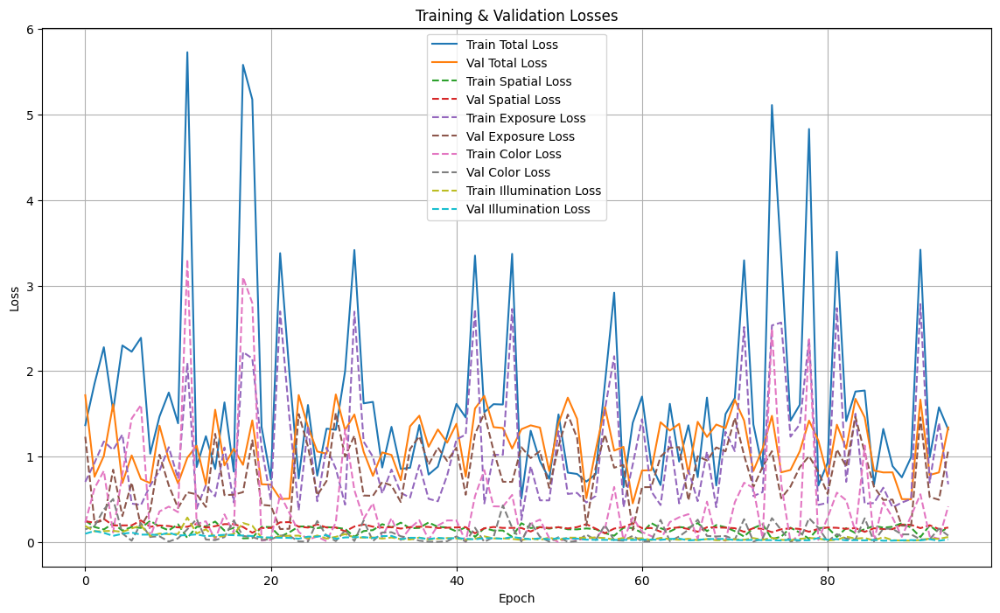

Saving model at epoch 94 to finetuned_models/zero_dce_finetune1007/epoch93...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch93\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch93\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 95
ETA: 3.79 min
Train Loss: 1.2936331033706665
  Spatial Consistency Loss: 0.15864035487174988
  Exposure Control Loss: 0.891589879989624
  Color Constancy Loss: 0.21212241053581238
  Illumination Smoothness Loss: 0.03128044679760933
Validation Loss: 1.1238815784454346
  Spatial Consistency Loss: 0.1587156504392624
  Exposure Control Loss: 0.7082614302635193
  Color Constancy Loss: 0.2083667814731598
  Illumination Smoothness Loss: 0.04853767901659012



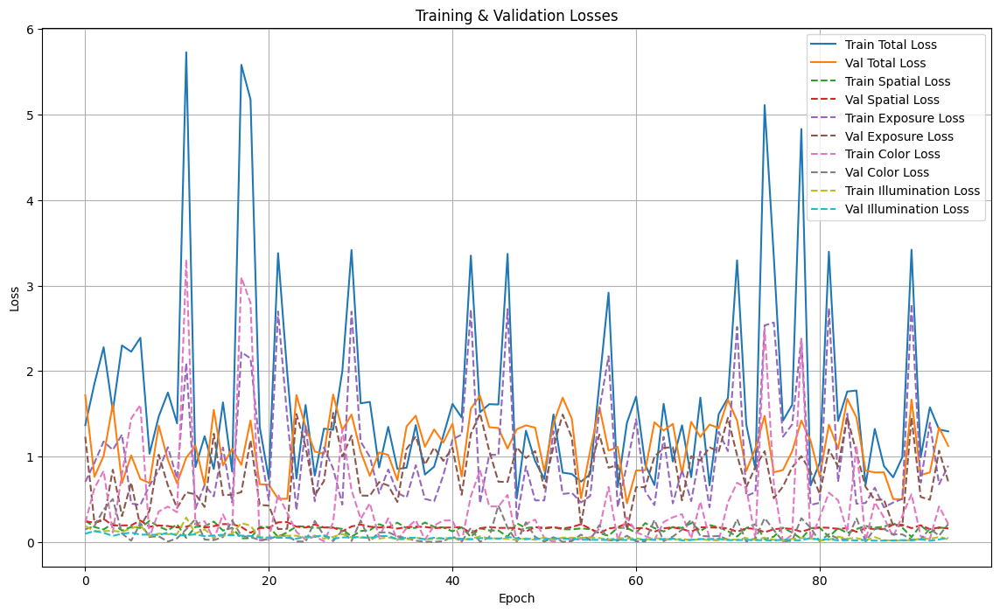

Saving model at epoch 95 to finetuned_models/zero_dce_finetune1007/epoch94...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch94\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch94\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.06s/steps]



Epoch: 96
ETA: 4.03 min
Train Loss: 0.7293684482574463
  Spatial Consistency Loss: 0.1492125242948532
  Exposure Control Loss: 0.5267237424850464
  Color Constancy Loss: 0.015218619257211685
  Illumination Smoothness Loss: 0.038213521242141724
Validation Loss: 0.77925705909729
  Spatial Consistency Loss: 0.19454599916934967
  Exposure Control Loss: 0.5260587930679321
  Color Constancy Loss: 0.02966998517513275
  Illumination Smoothness Loss: 0.028982309624552727



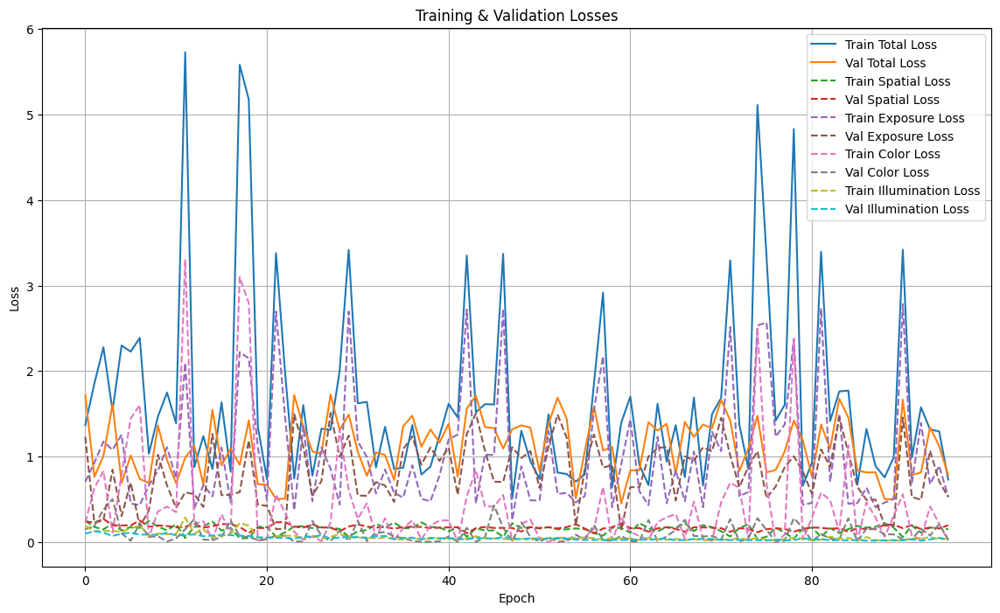

Saving model at epoch 96 to finetuned_models/zero_dce_finetune1007/epoch95...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch95\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch95\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.03s/steps]



Epoch: 97
ETA: 3.96 min
Train Loss: 0.9879691004753113
  Spatial Consistency Loss: 0.19389115273952484
  Exposure Control Loss: 0.6838889122009277
  Color Constancy Loss: 0.0713849887251854
  Illumination Smoothness Loss: 0.03880404680967331
Validation Loss: 1.2995500564575195
  Spatial Consistency Loss: 0.15922287106513977
  Exposure Control Loss: 1.0993038415908813
  Color Constancy Loss: 0.012572519481182098
  Illumination Smoothness Loss: 0.028450798243284225



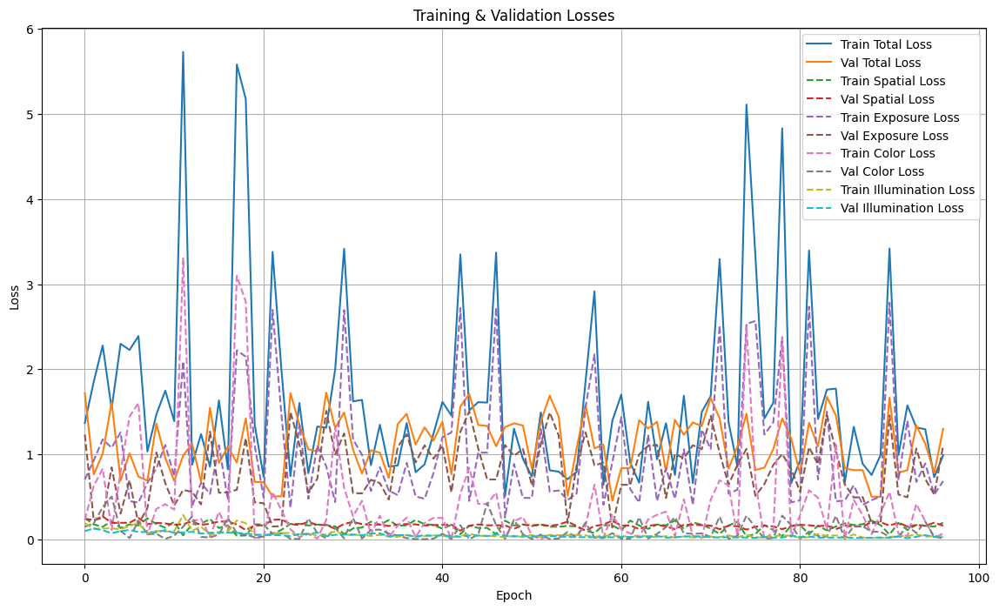

Saving model at epoch 97 to finetuned_models/zero_dce_finetune1007/epoch96...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch96\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch96\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:06<00:00,  1.01s/steps]



Epoch: 98
ETA: 3.94 min
Train Loss: 1.4010040760040283
  Spatial Consistency Loss: 0.15740633010864258
  Exposure Control Loss: 0.5342377424240112
  Color Constancy Loss: 0.6714820861816406
  Illumination Smoothness Loss: 0.03787797689437866
Validation Loss: 0.8403847217559814
  Spatial Consistency Loss: 0.15727655589580536
  Exposure Control Loss: 0.6542418003082275
  Color Constancy Loss: 0.00784336868673563
  Illumination Smoothness Loss: 0.021022973582148552



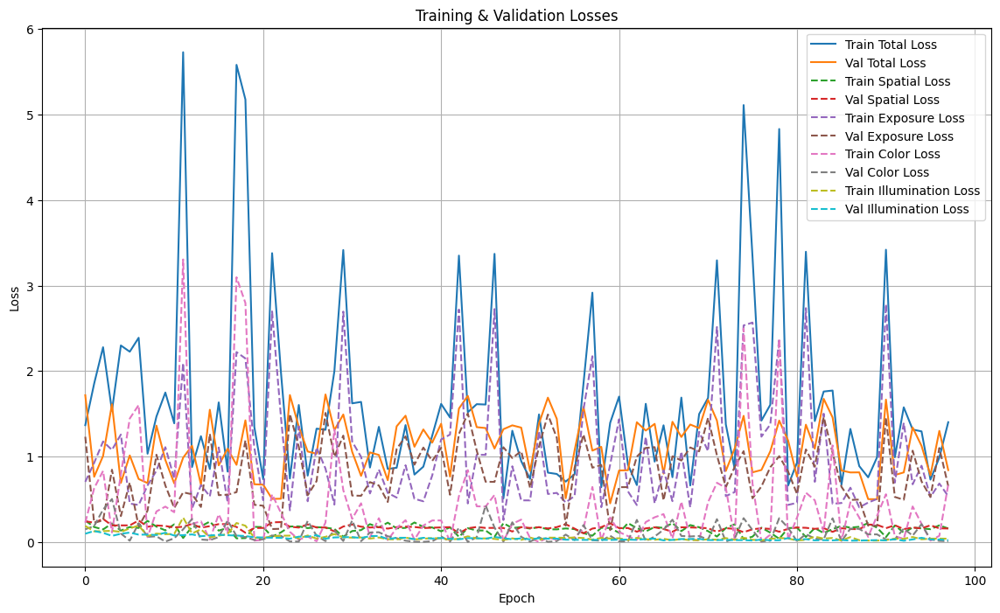

Saving model at epoch 98 to finetuned_models/zero_dce_finetune1007/epoch97...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch97\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch97\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.03steps/s]



Epoch: 99
ETA: 3.81 min
Train Loss: 1.3530313968658447
  Spatial Consistency Loss: 0.16887719929218292
  Exposure Control Loss: 0.6535084247589111
  Color Constancy Loss: 0.47774526476860046
  Illumination Smoothness Loss: 0.052900530397892
Validation Loss: 1.3288410902023315
  Spatial Consistency Loss: 0.157795250415802
  Exposure Control Loss: 0.7032376527786255
  Color Constancy Loss: 0.4423857033252716
  Illumination Smoothness Loss: 0.02542247623205185



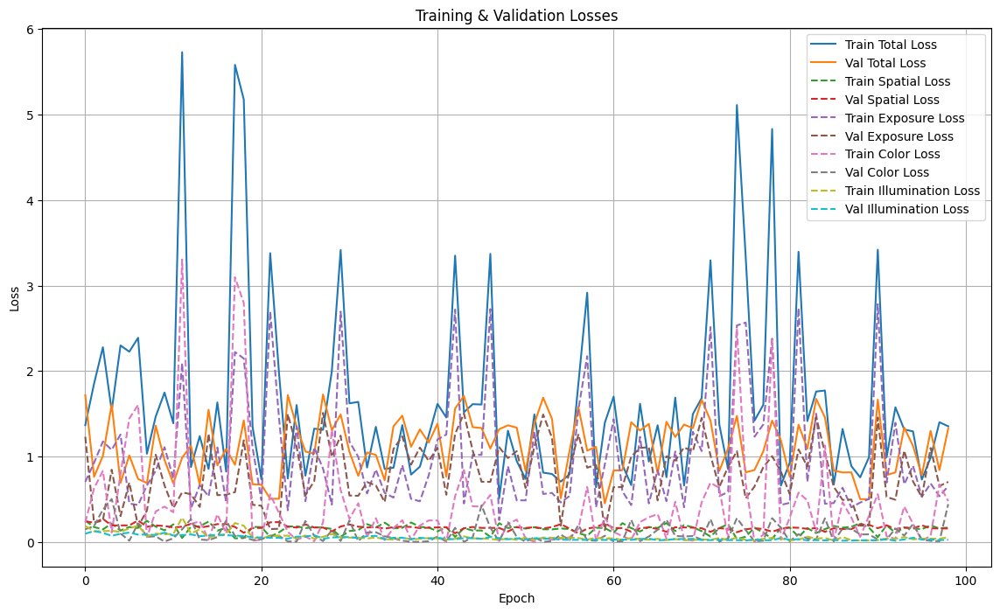

Saving model at epoch 99 to finetuned_models/zero_dce_finetune1007/epoch98...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch98\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch98\assets


Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.01steps/s]



Epoch: 100
ETA: 3.83 min
Train Loss: 1.1926928758621216
  Spatial Consistency Loss: 0.17414425313472748
  Exposure Control Loss: 0.9692301750183105
  Color Constancy Loss: 0.034858472645282745
  Illumination Smoothness Loss: 0.014459945261478424
Validation Loss: 1.3151416778564453
  Spatial Consistency Loss: 0.168720543384552
  Exposure Control Loss: 1.0462079048156738
  Color Constancy Loss: 0.07461436837911606
  Illumination Smoothness Loss: 0.02559884451329708



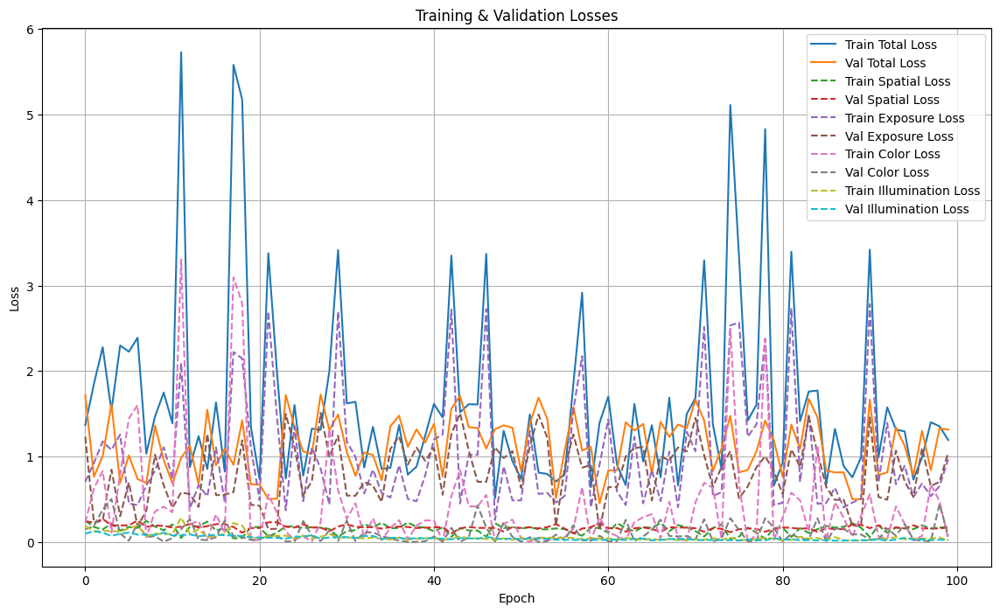

Saving model at epoch 100 to finetuned_models/zero_dce_finetune1007/epoch99...



INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch99\assets


INFO:tensorflow:Assets written to: finetuned_models/zero_dce_finetune1007/epoch99\assets


Model saved.



In [ ]:
import time
from tqdm import tqdm
import tensorflow as tf
import matplotlib.pyplot as plt

history = {
    "train_total": [],
    "train_spatial": [],
    "train_exposure": [],
    "train_color": [],
    "train_illumination": [],
    "val_total": [],
    "val_spatial": [],
    "val_exposure": [],
    "val_color": [],
    "val_illumination": [],
}

def plot_losses(history):
    plt.figure(figsize=(14, 8))
    plt.plot(history["train_total"], label="Train Total Loss")
    plt.plot(history["val_total"], label="Val Total Loss")
    plt.plot(history["train_spatial"], label="Train Spatial Loss", linestyle='--')
    plt.plot(history["val_spatial"], label="Val Spatial Loss", linestyle='--')
    plt.plot(history["train_exposure"], label="Train Exposure Loss", linestyle='--')
    plt.plot(history["val_exposure"], label="Val Exposure Loss", linestyle='--')
    plt.plot(history["train_color"], label="Train Color Loss", linestyle='--')
    plt.plot(history["val_color"], label="Val Color Loss", linestyle='--')
    plt.plot(history["train_illumination"], label="Train Illumination Loss", linestyle='--')
    plt.plot(history["val_illumination"], label="Val Illumination Loss", linestyle='--')
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training & Validation Losses")
    plt.legend()
    plt.grid(True)
    plt.show()

print('Training the model...\n')
epoch = 100
for e in range(epoch):
    t = time.time()

    for img in tqdm(train_data, unit='steps', desc='training...', colour='red'):
        losses = model.train_step(img)

    for img in tqdm(val_data, unit='steps', desc='validating...', colour='green'):
        val_losses = model.test_step(img)

    print(f"\nEpoch: {e+1}")
    print(f"ETA: {round((time.time() - t)/60, 2)} min")
    print(f"Train Loss: {losses['total_loss']}")
    print(f"  Spatial Consistency Loss: {losses['spatial_consistency_loss']}")
    print(f"  Exposure Control Loss: {losses['exposure_control_loss']}")
    print(f"  Color Constancy Loss: {losses['color_constancy_loss']}")
    print(f"  Illumination Smoothness Loss: {losses['illumination_smoothness_loss']}")
    print(f"Validation Loss: {val_losses['total_loss']}")
    print(f"  Spatial Consistency Loss: {val_losses['spatial_consistency_loss']}")
    print(f"  Exposure Control Loss: {val_losses['exposure_control_loss']}")
    print(f"  Color Constancy Loss: {val_losses['color_constancy_loss']}")
    print(f"  Illumination Smoothness Loss: {val_losses['illumination_smoothness_loss']}\n")

    history["train_total"].append(losses["total_loss"].numpy())
    history["train_spatial"].append(losses["spatial_consistency_loss"].numpy())
    history["train_exposure"].append(losses["exposure_control_loss"].numpy())
    history["train_color"].append(losses["color_constancy_loss"].numpy())
    history["train_illumination"].append(losses["illumination_smoothness_loss"].numpy())

    history["val_total"].append(val_losses["total_loss"].numpy())
    history["val_spatial"].append(val_losses["spatial_consistency_loss"].numpy())
    history["val_exposure"].append(val_losses["exposure_control_loss"].numpy())
    history["val_color"].append(val_losses["color_constancy_loss"].numpy())
    history["val_illumination"].append(val_losses["illumination_smoothness_loss"].numpy())

    plot_losses(history)

    # Model opslaan elke 10 epochs
    model_path = f'finetuned_models/zero_dce_finetune1007/epoch{e}'
    print(f"Saving model at epoch {e+1} to {model_path}...\n")
    model.save(model_path, save_format='tf')
    print(f"Model saved.\n")


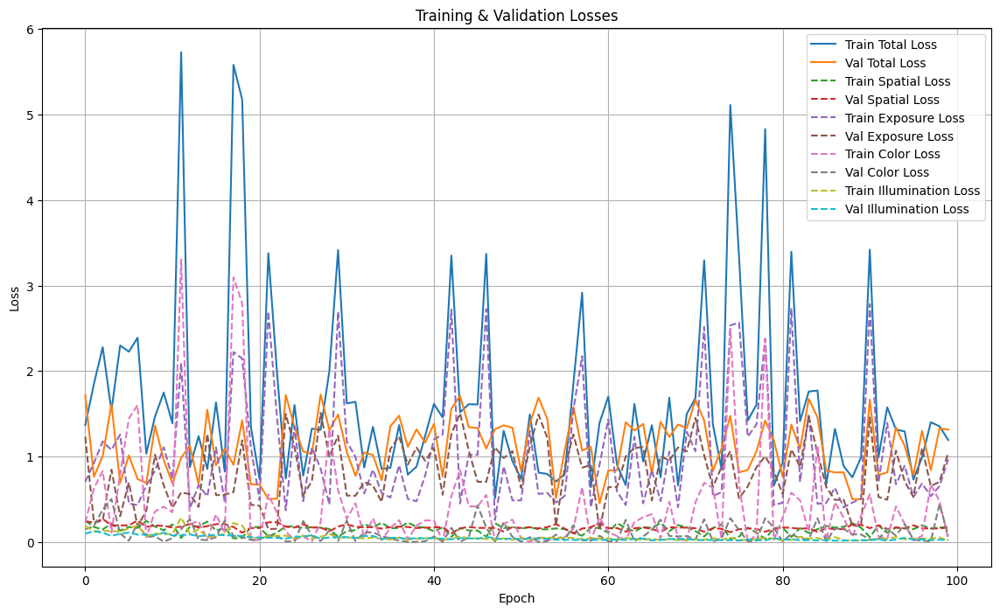

In [93]:
plot_losses(history)

# Soms werd er verder getraind op het vorige gefinetunede model

Training the model...



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.13steps/s]



Epoch: 1
ETA: 3.33 min
Train Loss: 0.6435599327087402
  Spatial Consistency Loss: 0.21213403344154358
  Exposure Control Loss: 0.40837880969047546
  Color Constancy Loss: 0.005056749098002911
  Illumination Smoothness Loss: 0.017990373075008392
Validation Loss: 1.6687209606170654
  Spatial Consistency Loss: 0.16178365051746368
  Exposure Control Loss: 1.4497134685516357
  Color Constancy Loss: 0.03179921582341194
  Illumination Smoothness Loss: 0.025424599647521973



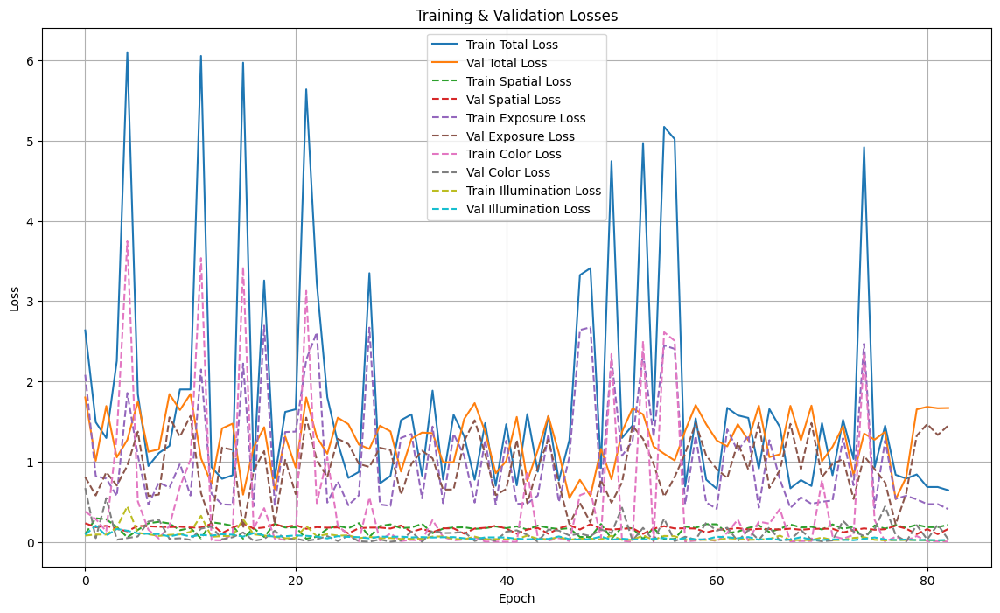

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.16steps/s]



Epoch: 2
ETA: 3.19 min
Train Loss: 0.8092994689941406
  Spatial Consistency Loss: 0.21504661440849304
  Exposure Control Loss: 0.506874144077301
  Color Constancy Loss: 0.06620252877473831
  Illumination Smoothness Loss: 0.021176232025027275
Validation Loss: 1.1979531049728394
  Spatial Consistency Loss: 0.15545807778835297
  Exposure Control Loss: 0.8007262945175171
  Color Constancy Loss: 0.19027166068553925
  Illumination Smoothness Loss: 0.05149706453084946



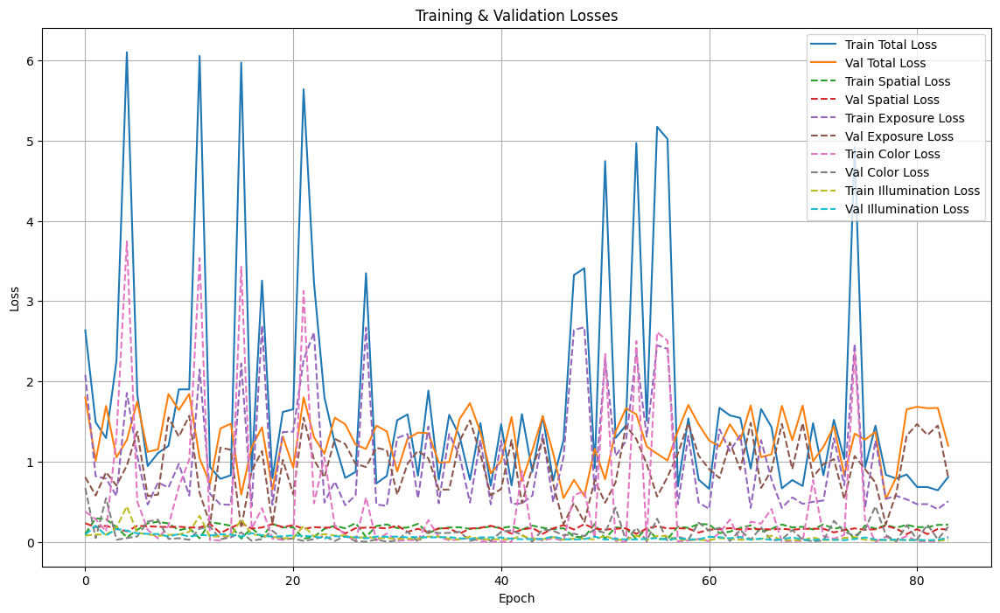

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.16steps/s]



Epoch: 3
ETA: 3.3 min
Train Loss: 0.8012375235557556
  Spatial Consistency Loss: 0.21736420691013336
  Exposure Control Loss: 0.49158018827438354
  Color Constancy Loss: 0.07077271491289139
  Illumination Smoothness Loss: 0.021520433947443962
Validation Loss: 0.8055093288421631
  Spatial Consistency Loss: 0.16285811364650726
  Exposure Control Loss: 0.6100015640258789
  Color Constancy Loss: 0.005373150110244751
  Illumination Smoothness Loss: 0.027276532724499702



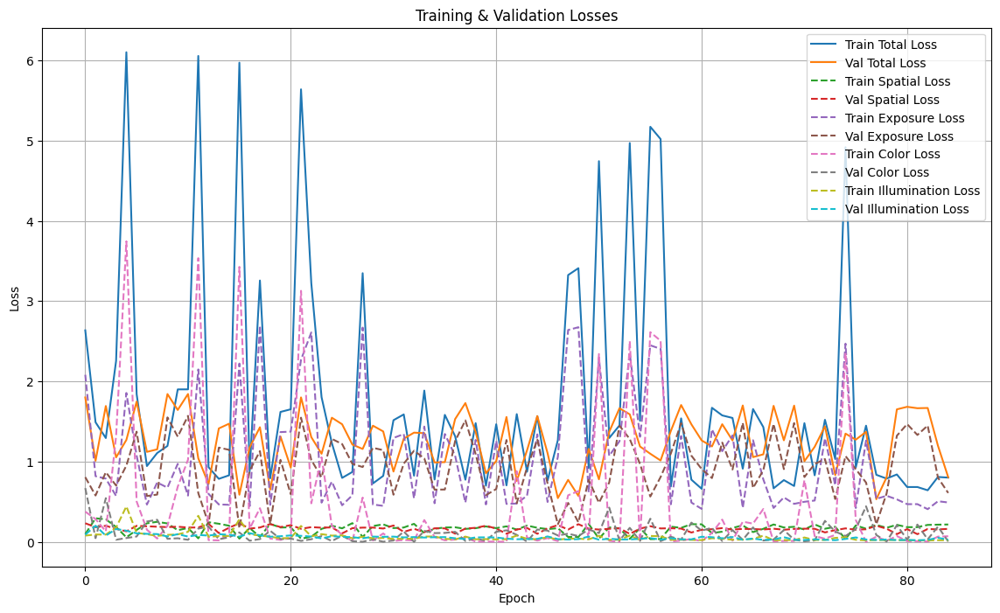

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 4
ETA: 3.25 min
Train Loss: 4.485994815826416
  Spatial Consistency Loss: 0.04035298153758049
  Exposure Control Loss: 2.296363592147827
  Color Constancy Loss: 2.1026668548583984
  Illumination Smoothness Loss: 0.04661121591925621
Validation Loss: 1.354566216468811
  Spatial Consistency Loss: 0.16472452878952026
  Exposure Control Loss: 1.0823808908462524
  Color Constancy Loss: 0.07194240391254425
  Illumination Smoothness Loss: 0.03551837056875229



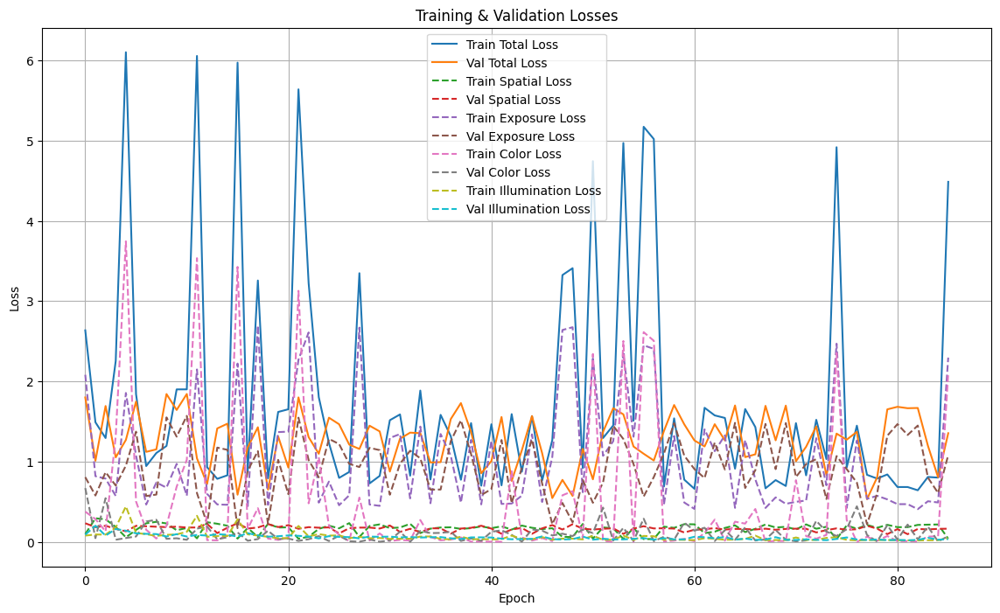

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.13steps/s]



Epoch: 5
ETA: 3.2 min
Train Loss: 0.9285785555839539
  Spatial Consistency Loss: 0.2046942561864853
  Exposure Control Loss: 0.4218950867652893
  Color Constancy Loss: 0.2781270146369934
  Illumination Smoothness Loss: 0.023862160742282867
Validation Loss: 0.5551041960716248
  Spatial Consistency Loss: 0.21328195929527283
  Exposure Control Loss: 0.23495936393737793
  Color Constancy Loss: 0.08339525014162064
  Illumination Smoothness Loss: 0.023467587307095528



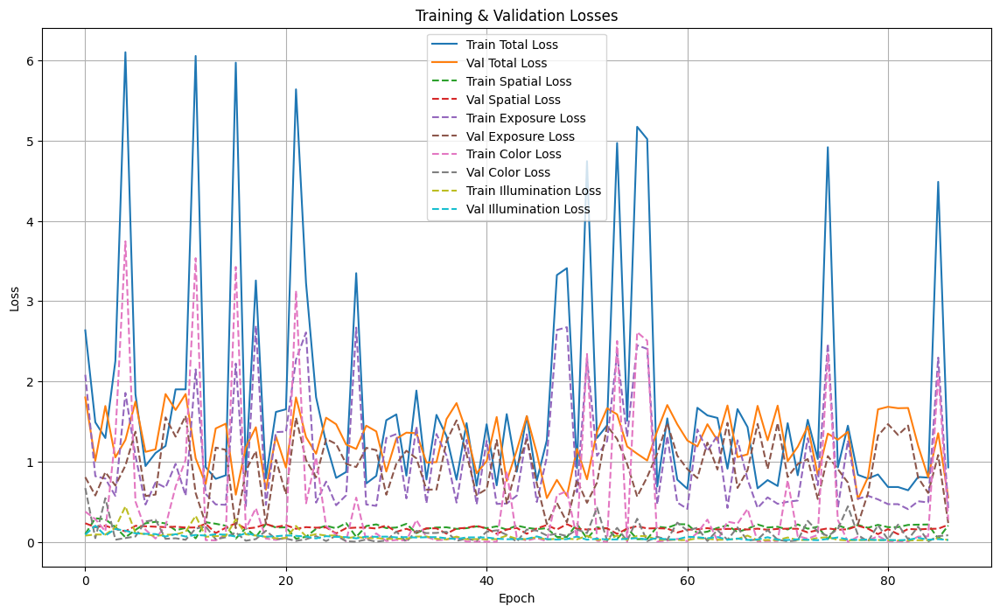

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.15steps/s]



Epoch: 6
ETA: 3.28 min
Train Loss: 4.622813701629639
  Spatial Consistency Loss: 0.03895315155386925
  Exposure Control Loss: 2.352407455444336
  Color Constancy Loss: 2.1857759952545166
  Illumination Smoothness Loss: 0.045677006244659424
Validation Loss: 0.87814861536026
  Spatial Consistency Loss: 0.157168447971344
  Exposure Control Loss: 0.689568817615509
  Color Constancy Loss: 0.007010842673480511
  Illumination Smoothness Loss: 0.024400552734732628



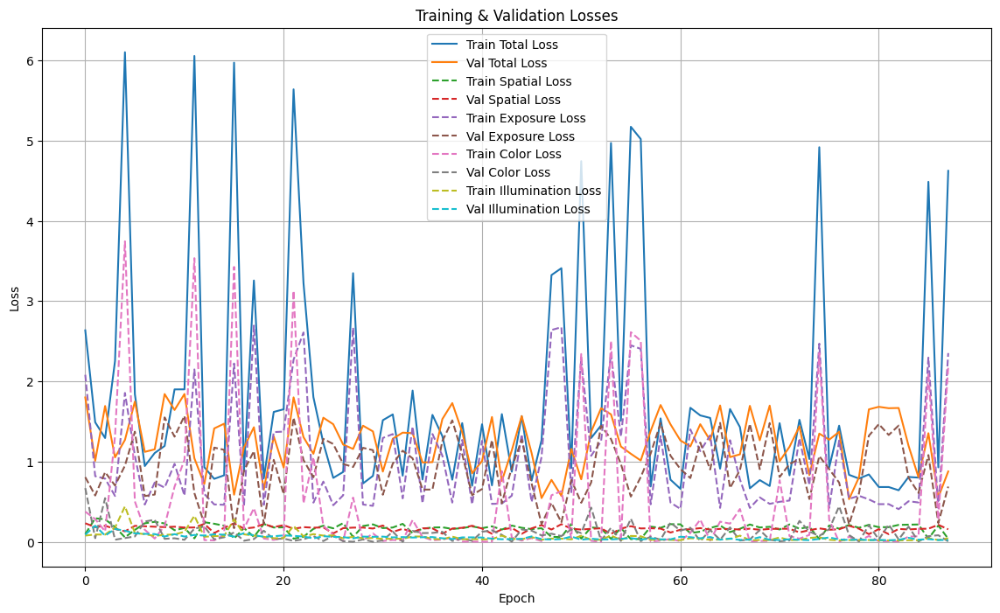

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.16steps/s]



Epoch: 7
ETA: 3.35 min
Train Loss: 0.7875829935073853
  Spatial Consistency Loss: 0.17848943173885345
  Exposure Control Loss: 0.5738572478294373
  Color Constancy Loss: 0.01644192822277546
  Illumination Smoothness Loss: 0.018794339150190353
Validation Loss: 0.8307057023048401
  Spatial Consistency Loss: 0.14926153421401978
  Exposure Control Loss: 0.5211789608001709
  Color Constancy Loss: 0.1431393027305603
  Illumination Smoothness Loss: 0.017125895246863365



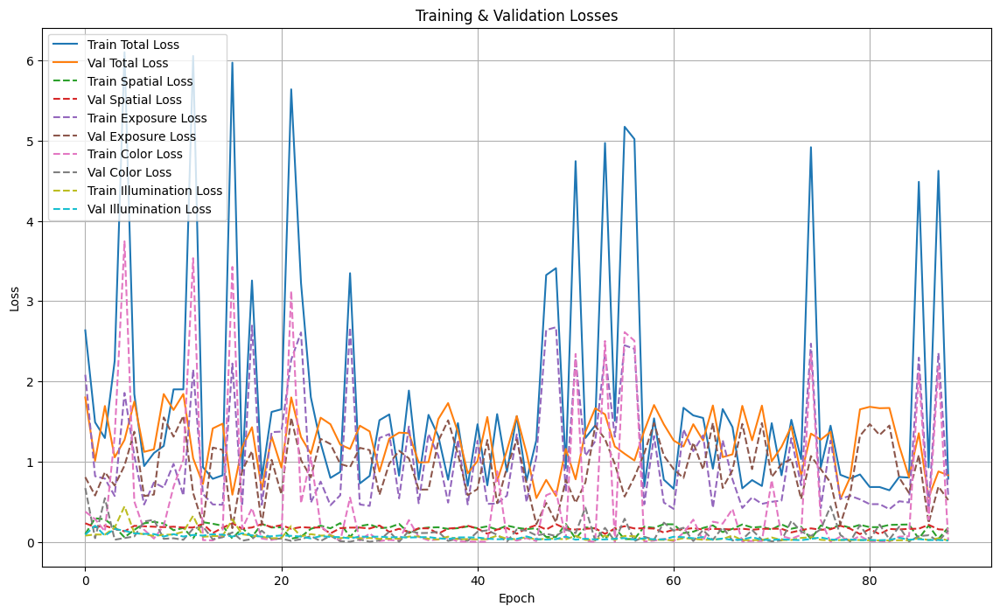

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.16steps/s]



Epoch: 8
ETA: 3.2 min
Train Loss: 1.5120257139205933
  Spatial Consistency Loss: 0.16387885808944702
  Exposure Control Loss: 1.2901140451431274
  Color Constancy Loss: 0.03699833154678345
  Illumination Smoothness Loss: 0.02103465422987938
Validation Loss: 1.4631181955337524
  Spatial Consistency Loss: 0.17209427058696747
  Exposure Control Loss: 1.220884084701538
  Color Constancy Loss: 0.03473982214927673
  Illumination Smoothness Loss: 0.035399992018938065



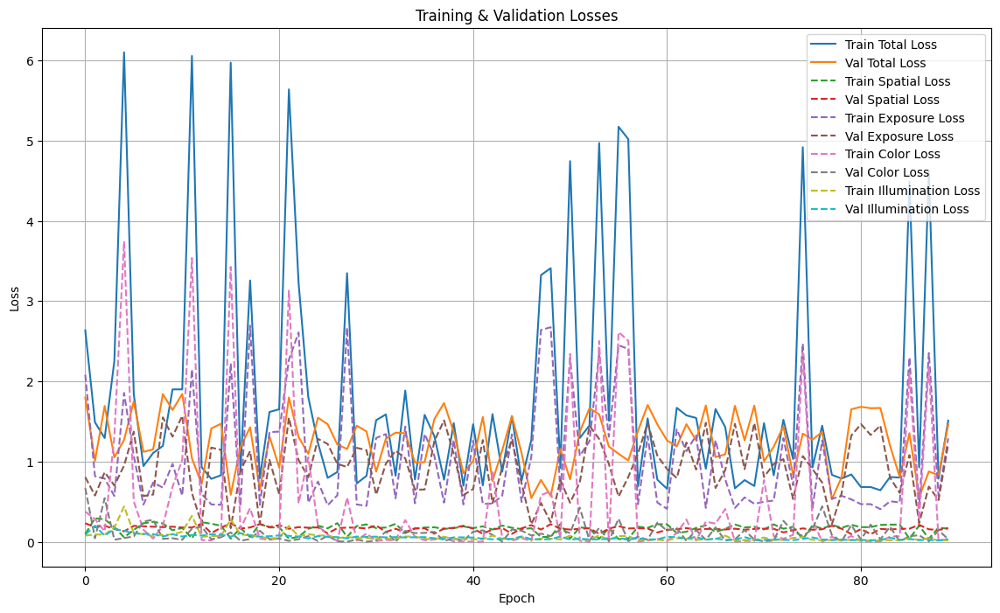

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 9
ETA: 3.29 min
Train Loss: 3.3654298782348633
  Spatial Consistency Loss: 0.06175515428185463
  Exposure Control Loss: 2.591153621673584
  Color Constancy Loss: 0.6845937967300415
  Illumination Smoothness Loss: 0.02792738378047943
Validation Loss: 1.2681159973144531
  Spatial Consistency Loss: 0.17216093838214874
  Exposure Control Loss: 0.9827678799629211
  Color Constancy Loss: 0.08007999509572983
  Illumination Smoothness Loss: 0.033107172697782516



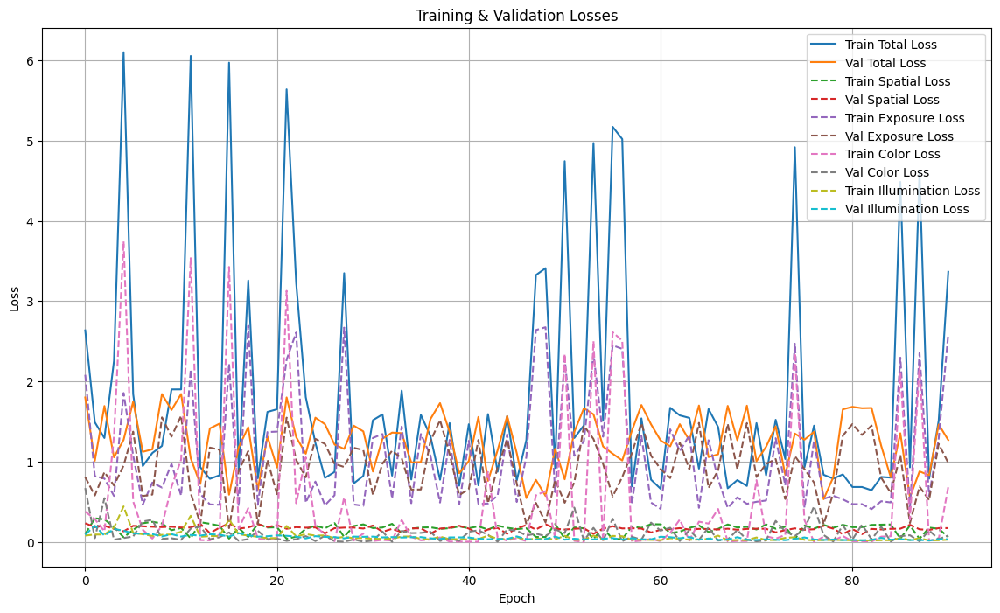

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 10
ETA: 3.29 min
Train Loss: 4.848023414611816
  Spatial Consistency Loss: 0.036383457481861115
  Exposure Control Loss: 2.3984627723693848
  Color Constancy Loss: 2.364967107772827
  Illumination Smoothness Loss: 0.04821029305458069
Validation Loss: 0.8383662104606628
  Spatial Consistency Loss: 0.14861665666103363
  Exposure Control Loss: 0.522821843624115
  Color Constancy Loss: 0.15023311972618103
  Illumination Smoothness Loss: 0.016694597899913788



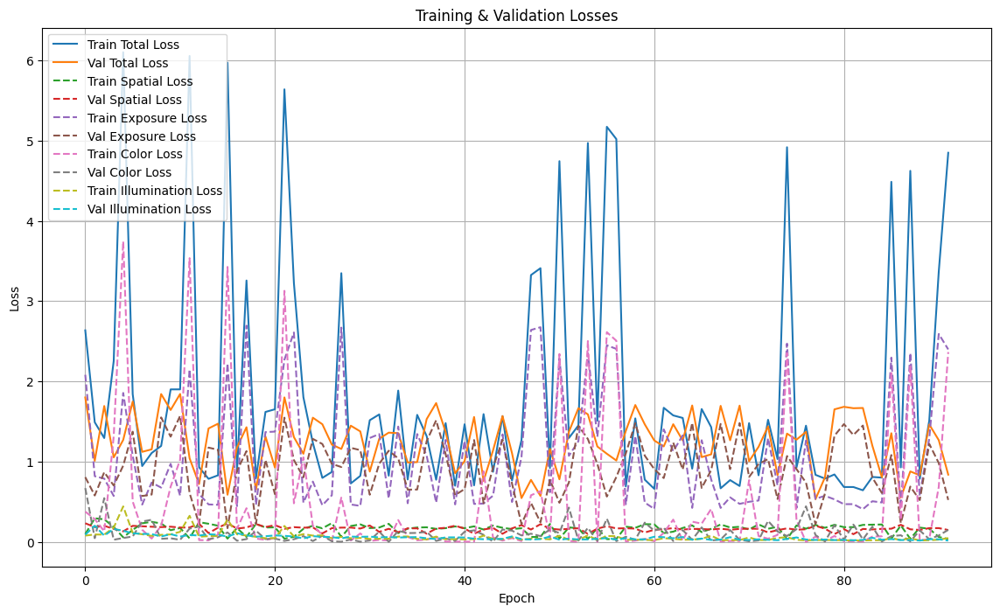

Model saved.



validating...: 100%|██████████| 6/6 [00:05<00:00,  1.13steps/s]



Epoch: 11
ETA: 3.28 min
Train Loss: 0.8555477261543274
  Spatial Consistency Loss: 0.21492928266525269
  Exposure Control Loss: 0.5471455454826355
  Color Constancy Loss: 0.07236441969871521
  Illumination Smoothness Loss: 0.021108455955982208
Validation Loss: 1.361290693283081
  Spatial Consistency Loss: 0.1706905961036682
  Exposure Control Loss: 1.0765609741210938
  Color Constancy Loss: 0.07955440878868103
  Illumination Smoothness Loss: 0.03448478877544403



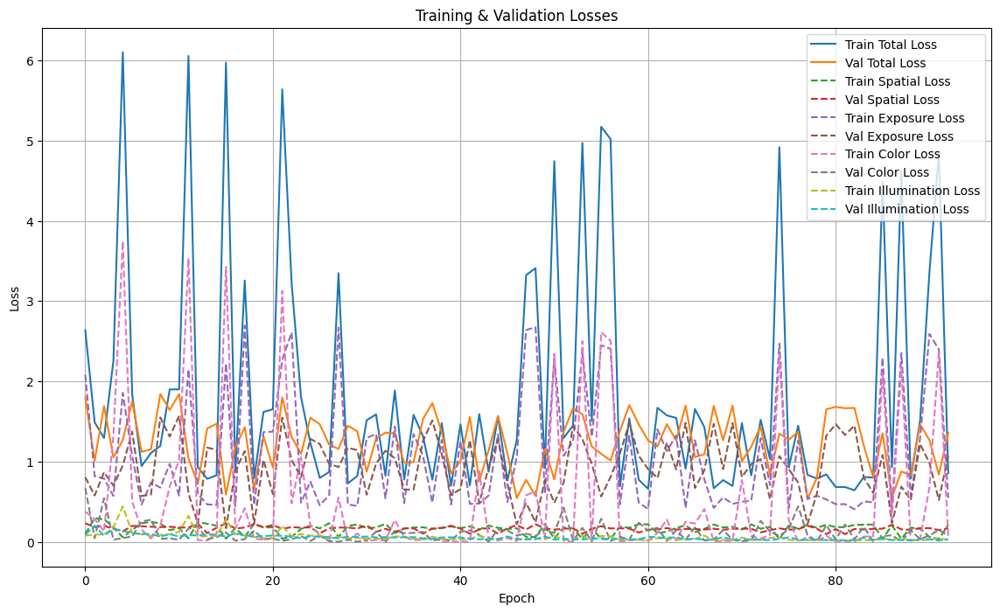

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 12
ETA: 3.25 min
Train Loss: 4.921789169311523
  Spatial Consistency Loss: 0.03515692055225372
  Exposure Control Loss: 2.455597162246704
  Color Constancy Loss: 2.3867132663726807
  Illumination Smoothness Loss: 0.0443219430744648
Validation Loss: 0.46259501576423645
  Spatial Consistency Loss: 0.21341603994369507
  Exposure Control Loss: 0.15304875373840332
  Color Constancy Loss: 0.07742198556661606
  Illumination Smoothness Loss: 0.018708232790231705



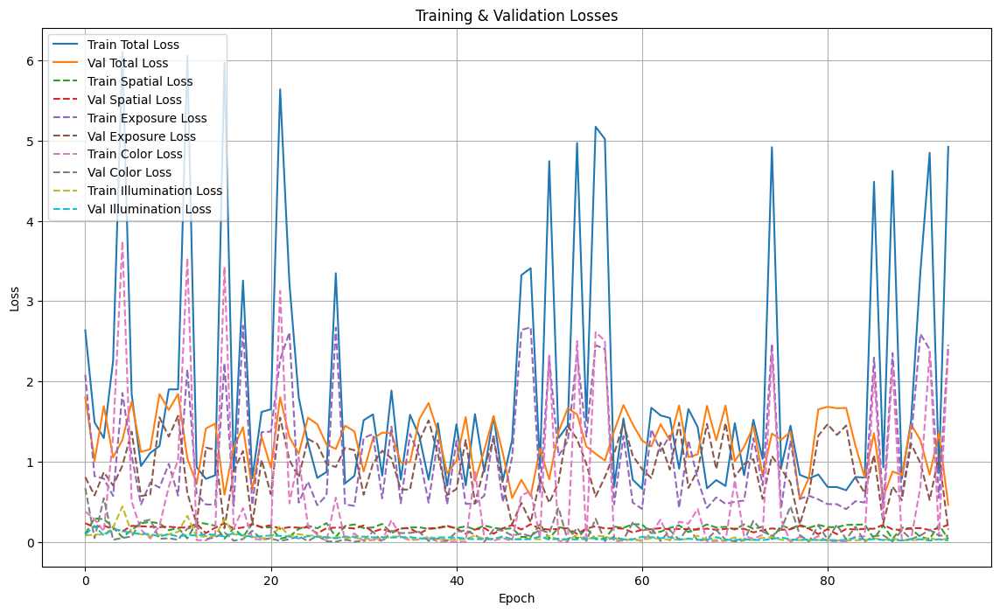

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.12steps/s]



Epoch: 13
ETA: 3.24 min
Train Loss: 0.8344526886940002
  Spatial Consistency Loss: 0.21877209842205048
  Exposure Control Loss: 0.5198575258255005
  Color Constancy Loss: 0.07668798416852951
  Illumination Smoothness Loss: 0.019135063514113426
Validation Loss: 0.7998400330543518
  Spatial Consistency Loss: 0.16680847108364105
  Exposure Control Loss: 0.6007434129714966
  Color Constancy Loss: 0.007588078733533621
  Illumination Smoothness Loss: 0.024700049310922623



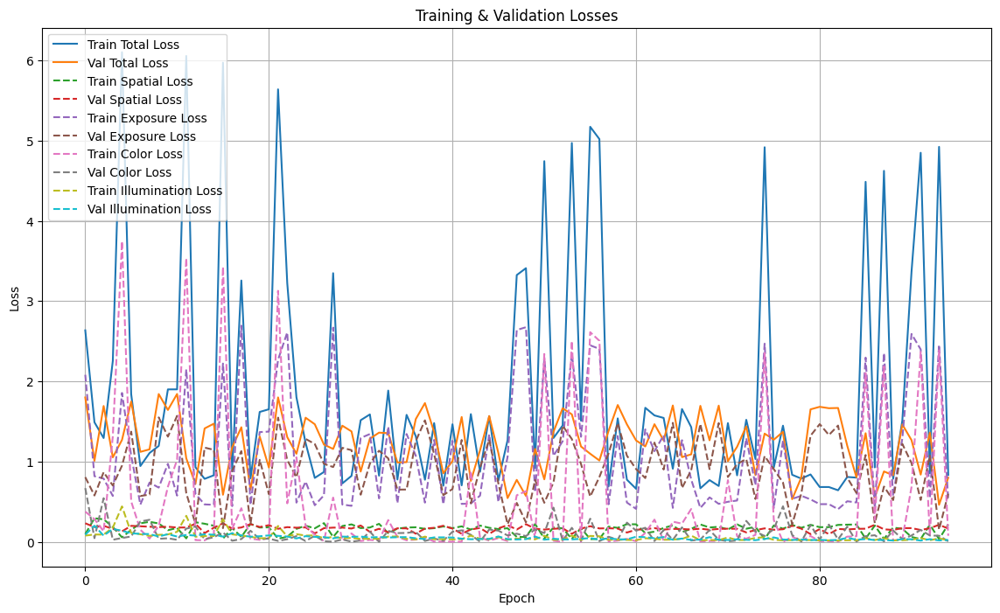

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 14
ETA: 3.21 min
Train Loss: 1.0211219787597656
  Spatial Consistency Loss: 0.19090652465820312
  Exposure Control Loss: 0.7109441757202148
  Color Constancy Loss: 0.07481987774372101
  Illumination Smoothness Loss: 0.04445143789052963
Validation Loss: 1.3762891292572021
  Spatial Consistency Loss: 0.15707091987133026
  Exposure Control Loss: 0.7384235262870789
  Color Constancy Loss: 0.45126035809516907
  Illumination Smoothness Loss: 0.029534319415688515



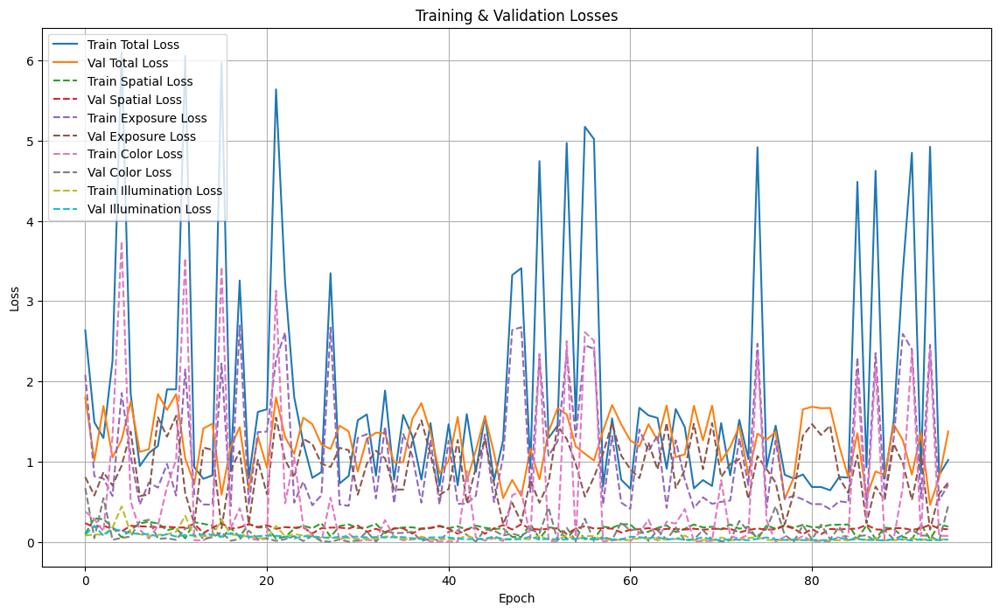

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.09steps/s]



Epoch: 15
ETA: 3.25 min
Train Loss: 1.5043336153030396
  Spatial Consistency Loss: 0.1703285276889801
  Exposure Control Loss: 1.2976500988006592
  Color Constancy Loss: 0.016027605161070824
  Illumination Smoothness Loss: 0.020327463746070862
Validation Loss: 1.4486894607543945
  Spatial Consistency Loss: 0.17010623216629028
  Exposure Control Loss: 1.2099013328552246
  Color Constancy Loss: 0.03538862615823746
  Illumination Smoothness Loss: 0.033293336629867554



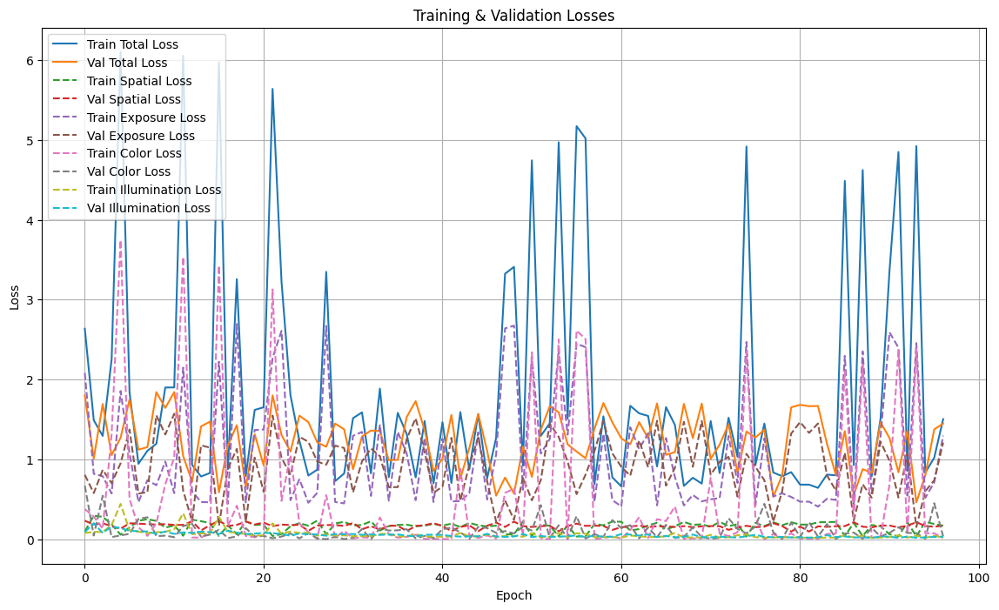

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.14steps/s]



Epoch: 16
ETA: 3.32 min
Train Loss: 5.022188663482666
  Spatial Consistency Loss: 0.033417195081710815
  Exposure Control Loss: 2.512916326522827
  Color Constancy Loss: 2.430771827697754
  Illumination Smoothness Loss: 0.04508356750011444
Validation Loss: 1.6700000762939453
  Spatial Consistency Loss: 0.16167540848255157
  Exposure Control Loss: 1.4477379322052002
  Color Constancy Loss: 0.03658323734998703
  Illumination Smoothness Loss: 0.02400355599820614



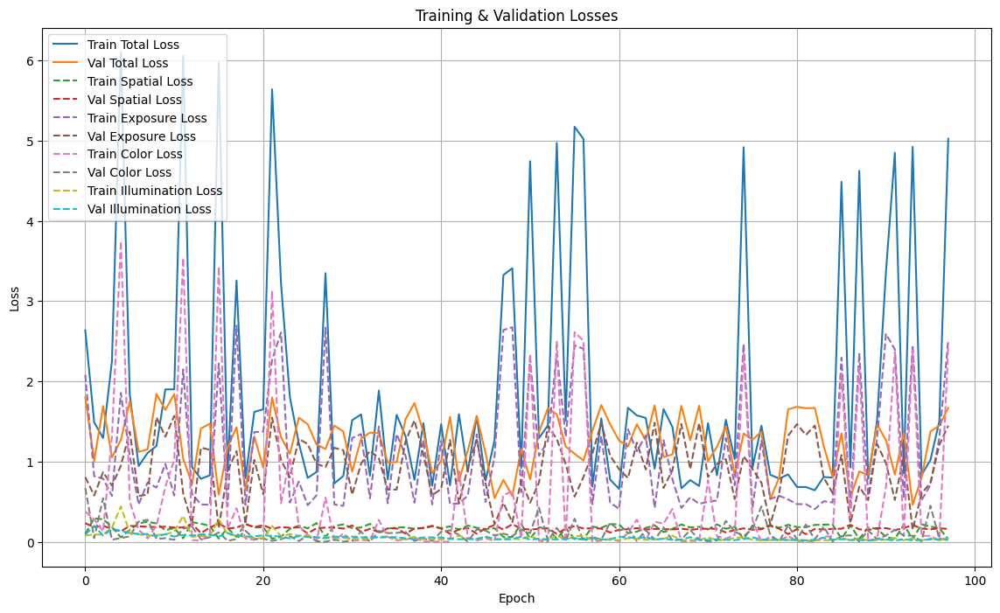

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.13steps/s]



Epoch: 17
ETA: 3.29 min
Train Loss: 0.7631203532218933
  Spatial Consistency Loss: 0.2180243879556656
  Exposure Control Loss: 0.4777466058731079
  Color Constancy Loss: 0.04819625988602638
  Illumination Smoothness Loss: 0.01915311999619007
Validation Loss: 1.6856210231781006
  Spatial Consistency Loss: 0.16023212671279907
  Exposure Control Loss: 1.4686542749404907
  Color Constancy Loss: 0.03318611904978752
  Illumination Smoothness Loss: 0.02354845404624939



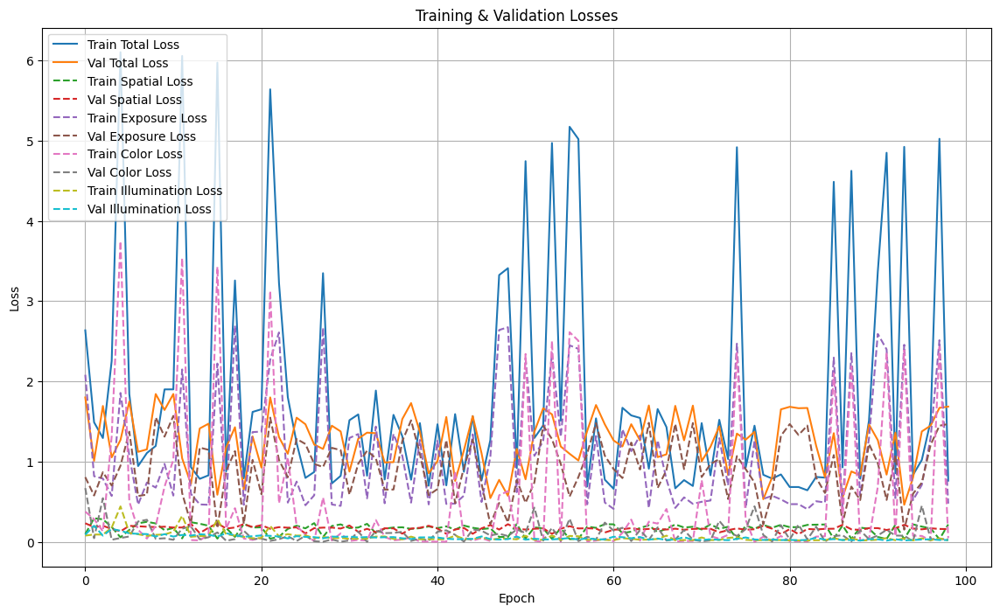

validating...: 100%|██████████| 6/6 [00:05<00:00,  1.12steps/s]



Epoch: 18
ETA: 3.27 min
Train Loss: 0.8482378721237183
  Spatial Consistency Loss: 0.21401289105415344
  Exposure Control Loss: 0.541435956954956
  Color Constancy Loss: 0.07346614450216293
  Illumination Smoothness Loss: 0.01932295225560665
Validation Loss: 0.458801805973053
  Spatial Consistency Loss: 0.21059472858905792
  Exposure Control Loss: 0.15096759796142578
  Color Constancy Loss: 0.07879182696342468
  Illumination Smoothness Loss: 0.018447676673531532



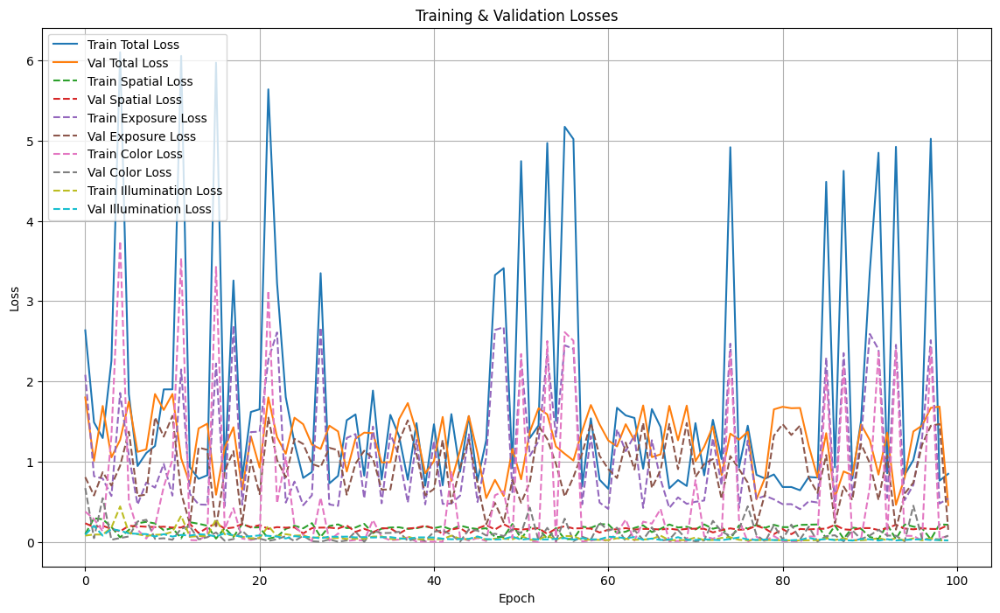

In [23]:
spatial_consistency_loss = SpatialConsistencyLoss()
exposure_control_loss = ExposureControlLoss(e=0.6, patch_size=16)
color_constancy_loss = ColorConstancyLosss()
illumination_smoothness_loss = IlluminationSmoothnessLoss()
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=1e-6)

model.compile(
        optimizer=optimizer,
        spatial_consistency_loss=spatial_consistency_loss,
        exposure_control_loss=exposure_control_loss,
        color_constancy_loss=color_constancy_loss,
        illumination_smoothness_loss=illumination_smoothness_loss
    )

print('Training the model...\n')
epoch = 18
for e in range(epoch):
    t = time.time()

    for img in tqdm(train_data, unit='steps', desc='training...', colour='red'):
        losses = model.train_step(img)

    for img in tqdm(val_data, unit='steps', desc='validating...', colour='green'):
        val_losses = model.test_step(img)

    # Log alle losses in de console
    print(f"\nEpoch: {e+1}")
    print(f"ETA: {round((time.time() - t)/60, 2)} min")
    print(f"Train Loss: {losses['total_loss']}")
    print(f"  Spatial Consistency Loss: {losses['spatial_consistency_loss']}")
    print(f"  Exposure Control Loss: {losses['exposure_control_loss']}")
    print(f"  Color Constancy Loss: {losses['color_constancy_loss']}")
    print(f"  Illumination Smoothness Loss: {losses['illumination_smoothness_loss']}")
    print(f"Validation Loss: {val_losses['total_loss']}")
    print(f"  Spatial Consistency Loss: {val_losses['spatial_consistency_loss']}")
    print(f"  Exposure Control Loss: {val_losses['exposure_control_loss']}")
    print(f"  Color Constancy Loss: {val_losses['color_constancy_loss']}")
    print(f"  Illumination Smoothness Loss: {val_losses['illumination_smoothness_loss']}\n")

    # Opslaan van losses in de geschiedenis
    history["train_total"].append(losses["total_loss"].numpy())
    history["train_spatial"].append(losses["spatial_consistency_loss"].numpy())
    history["train_exposure"].append(losses["exposure_control_loss"].numpy())
    history["train_color"].append(losses["color_constancy_loss"].numpy())
    history["train_illumination"].append(losses["illumination_smoothness_loss"].numpy())

    history["val_total"].append(val_losses["total_loss"].numpy())
    history["val_spatial"].append(val_losses["spatial_consistency_loss"].numpy())
    history["val_exposure"].append(val_losses["exposure_control_loss"].numpy())
    history["val_color"].append(val_losses["color_constancy_loss"].numpy())
    history["val_illumination"].append(val_losses["illumination_smoothness_loss"].numpy())

    # Plotten na elke epoch
    plot_losses(history)

    # Model opslaan elke 10 epochs
    if (e + 1) % 10 == 0:
        model_path = f'finetuned_models/zero_dce_finetune2/weights_epoch_{e+1}.h5'
        model.save_weights(model_path)
        print(f"Model saved.\n")



In [24]:
model_path = f'finetuned_models/zero_dce_finetune2/finetuned100epochs.h5'
model.save_weights(model_path)


#### Visualiseren moving averages

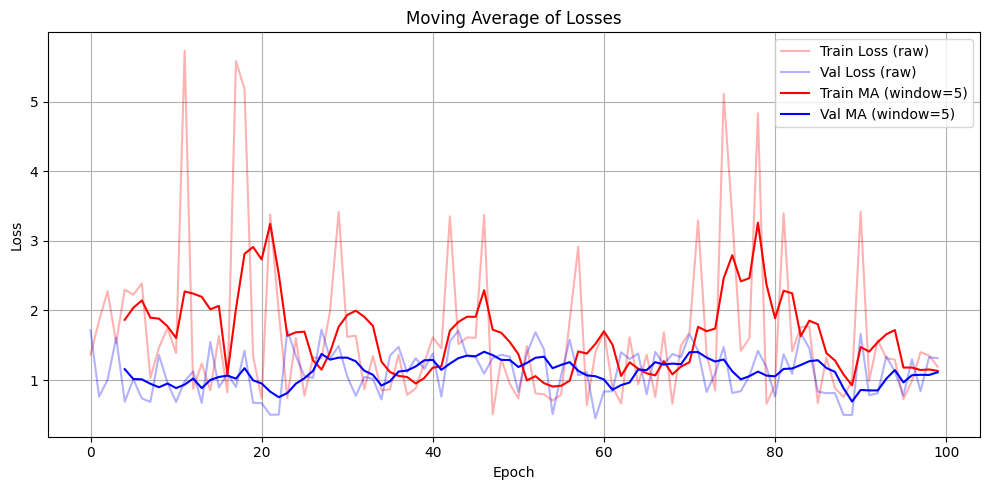

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def moving_average(data, window_size=10):
    """Bereken het voortschrijdend gemiddelde met een bepaald venster."""
    return np.convolve(data, np.ones(window_size)/window_size, mode='valid')

train_loss2 = np.array(history["train_total"])
val_loss2 = np.array(history["val_total"])

window_size = 5
train_avg = moving_average(train_loss2, window_size)
val_avg = moving_average(val_loss2, window_size)

plt.figure(figsize=(10, 5))
plt.plot(train_loss2, label='Train Loss (raw)', color='red', alpha=0.3)
plt.plot(val_loss2, label='Val Loss (raw)', color='blue', alpha=0.3)
plt.plot(range(window_size - 1, len(train_loss2)), train_avg, label=f'Train MA (window={window_size})', color='red')
plt.plot(range(window_size - 1, len(val_loss2)), val_avg, label=f'Val MA (window={window_size})', color='blue')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Moving Average of Losses')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
